In [ ]:
directory = '/home/ani/projects/pvae/results/new_models/vae_logp_models/zinc_prop_logp_196_4'

hist_df = pd.read_pickle(os.path.join(directory, 'tracker.pickle'))
hist_df['val_NLL_loss'][-1]

In [147]:
hist_df.keys()

dict_keys(['NLL_loss', 'KL_loss', 'ELBO', 'prop_pred_loss', 'val_NLL_loss', 'val_KL_loss', 'val_ELBO', 'val_prop_pred_loss'])

In [173]:
none_rec_loss = [0.14591785874893765, 0.14644380791422168, 0.15061682647459881, 0.14571141667055107, 0.1568819122436982]

np.mean(none_rec_loss), np.std(none_rec_loss)

(0.1491143644104015, 0.004278358689032895)

In [180]:
logp_rec_loss = [0.14343588311087513, 0.13912640254805672, 0.14984335468948637, 0.14836702110724478, 0.14902098454055826]
np.mean(logp_rec_loss), np.std(logp_rec_loss)

(0.14595872919924424, 0.004081985613475693)

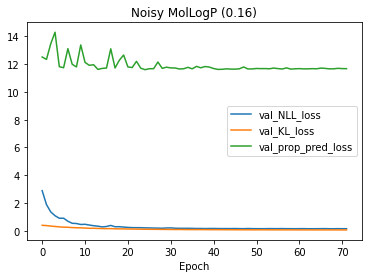

In [36]:
plt.title('Noisy MolLogP (0.16)')
plt.xlabel('Epoch')
plt.plot(np.arange(72), hist_df['val_NLL_loss'], label = 'val_NLL_loss')
plt.plot(np.arange(72), hist_df['val_KL_loss'], label = 'val_KL_loss')
plt.plot(np.arange(72), hist_df['val_prop_pred_loss'], label = 'val_prop_pred_loss')
plt.legend();

In [286]:
'''vocab_size = len(char2ind) 
Args.latent_size = 56
model = SentenceVAE(vocab_size, Args.embedding_size, Args.rnn_type, Args.hidden_size, Args.word_dropout, Args.latent_size,
                    sos_indx, eos_indx, pad_indx, max_sequence_length,Args.device_id,
                    num_layers=1, predict_prop = True, nr_prop = 1, bidirectional=False, gpu_exist = Args.gpu_exist)
model.load_state_dict(torch.load('/home/ani/projects/pvae/results/zinc250K/zinc_smiles_tpsa_56/E70.pytorch', map_location = 'cpu'))
model.cuda(Args.device_id)'''

'''directory = '/home/ani/projects/pvae/results/new_models/zinc_prop_NumAromaticRings_196'
param_file = os.path.join(directory, 'params.json')
Args = json.loads(open(param_file).read(), object_pairs_hook=OrderedDict)
'''
'''
vocab_size = len(char2ind) 
model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
                    sos_indx, eos_indx, pad_indx, max_sequence_length,Args['device_id'],
                    num_layers=1, nr_prop = Args['nr_classes'],bidirectional=False, gpu_exist = Args['gpu_exist'])
model.load_state_dict(torch.load(directory + '/E70.pytorch', map_location = 'cpu'))
model.cuda(Args['device_id'])'''
'''
vocab_size = len(char2ind) 
model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
                    sos_indx, eos_indx, pad_indx, max_sequence_length,Args['device_id'],
                    num_layers=1, predict_prop = True, nr_prop = Args['nr_prop'],bidirectional=False, gpu_exist = Args['gpu_exist'])
model.load_state_dict(torch.load(directory + '/E70.pytorch', map_location = 'cpu'))
model.cuda(Args['device_id'])'''

SentenceVAE(
  (embedding): Embedding(50, 30)
  (word_dropout): Dropout(p=0.1, inplace=False)
  (prediction): Linear(in_features=196, out_features=1, bias=True)
  (encoder_rnn): GRU(30, 1024, batch_first=True)
  (decoder_rnn): GRU(30, 1024, batch_first=True)
  (hidden2mean): Linear(in_features=1024, out_features=196, bias=True)
  (hidden2logv): Linear(in_features=1024, out_features=196, bias=True)
  (latent2hidden): Linear(in_features=196, out_features=1024, bias=True)
  (outputs2vocab): Linear(in_features=1024, out_features=50, bias=True)
)

In [2]:
from model_property2 import *
from data_prepration import *
from params import *
from multiprocessing import cpu_count
import numpy as np
import pickle
from util import *
import pickle 
import os
import pandas as pd
import torch.optim as optim
import torch.nn as nn
import json
from collections import OrderedDict
from tqdm import tqdm


# def load_model(directory, downstream_file = None):
#     param_file = os.path.join(directory, 'params.json')
#     print(f'Reading parameters from {param_file}')
#     Args = json.loads(open(param_file).read(), object_pairs_hook=OrderedDict)

#     print('############### data loading ######################')
#     #data_dir = 'data/'
#     #data_list = ['zinc250k/zinc_train_tpsa', 'zinc250k/zinc_test_tpsa']

#     if downstream_file:
#         train_path = Args['data_list'][0]
#         data_train, data_valid = text2dict_zinc([train_path, downstream_file])
#     else:
#         data_train, data_valid = text2dict_zinc(Args['data_list'])

#     print("Number of training SMILES >>>> " , len(data_train['SMILES']))
#     print("Number of validation SMILES >>>> " , len(data_valid['SMILES']))

#     # smiles preprocessing:
    
#     biology_flag = False
#     UB_smi = 120
#     print('postprocessing train...')
#     #txt,data_train_ = smi_postprocessing(data_train,biology_flag,LB_smi,UB_smi,LogP,MW)
#     txt,data_train_ = smi_postprocessing(data_train,biology_flag,UB_smi)

    
#     print('postprocessing valid...')
#     _,data_valid_ = smi_postprocessing(data_valid,biology_flag,UB_smi)
#     #_,data_test_ = smi_postprocessing(data_test,biology_flag,LB_smi,UB_smi,LogP,MW)
#     data_type = 'smiles_properties'
#     print('dictionary building...')
#     char2ind,ind2char,sos_indx,eos_indx,pad_indx = dictionary_build(txt)
#     #max_sequence_length = np.max(np.asarray([len(smi) for smi in data_train_['SMILES']]))
#     max_sequence_length = UB_smi

#     # here we create the dataset which we would like to sample from to generate novel molecules
#     # as an example we use samples here from the validation set.
#     print('dataset building...')
# #     Args.batch_size = 1 # as we need to work on a single sample in this case we need to set batch size to 1. 
#     dataset_valid = dataset_building(char2ind,data_valid_,max_sequence_length,data_type)
#     dataloader_valid = DataLoader(dataset=dataset_valid, batch_size= 1, shuffle = False)
    
#     vocab_size = len(char2ind)
    
#     if 'predict_prop' in Args:
#         print('Property predicting model: ', Args['predict_prop'])
#         print('properties: ', Args['properties'])
#         print(Args)
#         model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
#                             sos_indx, eos_indx, pad_indx, max_sequence_length, Args['device_id'],
#                             num_layers=1, predict_prop = Args['predict_prop'], nr_prop = Args['nr_prop'], bidirectional=False, gpu_exist = Args['gpu_exist'])
        
#     else:
#         print('Property predicting model: False')
#         print(Args)
#         model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
#                             sos_indx, eos_indx, pad_indx, max_sequence_length, Args['device_id'],
#                             num_layers=1, nr_prop = Args['nr_classes'], bidirectional=False, gpu_exist = Args['gpu_exist'])

#     print(len(dataloader_valid))
        
#     print('Loading data from: ', directory + '/E70.pytorch')
#     model.load_state_dict(torch.load(directory + '/E70.pytorch', map_location = 'cpu'))
#     model.cuda(Args['device_id'])
    
#     return dataloader_valid, dataset_valid, Args, model

None


In [24]:
dataloader_valid, dataset_valid, Args, model = load_model('/home/ani/projects/pvae/results/new_models/zinc_prop_logp_196')

Reading parameters from /home/ani/projects/pvae/results/new_models/zinc_prop_logp_196/params.json
############### data loading ######################
/home/ani/projects/pvae/data/zinc250k/zinc_250k_train.csv
/home/ani/projects/pvae/data/zinc250k/zinc_250k_test.csv
Train: 224507
Test: 24948
Number of training SMILES >>>>  224507
Number of validation SMILES >>>>  24948
postprocessing train...
postprocessing valid...
dictionary building...
total chars: 49
dataset building...
Property predicting model:  True
properties:  ['MolLogP']
OrderedDict([('data_list', ['/home/ani/projects/pvae/data/zinc250k/zinc_250k_train.csv', '/home/ani/projects/pvae/data/zinc250k/zinc_250k_test.csv']), ('gpu_exist', True), ('device_id', 0), ('batch_size', 30), ('hidden_size', 1024), ('embedding_size', 30), ('bidirectional', False), ('epochs', 72), ('nr_classes', 4), ('predict_prop', True), ('nr_prop', 1), ('properties', ['MolLogP']), ('rnn_type', 'gru'), ('learning_rate', 0.001), ('latent_size', 196), ('n_layer

In [26]:
params = {}

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES_org'])):
    _, mean, logv, _, _ = model(to_var(data['input'], Args['device_id'],gpu_exist = Args['gpu_exist']),
                                      to_var(data['length'],Args['device_id'],gpu_exist = Args['gpu_exist']))
    params[smiles] = [mean.tolist(), logv.tolist()]

24947it [01:40, 247.12it/s]


In [20]:
test_df_orig = pd.read_csv('/home/ani/projects/zinc_test_embeddings_logp_tpsa_none.csv')
# test_df_orig = test_df_orig[['smiles', 'MolLogP', 'TPSA', 'TPSA_scaled']]
test_df_orig['smiles'] = test_df_orig.smiles.apply(lambda smi: Chem.MolToSmiles(Chem.MolFromSmiles(smi.strip())))
test_df_orig.shape
print(len(set(test_df_orig.smiles.values).intersection(set(params.keys()))))
test_df_orig = test_df_orig[test_df_orig.smiles.isin(set(params.keys()))]

24947


In [27]:
# test_df['embeddings_logp'] = test_df.smiles.apply(lambda smi: embeddings[smi])
# test_df['embeddings_tpsa'] = test_df.smiles.apply(lambda smi: embeddings[smi])
# test_df['embeddings_none'] = test_df.smiles.apply(lambda smi: embeddings[smi])
# test_df_orig['hidden_mean_none'] = test_df_orig.smiles.apply(lambda smi: params[smi][0])
# test_df_orig['hidden_logv_none'] = test_df_orig.smiles.apply(lambda smi: params[smi][1])
test_df_orig['hidden_mean_logp'] = test_df_orig.smiles.apply(lambda smi: params[smi][0])
test_df_orig['hidden_logv_logp'] = test_df_orig.smiles.apply(lambda smi: params[smi][1])

In [29]:
test_df_orig.to_csv('/home/ani/projects/zinc_test_embeddings_logp_tpsa_none.csv', index = False)
# test_df_orig.to_csv('/home/ani/projects/final_logS_new_pvae_no_prop_196_6668.csv', index = False)
# test_df_orig.to_csv('/home/ani/projects/final_logS_new_pvae_logp_196_6668.csv', index = False)

In [31]:
logs = pd.read_csv('/home/ani/projects/final_logS_new_pvae_logp_196_6668.csv')
logs_pred = pd.read_csv('/home/ani/projects/logs_logp_predictions.csv')

In [40]:
len(set(logs_pred.InchiKey).intersection(set(logs.InchiKey)))

6668

In [41]:
len(set(logs_pred.InchiKey))

6668

In [126]:
pred_dict = {}

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES_org'])):
    logp, mu, logv, z, pred = model(to_var(data['input'], Args['device_id'],gpu_exist = Args['gpu_exist']),
                                          to_var(data['length'],Args['device_id'],gpu_exist = Args['gpu_exist']))
    pred_dict[smiles] = pred.tolist()

24947it [01:39, 249.65it/s]


In [127]:
# test_df['pred_tpsa_by_tpsa'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])
test_df['pred_tpsa_by_tpsa_1'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])

# test_df['pred_logp_by_logp'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])
# test_df['pred_logp_by_logp_1'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])

# test_df['pred_logp_by_logp_vsa6'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])
# test_df['pred_logp_by_logp_vsa6_1'] = test_df.smiles.apply(lambda smi: pred_dict0.get(smi, np.nan)[0][0])

# test_df['pred_logp_by_logp_aromrings'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])
# test_df['pred_logp_by_logp_aromrings_1'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])
# test_df['pred_logp_by_logp_aromrings_ringcount'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])
# test_df['pred_logp_by_logp_aromrings_ringcount_1'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][0])

# test_df['pred_vsa6_by_logp_vsa6'] = test_df.smiles.apply(lambda smi: pred_dict.get(smi, np.nan)[0][1])
# test_df['pred_vsa6_by_logp_vsa6_1'] = test_df.smiles.apply(lambda smi: pred_dict0.get(smi, np.nan)[0][1])

# test_df['pred_logp_by_logp_vsa6_mw'] = test_df.smiles.apply(lambda smi: pred_dict3.get(smi, np.nan)[0][0])
# test_df['pred_logp_by_logp_vsa6_mw_1'] = test_df.smiles.apply(lambda smi: pred_dict0.get(smi, np.nan)[0][0])
# test_df['pred_vsa6_by_logp_vsa6_mw'] = test_df.smiles.apply(lambda smi: pred_dict3.get(smi, np.nan)[0][1])
# test_df['pred_vsa6_by_logp_vsa6_mw_1'] = test_df.smiles.apply(lambda smi: pred_dict0.get(smi, np.nan)[0][1])
# test_df['pred_mw_by_logp_vsa6_mw'] = test_df.smiles.apply(lambda smi: pred_dict3.get(smi, np.nan)[0][2])

In [37]:
from sklearn.metrics import mean_squared_error

In [99]:
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp'], squared = False)
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_1'], squared = False)

0.28934886628548967

In [199]:
# np.std([0.286, 0.287, 0.288, 0.286, 0.288])

0.0008944271909999167

In [115]:
# np.mean([0.2872497623756619, 0.2870298107663173, 0.2879842137489344, 0.28719542385186814, 0.28934886628548967])

0.28776161540565426

In [128]:
# mean_squared_error(y_true = test_df['TPSA_scaled'], y_pred = test_df['pred_tpsa_by_tpsa'], squared = False)
mean_squared_error(y_true = test_df['TPSA_scaled'], y_pred = test_df['pred_tpsa_by_tpsa_1'], squared = False)

0.19793308345076588

In [130]:
np.std([0.19755432430970324, 0.19596733046615722, 0.1968763759696695, 0.19639755832338868, 0.19793308345076588])

0.0007221941133555087

In [215]:
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_vsa6'], squared = False)
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_vsa6_1'], squared = False)

0.2911712764580157

In [216]:
# np.mean([0.288, 0.2899639833179325, 0.2899634551474304, 0.2894673792075328, 0.2911712764580157])

0.2897132188261823

In [217]:
# np.std([0.288, 0.2899639833179325, 0.2899634551474304, 0.2894673792075328, 0.2911712764580157])

0.0010244011879166717

In [233]:
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_vsa6_mw'], squared = False)
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_vsa6_mw_1'], squared = False)

0.2901885102513932

In [235]:
# np.std([0.2900431706192769, 0.2907035789042421, 0.2891551815781759, 0.28918683483477864, 0.2901885102513932])

0.0006004852873803931

In [75]:
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_aromrings'], squared = False)
mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_aromrings_1'], squared = False)

0.2837510685592765

In [76]:
np.mean([0.2849579943137326, 0.28462515450351394, 0.2848683060761857, 0.2863277156446981, 0.2837510685592765])

0.28490604781948137

In [77]:
np.std([0.2849579943137326, 0.28462515450351394, 0.2848683060761857, 0.2863277156446981, 0.2837510685592765])

0.0008292334326553689

In [58]:
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_aromrings_ringcount'], squared = False)
# mean_squared_error(y_true = test_df['MolLogP'], y_pred = test_df['pred_logp_by_logp_aromrings_ringcount_1'], squared = False)

0.2836084373669344

In [61]:
# print(np.mean([0.2855627320853458, 0.28574739728112236, 0.28562972289540306, 0.2851123393570659, 0.2836084373669344]))
# np.std([0.2855627320853458, 0.28574739728112236, 0.28562972289540306, 0.2851123393570659, 0.2836084373669344])

0.2851321257971743


0.0007916566910217117

0.0007916566910217117

In [269]:
# mean_squared_error(y_true = test_df['PEOE_VSA6_scaled'], y_pred = test_df['pred_vsa6_by_logp_vsa6'], squared = False)
# mean_squared_error(y_true = test_df['PEOE_VSA6_scaled'], y_pred = test_df['pred_vsa6_by_logp_vsa6_1'], squared = False)

0.38850858514904174

In [271]:
# np.std([0.3879999177503179, 0.3887630639933764, 0.3895546292074141, 0.38762536089195204, 0.38850858514904174])

0.000662740615217955

In [252]:
# mean_squared_error(y_true = test_df['PEOE_VSA6_scaled'], y_pred = test_df['pred_vsa6_by_logp_vsa6_mw'], squared = False)
# mean_squared_error(y_true = test_df['PEOE_VSA6_scaled'], y_pred = test_df['pred_vsa6_by_logp_vsa6_mw_1'], squared = False)

0.38869269638942416

In [254]:
# np.std([0.38810949789304106, 0.38919671699664193, 0.3901997168334045, 0.38851551493478437, 0.38869269638942416])

0.0007188644528182387

In [145]:
mean_squared_error(y_true = test_df['MolWt_scaled'], y_pred = test_df['pred_mw_by_logp_vsa6_mw'], squared = False)

0.16212735690128988

In [312]:
a = np.array([1, 0, 1, 1, 1, 0, 0, 0])
b = np.array([1, 1, 0, 1, 1, 0, 1, 0])

def tanimoto_coefficient(fgp1, fgp2):
    fgp1 = np.array(fgp1)
    fgp2 = np.array(fgp2)
    
    both = np.sum(fgp1 & fgp2)

    return both / (np.sum(fgp1) + np.sum(fgp2) - both)


tanimoto_coefficient(a, b)

0.5

In [320]:
smiles1 = 'CCCCC'
smiles2 = 'CN1C=NC2=C1C(=O)N(C(=O)N2C)C'

fgp1 = Chem.RDKFingerprint(Chem.MolFromSmiles(smiles1))
fgp2 = Chem.RDKFingerprint(Chem.MolFromSmiles(smiles2))

In [321]:
tanimoto_coefficient(list(fgp1), list(fgp2))

0.00261437908496732

In [322]:
from rdkit import DataStructs
DataStructs.FingerprintSimilarity(fgp1, fgp2)

0.00261437908496732

In [33]:
directory = './results/new_models/zinc25k_196/'
param_file = os.path.join(directory, 'params.json')
model_path = os.path.join(directory, 'E70.pytorch')

print(f'Reading parameters from {param_file}')
Args = json.loads(open(param_file).read(), object_pairs_hook=OrderedDict)
train_path = Args['data_list'][0]
data_train, data_valid = text2dict_zinc([train_path, '/home/shared/final_project/data/logS/processed/final_logS_6789.csv'])
print("Number of training SMILES >>>> " , len(data_train['SMILES']))
print("Number of input SMILES >>>> " , len(data_valid['SMILES']))

biology_flag = False
UB_smi = 120
print('postprocessing train...')
txt,data_train_ = smi_postprocessing(data_train, biology_flag, UB_smi)
print('dictionary building...')
char2ind,ind2char,sos_indx,eos_indx,pad_indx = dictionary_build(txt)

print('postprocessing input...')
_,data_valid_ = smi_postprocessing(data_valid, biology_flag, UB_smi, char2ind)
print(len(data_valid_['SMILES']))


data_type = 'pure_smiles'
max_sequence_length = UB_smi

print('dataset building...')
Args.batch_size = 1 # as we need to work on a single sample in this case we need to set batch size to 1. 
dataset_valid = dataset_building(char2ind,data_valid_,max_sequence_length,data_type)
dataloader_valid = DataLoader(dataset=dataset_valid, batch_size= Args.batch_size, shuffle = False)


print('Loading model: ', model_path)
vocab_size = len(char2ind) 
if 'predict_prop' in Args:
    print('Property predicting model: ', Args['predict_prop'])
    model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
                        sos_indx, eos_indx, pad_indx, max_sequence_length, Args['device_id'],
                        num_layers=1, predict_prop = Args['predict_prop'], nr_prop = Args['nr_prop'], bidirectional=False, gpu_exist = Args['gpu_exist'])
    model.load_state_dict(torch.load(model_path, map_location = 'cpu'))
    model.cuda(Args['device_id'])
else:
    print('Property predicting model: False')
    model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
                        sos_indx, eos_indx, pad_indx, max_sequence_length, Args['device_id'],
                        num_layers=1, nr_prop = Args['nr_classes'], bidirectional=False, gpu_exist = Args['gpu_exist'])
    model.load_state_dict(torch.load(model_path, map_location = 'cpu'))
    model.cuda(Args['device_id'])
    
print(len(dataloader_valid))

Reading parameters from ./results/new_models/zinc25k_196/params.json
/home/ani/projects/pvae/data/zinc25k/zinc_25k_train.csv
/home/shared/final_project/data/logS/processed/final_logS_6789.csv
Train: 22500
Test: 6789
Number of training SMILES >>>>  22500
Number of input SMILES >>>>  6789
postprocessing train...
dictionary building...
total chars: 45
postprocessing input...
'k'
Skipping  GCCOk(=S)(CC)Oc1cc(L)c(L)cc1LE
'h'
Skipping  GCh1(C)CCCCC2(C1)C(=O)NC(=O)NC2=OE
'k'
Skipping  GCc1ccc(Ok(=O)(Oc2cccc(C)c2)Oc2ccccc2C)cc1E
'k'
Skipping  GCCOk(=S)(NC(C)C)Oc1ccccc1C(=O)OC(C)CE
'h'
Skipping  Gc1ccc(h23OCCN(CCO2)CCO3)cc1E
'k'
Skipping  GCc1cc(O)ccc1Ok(=O)(Oc1cc(O)ccc1C)Oc1c(C)cccc1OE
'h'
Skipping  GLCh12OCCN(CCO1)CCO2E
'8'
Skipping  GCN1C(=O)X23Cx4(x56CX78SSX(CO)(C(=O)N7y5Nc5ccccc56)N(C)C8=O)c5ccccc5NY4N2C(=O)x1(CO)SS3E
'h'
Skipping  GCCC1CCh(C)(C)CC12C(=O)NC(=O)NC2=OE
'h'
Skipping  GCh1(C)CCCC2(C1)C(=O)NC(=S)NC2=OE
'h'
Skipping  GCh1(C)CCCC2(C1)C(=O)NC(=O)NC2=OE
6663
dataset building...
Loa

In [14]:
# zinc_196
count_parameters(model)

7145130

In [17]:
# zinc_prop_logp_196
count_parameters(model)

7144539

In [ ]:
'''from tqdm import tqdm
#pred_list = []
correct_count = 0
iteration = 0

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES'])):
   
    logp, mu, logv, z, _ = model(to_var(data['input'], Args.device_id,gpu_exist = Args.gpu_exist),
                                          to_var(data['length'],Args.device_id,gpu_exist = Args.gpu_exist))
    
    #pred_list.append(prediction)
    
    for i in range(10): # number of sampling from latent space, you may want to increase to an arbitary number
        Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args.latent_size]), std=0.01*torch.ones([1,  Args.latent_size])),
                                                 Args.device_id,gpu_exist=True)
        z_new = z+Rand_sample
        reconst = model.inference(z_new.cuda(Args.device_id))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        #print(decode(smiles[1: -1]), reconst)
        try:
            if reconst == decode(smiles[1: -1]):
                correct_count += 1
                break
        except:
            continue
            
    iteration += 1
    if iteration == 100:
        break
        
print(correct_count)'''

from tqdm import tqdm
pred_list = []
correct_count = 0
iteration = 0

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES'])):
    #print(decode(smiles[1: -1]))
    #print('---------------')
    for i in range(10):
        logp, mu, logv, z = model(to_var(data['input'], Args['device_id'],gpu_exist = Args['gpu_exist']),
                                              to_var(data['length'],Args['device_id'],gpu_exist = Args['gpu_exist']))
        reconst = model.inference(z.cuda(Args['device_id']))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode_1(''.join(reconst))[0:-1]
        
        #print(reconst)
        try:
            if reconst == decode_1(smiles[1: -1]):
                correct_count += 1
                break
        except:
            continue
            
    iteration += 1
    if iteration == 1000:
        break
        
print(correct_count)

975it [02:50,  9.34it/s]

In [9]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

#### Molecule generation

In [146]:
from tqdm import tqdm
gen_dict = {}
iteration = 0

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES'])):
    count = 0 
    
    logp, mu, logv, z, prediction = model(to_var(data['input'], Args['device_id'],gpu_exist = Args['gpu_exist']),
                                          to_var(data['length'],Args['device_id'],gpu_exist = Args['gpu_exist']))
    i = 5
    preds_for_generated = []
    generated_smiles = []
    generated_embeddings = []
    while(i > 0): # number of sampling from latent space, you may want to increase to an arbitary number
        Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args['latent_size']]), std=0.01*torch.ones([1,  Args['latent_size']])),
                                                 Args['device_id'],gpu_exist=True)
        z_new = z+Rand_sample
        reconst = model.inference(z_new.cuda(Args['device_id']))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode_1(''.join(reconst))[0:-1]
        mol = Chem.MolFromSmiles(reconst)
        if mol and (reconst != decode_1(smiles[1:-1])) and (not reconst in generated_smiles):
            pred = model.prediction(z_new)
            preds_for_generated.append(pred.item())
            generated_smiles.append(reconst)
            generated_embeddings.append(z_new[0].cpu().detach().numpy())
            i -= 1
    print(smiles[1:-1])
    print(decode_1(smiles[1:-1]))
    gen_dict[decode_1(smiles[1:-1])] = (z[0].cpu().detach().numpy(), generated_smiles, preds_for_generated, generated_embeddings)
    
    iteration += 1
    if iteration == 10:
        break

0it [00:00, ?it/s]

CNc1nc(y2CCCCN2CC(=O)N(C)C2CCCCC2)rc2c1CCN(C(C)=O)C2
CNc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C2


RDKit ERROR: [14:26:50] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 10 11 13
RDKit ERROR: 
[14:26:50] Can't kekulize mol.  Unkekulized atoms: 3 4 5 6 7 8 10 11 13

2it [00:01,  1.11it/s]

CN(Cc1nc2ccccc2o1)c1ccc(f(=O)g)cc1
CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cc1


3it [00:03,  1.42s/it]

COc1ccc(-c2ccnc3nc(NC4CCCCC4)Ac(=O)c23)cc1OC
COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC


4it [00:07,  2.24s/it]

Cc1ccncc1NC(=O)Ny(C)c1nc(-c2cccc(F)c2)no1
Cc1ccncc1NC(=O)N[C@H](C)c1nc(-c2cccc(F)c2)no1


RDKit ERROR: [14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22
RDKit ERROR: 
[14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22

RDKit ERROR: [14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22
RDKit ERROR: 
[14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22

RDKit ERROR: [14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22
RDKit ERROR: 
[14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22

RDKit ERROR: [14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22
[14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22

RDKit ERROR: 
RDKit ERROR: [14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22
[14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22

RDKit ERROR: 
RDKit ERROR: [14:26:57] Can't kekulize mol.  Unkekulized atoms: 1 2 3 17 18 19 20 21 22
RDKit ERROR: 
[14:26:5

Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12


6it [00:12,  2.27s/it]

CN(CCc1ccccn1)C(=O)NCY1CC=CCC1
CN(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC1


7it [00:12,  1.74s/it]

eCC1CCC(C(=O)Nc2ccc(C(=O)g)cc2R)CC1
[NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2Br)CC1


8it [00:13,  1.47s/it]

CY1CCN(C(=O)C2CC=CC2)CY1O
C[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1O


RDKit ERROR: [14:27:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5
RDKit ERROR: 
[14:27:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5

RDKit ERROR: [14:27:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[14:27:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5

RDKit ERROR: 
RDKit ERROR: [14:27:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5
[14:27:03] Can't kekulize mol.  Unkekulized atoms: 2 3 5

RDKit ERROR: 
9it [00:14,  1.35s/it]

CCn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc1
CCn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc1


9it [00:16,  1.83s/it]

COc1ccc(C2=CY(C(=O)N3CCCY(C)C3)N=N2)cc1
COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1


In [147]:
test_df = pd.read_csv('/home/ani/projects/pvae/data/zinc250k/zinc_250k_test.csv')
test_df = test_df[['smiles', 'NumAromaticRings']]
test_df['smiles'] = test_df['smiles'].apply(lambda smi: Chem.MolToSmiles(Chem.MolFromSmiles(smi.strip())))

In [148]:
test_df = test_df[test_df.smiles.isin(gen_dict.keys())]

In [149]:
test_df['embedding'] = [i[0] for i in gen_dict.values()]
test_df['generated_smiles'] = [i[1] for i in gen_dict.values()]

test_df['generated_prop'] = [i[2] for i in gen_dict.values()]
test_df['mean_generated_prop'] = test_df['generated_prop'].apply(np.mean)
test_df['generated_prop'] = test_df['generated_prop'].apply(lambda x: np.round(x, 5))

test_df['generated_embeddings'] = [i[3] for i in gen_dict.values()]

In [124]:
#test_df[['smiles', 'generated_smiles', 'MolLogP', 'generated_logp', 'mean_generated_logp']].to_csv('/home/ani/projects/pvae/generated_molecules_pvae_logp.csv', index = False)

In [114]:
#test_df[['smiles', 'generated_smiles', 'PEOE_VSA6_scaled', 'generated_vsa6', 'mean_generated_vsa6']].to_csv('/home/ani/projects/pvae/generated_molecules_pvae_vsa6.csv', index = False)

In [150]:
print(test_df.iloc[1].smiles)

test_df.iloc[1].generated_smiles

CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cc1


['CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])c[nH+]1',
 'CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cn1',
 'CCN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cc1',
 'CN(Cc1nc2ccccc2o1)c1ccc(-n2cc[nH+]c2)cc1',
 'CN(Cc1nc2ccccc2o1)c1ccc(-c2ccc[S-]2)cc1']

#### Original

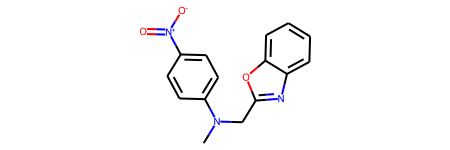

In [99]:
Chem.MolFromSmiles('CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cc1')

#### Generated

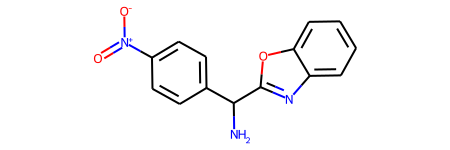

In [127]:
Chem.MolFromSmiles('NC(c1nc2ccccc2o1)c1ccc([N+](=O)[O-])cc1')

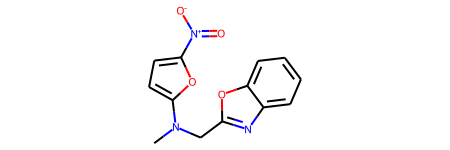

In [128]:
Chem.MolFromSmiles('CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])o1')

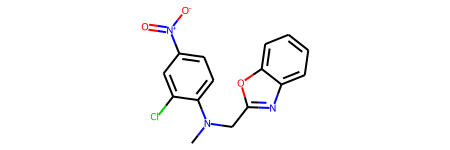

In [129]:
Chem.MolFromSmiles('CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cc1Cl')

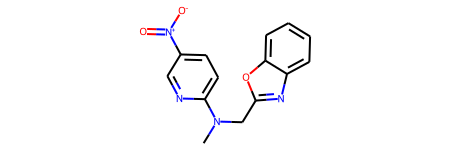

In [130]:
Chem.MolFromSmiles('CN(Cc1nc2ccccc2o1)c1ccc([N+](=O)[O-])cn1')

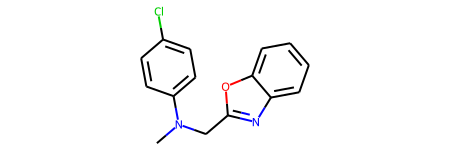

In [131]:
Chem.MolFromSmiles('CN(Cc1nc2ccccc2o1)c1ccc(Cl)cc1')

In [281]:
from sklearn.decomposition import PCA

In [152]:
example = test_df.iloc[0]
pca = PCA(n_components=2)

embeddings = np.array([example.embedding] + example.generated_embeddings)
embeddings_2d = pca.fit_transform(embeddings)

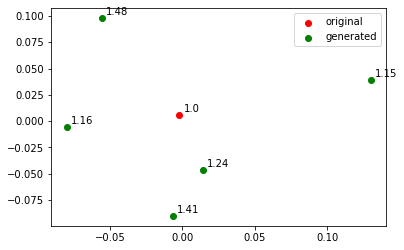

In [153]:
center = embeddings_2d[0]
neighbors = embeddings_2d[1:]
plt.scatter(center[0], center[1], c = 'r', label = 'original')
plt.annotate(str(np.round(example.NumAromaticRings, 2)), (center[0]+0.003, center[1]+0.003))

plt.scatter(neighbors[:, 0], neighbors[:, 1], c = 'g', label = 'generated')
for point, prop in zip(neighbors, example.generated_prop):
    plt.annotate(str(np.round(prop, 2)), (point[0]+0.003, point[1]+0.003))

plt.legend();

In [154]:
examples = test_df.iloc[[0, 2, 6]].reset_index(drop = True)
pca = PCA(n_components=2)

embeddings = []
for _, i in test_df.iterrows():
    embeddings.extend([i.embedding] + i.generated_embeddings)

embeddings_2d = pca.fit_transform(embeddings)

In [155]:
len(embeddings)

60

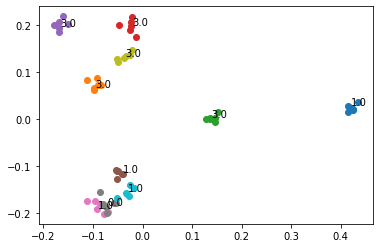

In [156]:
for i, example in test_df.iterrows():
    embeddings_2d_subset = embeddings_2d[i*6:i*6 + 6]
    center = embeddings_2d_subset[0]
    neighbors = embeddings_2d_subset[1:]
    plt.annotate(str(np.round(example.NumAromaticRings, 2)), (center[0]+0.003, center[1]+0.003))

    plt.scatter(embeddings_2d_subset[:, 0], embeddings_2d_subset[:, 1])

In [287]:
test_embeddings = []

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES'])):
    count = 0 
    
    logp, mu, logv, z, _ = model(to_var(data['input'], Args['device_id'],gpu_exist = Args['gpu_exist']),
                                          to_var(data['length'],Args['device_id'],gpu_exist = Args['gpu_exist']))
    test_embeddings.append(z.tolist()[0])

24947it [01:40, 248.18it/s]


In [276]:
test_df = pd.read_csv('/home/ani/projects/pvae/data/zinc250k/zinc_250k_test.csv')
test_df = test_df[['smiles', 'MolLogP']]
test_df['smiles'] = test_df['smiles'].apply(lambda smi: Chem.MolToSmiles(Chem.MolFromSmiles(smi.strip())))

In [279]:
test_df = test_df[test_df.smiles.isin(dataset_valid.data['SMILES_org'])]
test_df.shape

(24947, 2)

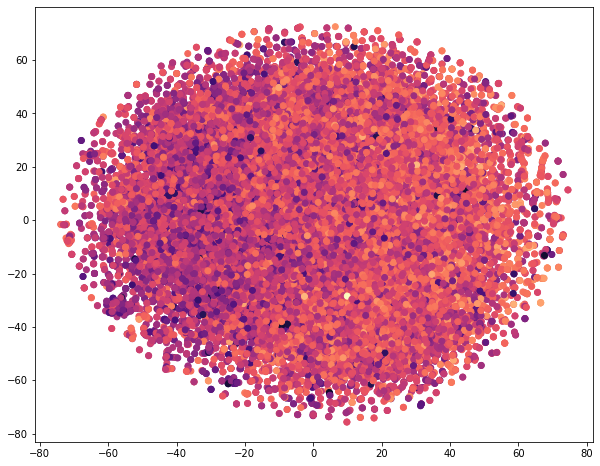

In [284]:
from sklearn.manifold import TSNE

# pca = PCA(n_components=2)
tsne = TSNE(n_components=2)
test_embeddings_2d = tsne.fit_transform(test_embeddings)

plt.figure(figsize = (10, 8))
plt.scatter(test_embeddings_2d[:, 0], test_embeddings_2d[:, 1], c = test_df.MolLogP, cmap='magma')
#plt.gray()
plt.show()

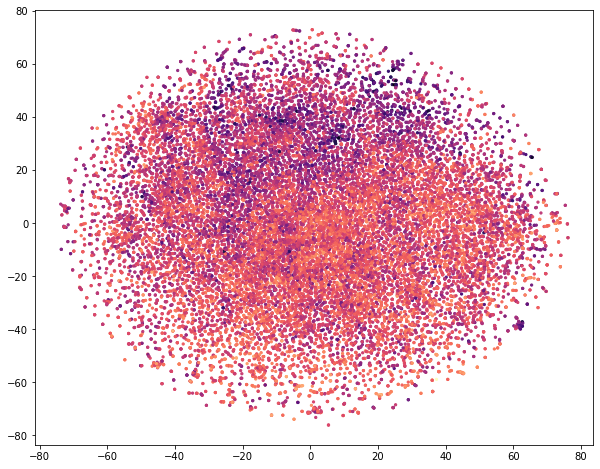

In [290]:
# tsne = TSNE(n_components=2)
# test_embeddings_2d = tsne.fit_transform(test_embeddings)

plt.figure(figsize = (10, 8))
plt.scatter(test_embeddings_2d[:, 0], test_embeddings_2d[:, 1], s = 5, c = test_df.MolLogP, cmap='magma')
#plt.gray()
plt.show()

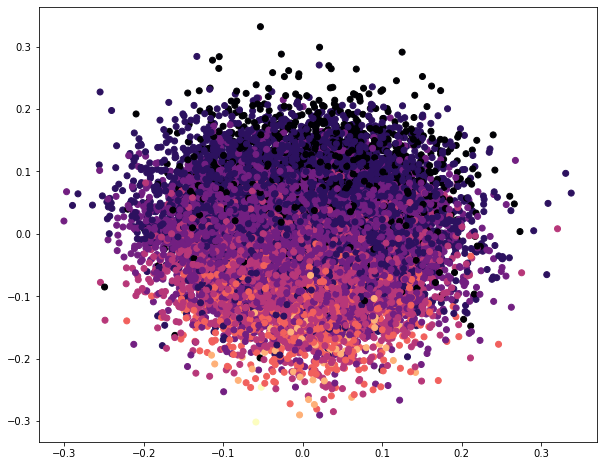

In [160]:
test_df = test_df[test_df.smiles.isin(dataset_valid.data['SMILES_org'])]

test_embeddings_2d = pca.fit_transform(test_embeddings)

plt.figure(figsize = (10, 8))
plt.scatter(test_embeddings_2d[:, 0], test_embeddings_2d[:, 1], c = test_df.NumAromaticRings, cmap='magma')
#plt.gray()
plt.show()

In [22]:
noise_57 = pd.read_csv('/home/ani/projects/final_project/data/logS/processed_with_pvae/small/final_logS_pvae_logp_noised_57_196_2906.csv')
none = pd.read_csv('/home/ani/projects/final_project/data/logS/processed_with_pvae/small/final_logS_new_pvae_no_prop_196_2906.csv')

In [27]:
len(set(noise_57.InchiKey).intersection(set(none.InchiKey)))

2906

In [28]:
logp = pd.read_csv('/home/ani/projects/final_project/data/logS/processed_with_pvae/final_logS_new_pvae_logp_196_6668.csv')

In [30]:
logp[logp.InchiKey.isin(noise_57.InchiKey)].to_csv('/home/ani/projects/final_project/data/logS/processed_with_pvae/small/final_logS_new_pvae_logp_196_2906.csv')

In [54]:
# VALIDITY
from tqdm import tqdm
valid_count = 0
valid_smiles = []

for i in tqdm(range(100)):
    #z_new = torch.tensor([[np.random.normal() for _ in range(196)]])
    Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args['latent_size']]), std=torch.ones([1,  Args['latent_size']])),
                                                 Args['device_id'],gpu_exist=True)
    z_new = Rand_sample
    for i in range(100): # number of sampling from latent space, you may want to increase to an arbitary number
        reconst = model.inference(z_new.cuda(Args['device_id']))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        m = Chem.MolFromSmiles(reconst)
        if not m is None:
            valid_smiles.append(reconst)
            valid_count += 1
            break
print(valid_count)

  0%|                                                                                           | 0/100 [00:00<?, ?it/s]RDKit ERROR: [12:17:34] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:34] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]' for input: 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH

RDKit ERROR: [12:17:34] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:34] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:34] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:34] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:34] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]' for input: 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB

RDKit ERROR: [12:17:34] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:34] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:34] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:35] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:35] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:35] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:35] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:35] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]' for input: 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB

RDKit ERROR: [12:17:35] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:35] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]' for input: 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB

RDKit ERROR: [12:17:35] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:35] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]' for input: 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB

RDKit ERROR: [12:17:35] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:35] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]' for input: 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB

RDKit ERROR: [12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:36] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:36] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:36] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:36] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:36] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:37] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:37] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:37] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

RDKit ERROR: [12:17:37] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
[12:17:37] SMILES Parse Error: extra close parentheses while parsing: OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+]OB[nH+])SOB[nH+]SOB[nH+])OB[nH+])SOB[nH+])OB[nH+])S)OB[nH+])S)OB[nH+])OB[nH+])SB[nH+])S)OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+])OB[nH+]
RDKit ERROR: [12:17:37] SMILES Parse Error: Failed parsing SMILES 'OOOB[nH+]OB[nH+]OB[nH+]B[nH+]B[nH+]B[nH+]B[nH+])[S@@]O[S@@]O[S@@]OB[nH+]B[nH+]OB[nH+]OB[nH+]OB[n

  2%|█▋                                                                                 | 2/100 [00:02<02:25,  1.49s/it]RDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:37] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:38] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

... truncatedRDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:38] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:38] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:38] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:39] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:39] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:39] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:39] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:17:39] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:39] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:40] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:17:40] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:17:40] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

RDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:40] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][

... truncatedRDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:40] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:40] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

RDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][

... truncatedRDKit ERROR: [12:17:40] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:40] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:41] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:41] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:41] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:41] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

RDKit ERROR: [12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:41] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:42] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:42] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:42] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

RDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:42] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:42] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:42] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:43] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:17:43] SMILES Parse Error: Failed parsing SMILES '[n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

... truncatedRDKit ERROR: [12:17:43] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:17:43] SMILES Parse Error: syntax error while parsing: [n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+]

  5%|████▏                                                                              | 5/100 [00:08<03:02,  1.92s/it]RDKit ERROR: [12:17:43] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:43] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:43] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:43] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '=

RDKit ERROR: [12:17:43] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:43] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:43] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:43] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:43] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:43] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:43] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:43] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:44] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:44] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:44] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:44] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:44] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:44] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:44] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:44] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:44] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:44] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:44] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:44] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:45] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:45] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:45] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:45] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:45] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:45] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:45] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:45] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:45] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:45] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:45] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:45] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:46] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:17:46] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:17:46] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:17:46] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:17:46] non-ring atom 2 marked aromatic
[12:17:46] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:46] non-ring atom 2 marked aromatic
[12:17:46] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:46] non-ring atom 2 marked aromatic
[12:17:46] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:46] non-ring atom 2 marked aromatic
[12:17:46] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:47] non-ring atom 2 marked aromatic
[12:17:47] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:47] non-ring atom 2 marked aromatic
[12:17:47] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:47] non-ring atom 2 marked aromatic
[12:17:47] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:47] non-ring atom 2 marked aromatic
[12:17:47] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:47] non-ring atom 2 marked aromatic
[12:17:47] non-ring atom 2 marked aromatic
RDKit ERROR: [12:17:47] non-ring atom 2 marked aromatic
[12:17:47] non-ring atom 2 marked aromatic
RDKit ERRO

RDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:49] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:49] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

... truncatedRDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

... truncatedRDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

... truncatedRDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

RDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[N

RDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:49] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:49] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:49] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:50] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:50] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[N

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:50] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:50] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:50] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[N

... truncatedRDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

RDKit ERROR: [12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:50] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[N

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[N

... truncatedRDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

... truncatedRDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

... truncatedRDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:51] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:51] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:51] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:51] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:51] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:51] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:51] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

RDKit ERROR: [12:17:52] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:17:52] SMILES Parse Error: Failed parsing SMILES '[O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C

 10%|████████▏                                                                         | 10/100 [00:17<03:00,  2.01s/it][12:17:52] SMILES Parse Error: syntax error while parsing: [O-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH--]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]

RDKit ERROR: [12:17:53] non-ring atom 0 marked aromatic
[12:17:53] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:53] non-ring atom 0 marked aromatic
[12:17:53] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:53] non-ring atom 0 marked aromatic
[12:17:53] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:53] non-ring atom 0 marked aromatic
[12:17:53] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:53] non-ring atom 0 marked aromatic
[12:17:53] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:54] non-ring atom 0 marked aromatic
[12:17:54] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:54] non-ring atom 0 marked aromatic
[12:17:54] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:54] non-ring atom 0 marked aromatic
[12:17:54] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:54] non-ring atom 0 marked aromatic
[12:17:54] non-ring atom 0 marked aromatic
RDKit ERROR: [12:17:54] non-ring atom 0 marked aromatic
[12:17:54] non-ring atom 0 marked aromatic
RDKit ERRO

RDKit ERROR: [12:17:55] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:55] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:55] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:55] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:55] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:55] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:55] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:55] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:55] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:55] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:55] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:55] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((


RDKit ERROR: [12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:56] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:56] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:17:57] SMILES Parse Error: syntax error while parsing: (c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:17:57] SMILES Parse Error: Failed parsing SMILES '(c(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(c((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:17:58] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:17:58] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:17:58] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:17:58] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:17:58] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:17:58] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:17:58] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:17:58] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:17:58] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:17:58] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:17:58] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:17:58] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:17:59] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:17:59] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:17:59] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:17:59] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:17:59] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:17:59] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:17:59] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:17:59] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:17:59] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:17:59] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:17:59] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:17:59] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

RDKit ERROR: [12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
RDKit ERROR: [12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
[12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))ccccccccccccccccccc

 14%|███████████▍                                                                      | 14/100 [00:26<02:52,  2.01s/it][12:18:00] SMILES Parse Error: extra close parentheses while parsing: cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)
[12:18:00] SMILES Parse Error: Failed parsing SMILES 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)' for input: 'cccc))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))))cccccccccccccccccccccccccccccc)c)c)c)c)'
RDKit ERROR: [12:18:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:02] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:18:03] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:18:03] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:03] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:03] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:03] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:04] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:04] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:05] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:05] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:06] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:06] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:06] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:06] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:06] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:06] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:06] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:06] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

RDKit ERROR: [12:18:06] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
RDKit ERROR: [12:18:06] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----'
[12:18:06] SMILES Parse Error: syntax error while parsing: 5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----
[12:18:06] SMILES Parse Error: Failed parsing SMILES '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N--N-N-N-N--N--N--N--N-----' for input: '5[C@@H]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N-N

... truncatedRDKit ERROR: [12:18:06] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:06] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]

... truncatedRDKit ERROR: [12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:07] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:08] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: =[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:18:09] SMILES Parse Error: Failed parsing SMILES '=[N-][N-][C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@]=[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

... truncatedRDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:09] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

RDKit ERROR: [12:18:09] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:09] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

RDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:10] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

RDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:11] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

RDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-

... truncatedRDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

... truncatedRDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+][S-][S-][S-][NH2+
[12:18:12] SMILES Parse Error: syntax error while parsing: [n-][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][S@@][S@@][S@@][NH2+][S@@][S@@][S@@][S-][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S@@][S@@][S-][S-][S@@][S-][S@@][S-][S@@][S-][S@@][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S@@][S-][S-][S

RDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:12] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:12] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:12] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:12] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:12] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:13] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:13] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:13] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:13] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:13] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:13] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:14] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:14] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:14] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:14] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:14] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:14] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:15] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:15] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

RDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
[12:18:15] SMILES Parse Error: syntax error while parsing: [N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-
RDKit ERROR: [12:18:15] SMILES Parse Error: Failed parsing SMILES '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS[N-]S[N-]S[N-]S[N-]S[N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-]S[N-][N-' for input: '[N-]2SS2S[N-]S3S[N-]S[N-]SSSSSSSSSSSSSSS[N-][N-][N-][N-][N-]S[N-]SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS[N-]SS[N-]SS[N-]SS[N-]SS

 25%|████████████████████▌                                                             | 25/100 [00:41<01:54,  1.53s/it]RDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

... truncatedRDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

RDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

RDKit ERROR: [12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:15] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

RDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

... truncatedRDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

RDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

RDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

RDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

RDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

RDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

... truncatedRDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:16] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

RDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:17] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

... truncatedRDKit ERROR: [12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+
[12:18:18] SMILES Parse Error: syntax error while parsing: [N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]

RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERROR: [12:18:19] non-ring atom 2 marked aromatic
[12:18:19] non-ring atom 2 marked aromatic
RDKit ERRO

... truncatedRDKit ERROR: [12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:18:23] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

... truncatedRDKit ERROR: [12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:23] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:18:23] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

... truncatedRDKit ERROR: [12:18:24] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:24] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:18:24] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:24] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:18:24] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:18:24] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

 28%|██████████████████████▉                                                           | 28/100 [00:49<02:40,  2.23s/it]][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:25] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:25] Explicit valence for a

RDKit ERROR: [12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:18:26] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:18:27] Explicit valence for a

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:27] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:27] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:28] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:28] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
[12:18:29] SMILES Parse Error: syntax error while parsing: [N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+
RDKit ERROR: [12:18:29] SMILES Parse Error: Failed parsing SMILES '[N+][N+][N+]F[N+][N+][N+][N+][N+][N+][N+][N+][N+][N+][N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+][N+]F[N+]F[N+][N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]F[N+]

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

... truncatedRDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

... truncatedRDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3

... truncatedRDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:30] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:18:31] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

... truncatedRDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

... truncatedRDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3

RDKit ERROR: [12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:31] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

... truncatedRDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:18:32] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3

RDKit ERROR: [12:18:32] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:32] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:32] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:32] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:33] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:33] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:33] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:33] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:33] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:33] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:33] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:33] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:33] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:33] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:33] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:33] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:34] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:34] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:35] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:35] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:35] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:35] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:35] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:35] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:35] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:35] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:35] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
[12:18:35] SMILES Parse Error: syntax error while parsing: =SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS
RDKit ERROR: [12:18:35] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'
[12:18:35] SMILES Parse Error: Failed parsing SMILES '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS' for input: '=SSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSSS'


RDKit ERROR: [12:18:35] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:35] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:18:35] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:35] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:18:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

 33%|███████████████████████████                                                       | 33/100 [01:04<03:04,  2.76s/it]RDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:38] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:38] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:38] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:38] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:39] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:40] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

... truncatedRDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:18:41] SMILES Parse Error: syntax error while parsing: S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@

RDKit ERROR: [12:18:41] SMILES Parse Error: Failed parsing SMILES 'S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@' for input: 'S[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:18:41] SMILES Parse Error: Failed parsing SMILES 'B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-' for input: 'B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:41] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

RDKit ERROR: [12:18:41] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:41] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

RDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:42] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

RDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

... truncatedRDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

RDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

RDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

RDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

RDKit ERROR: [12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:43] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

RDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

RDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][

... truncatedRDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

... truncatedRDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:18:44] SMILES Parse Error: syntax error while parsing: B[nH+][O-][O-][O-]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-]

 35%|████████████████████████████▋                                                     | 35/100 [01:10<03:07,  2.88s/it]RDKit ERROR: [12:18:44] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:44] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:44] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:44] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N

RDKit ERROR: [12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:45] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:45] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:46] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:46] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:47] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:47] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:47] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:47] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:47] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
[12:18:47] SMILES Parse Error: syntax error while parsing: N----------------------------------------------------------------------------------------------------------------------
RDKit ERROR: [12:18:47] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'
[12:18:47] SMILES Parse Error: Failed parsing SMILES 'N----------------------------------------------------------------------------------------------------------------------' for input: 'N----------------------------------------------------------------------------------------------------------------------'


RDKit ERROR: [12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:47] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:47] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:48] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH' for input: '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:48] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:49] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

... truncatedRDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

... truncatedRDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:49] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

RDKit ERROR: [12:18:49] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:49] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH

... truncatedRDKit ERROR: [12:18:50] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:50] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

... truncatedRDKit ERROR: [12:18:50] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:50] SMILES Parse Error: syntax error while parsing: [nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:50] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH' for input: '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:50] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH' for input: '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:50] SMILES Parse Error: Failed parsing SMILES '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH' for input: '[nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH+][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][n

RDKit ERROR: [12:18:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:53] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:53] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:53] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
 38%|███████████████████████████████▏                                                  | 38/100 [01:18<02:57,  2.86s/it][12:18:53] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '=

RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:53] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:53] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:54] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH' for input: '(((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH'
[12:18:54] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH](

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH' for input: '(((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH'
[12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH](

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:55] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:55] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:56] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:56] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:56] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:56] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
[12:18:56] SMILES Parse Error: syntax error while parsing: (((((([nH](([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH]([nH][nH]([nH][nH][nH]([nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH][nH
RDKit ERROR: [12:18:56] SMILES Parse Error: Failed parsing SMILES '(((((([nH](([nH]([nH]([nH]([nH]([n

RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:57] non-ring atom 5 marked aromatic
[12:18:57] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:58] non-ring atom 5 marked aromatic
[12:18:58] non-ring atom 5 marked aromatic
RDKit ERROR: [12:18:58] non-ring atom 5 marked aromatic
[12:18:58] non-ring atom 5 marked aromatic
RDKit ERRO

RDKit ERROR: [12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:18:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:18:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:01] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:01] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:01] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:01] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:01] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:01] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:01] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:01] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:01] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:01] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:01] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:01] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:02] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:02] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:03] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:03] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:03] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:03] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:03] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:03] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:03] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:03] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:03] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:03] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:03] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:03] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:04] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:04] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:04] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:04] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:04] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:04] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:04] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:04] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:04] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:04] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:04] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:04] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:04] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:04] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:04] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:04] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:05] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:05] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:05] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:05] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:05] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:05] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:05] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:05] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:05] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:05] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:05] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:05] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:06] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:06] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:06] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:06] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:06] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:06] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:06] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:06] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:06] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:06] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:06] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:06] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:07] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:07] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:07] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:07] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:07] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:07] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:07] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:07] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:07] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:07] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:07] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
 45%|████████████████████████████████████▉                                             | 45/100 [01:33<01:48,  1.97s/it][12:19:07] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '=

RDKit ERROR: [12:19:07] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:07] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:07] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:07] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:08] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:08] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:08] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:08] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:08] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:08] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:08] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:08] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:08] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:08] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:08] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:08] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:09] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:09] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:10] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
[12:19:10] SMILES Parse Error: syntax error while parsing: [nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO
RDKit ERROR: [12:19:10] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO'
[12:19:10] SMILES Parse Error: Failed parsing SMILES '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO' for input: '[nH]o--oOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:19:10] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:10] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:10] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:10] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:10] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:10] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:10] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:10] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:11] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:11] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:12] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:12] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:12] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:12] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:12] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:12] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:12] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:12] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:12] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:12] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:12] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:12] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:13] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
[12:19:13] SMILES Parse Error: syntax error while parsing: 1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC
RDKit ERROR: [12:19:13] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'
[12:19:13] SMILES Parse Error: Failed parsing SMILES '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC' for input: '1FFCFCFFFFFFFFFFFFFFFFFFFFFFFFFFFCFCFCFCFCFCFCFCFFFFFFFFFFFFFFCFFFCFFCFFFCFFCFFFCFFFCFFFCFFFCFFFCFFFCFFFCFFCFFFCFFCFFFC'


RDKit ERROR: [12:19:13] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:13] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:13] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:13] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:13] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:13] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:13] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:13] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:13] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:13] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:13] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:13] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:14] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:14] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:19:15] SMILES Parse Error: syntax error while parsing: 1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:19:15] SMILES Parse Error: Failed parsing SMILES '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '1[nH]oo[nH]oo[nH]oo[nH]occccccccccccccccccccccccccccccccccccc

RDKit ERROR: [12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:16] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:16] Explicit valence for a

RDKit ERROR: [12:19:17] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:17] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:17] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:17] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:17] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:17] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:18] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:18] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:18] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:18] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:18] Explicit valence for atom # 3 N, 4, is greater than permitted
[12:19:18] Explicit valence for atom # 3 N, 4, is greater than permitted
RDKit ERROR: [12:19:18] Explicit valence for a

RDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:19] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:19] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:20] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:20] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:20] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:20] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:20] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:20] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:21] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:22] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:22] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:23] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:23] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:23] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:23] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:23] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:23] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:23] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:23] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:23] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:23] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:23] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:23] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:24] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:24] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:24] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:24] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:24] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:24] SMILES Parse Error: syntax error while parsing: ((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:24] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:24] SMILES Parse Error: Failed parsing SMILES '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=(((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((=((=((=((=(=(=(((=(((=(((=(((=(((=(((=(((((=(((((((((((((=((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:24] non-ring atom 2 marked aromatic
[12:19:24] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:25] non-ring atom 2 marked aromatic
[12:19:25] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:25] non-ring atom 2 marked aromatic
[12:19:25] non-ring atom 2 marked aromatic
RDKit ERRO

RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERROR: [12:19:27] non-ring atom 2 marked aromatic
[12:19:27] non-ring atom 2 marked aromatic
RDKit ERRO

RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:19:29] non-ring atom 0 marked aromatic
[12:19:29] non-ring atom 0 marked aromatic
RDKit ERRO

RDKit ERROR: [12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:31] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:31] Explicit valence for a

RDKit ERROR: [12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:32] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:33] Explicit valence for a

RDKit ERROR: [12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:34] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:34] Explicit valence for a

RDKit ERROR: [12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:19:35] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:19:35] Explicit valence for a

RDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

RDKit ERROR: [12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:36] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

RDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:37] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:37] SMILES Parse Error: Failed parsing SMILES '[nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+' for input: '[nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+]

... truncatedRDKit ERROR: [12:19:38] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:38] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

RDKit ERROR: [12:19:38] SMILES Parse Error: Failed parsing SMILES '[nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+' for input: '[nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+]

RDKit ERROR: [12:19:38] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:38] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+

... truncatedRDKit ERROR: [12:19:38] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+
[12:19:38] SMILES Parse Error: syntax error while parsing: [nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][nH+][

 61%|██████████████████████████████████████████████████                                | 61/100 [02:04<01:17,  1.99s/it]RDKit ERROR: [12:19:38] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:38] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:38] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:38] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '=

RDKit ERROR: [12:19:39] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:39] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:39] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:39] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:39] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:39] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:39] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:39] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:39] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:39] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:39] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:39] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:40] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:40] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:41] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:41] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:41] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:41] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:41] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:41] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:41] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:41] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


... truncatedRDKit ERROR: [12:19:41] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:41] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:41] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:41] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:42] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]

RDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:19:42] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]

... truncatedRDKit ERROR: [12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:42] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:43] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:43] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:44] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:44] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

... truncatedRDKit ERROR: [12:19:44] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:44] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:44] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]

... truncatedRDKit ERROR: [12:19:44] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:19:44] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:19:44] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]

 63%|███████████████████████████████████████████████████▋                              | 63/100 [02:10<01:26,  2.35s/it][12:19:44] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:19:44] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:44] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:44] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:44] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:45] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:45] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:45] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:46] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:46] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:46] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:46] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:19:46] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

RDKit ERROR: [12:19:46] SMILES Parse Error: Failed parsing SMILES 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: 'oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][N

... truncatedRDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

... truncatedRDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

... truncatedRDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:19:47] SMILES Parse Error: syntax error while parsing: oPPPPPPP[NH2+]PP[NH2+]PP[NH2+]PPP[NH2+]PP[NH2+]PP[NH2+]PP[NH2+]P[NH2+]P[NH2+][NH2+]P[NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+]P[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2

RDKit ERROR: [12:19:47] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]

... truncatedRDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:47] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:47] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

... truncatedRDKit ERROR: [12:19:47] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:47] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:19:48] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]

... truncatedRDKit ERROR: [12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

... truncatedRDKit ERROR: [12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:19:48] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]

... truncatedRDKit ERROR: [12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:19:48] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]

... truncatedRDKit ERROR: [12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:48] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

... truncatedRDKit ERROR: [12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

... truncatedRDKit ERROR: [12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

... truncatedRDKit ERROR: [12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

... truncatedRDKit ERROR: [12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:49] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:19:50] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]

... truncatedRDKit ERROR: [12:19:50] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:19:50] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][

RDKit ERROR: [12:19:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:50] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:50] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:51] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:51] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:52] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:52] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:19:53] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:19:53] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:19:53] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:53] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:54] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:55] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:56] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:56] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:56] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@
[12:19:56] SMILES Parse Error: syntax error while parsing: CCCC[S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][S@@][

RDKit ERROR: [12:19:56] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:56] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:56] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:56] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:56] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:56] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:56] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:56] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:57] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:57] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:58] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:58] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:58] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:58] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:58] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:58] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:58] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:58] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:19:58] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:19:58] SMILES Parse Error: syntax error while parsing: (((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:19:58] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:19:58] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


 72%|███████████████████████████████████████████████████████████                       | 72/100 [02:24<00:55,  1.97s/it][12:19:59] SMILES Parse Error: Failed parsing SMILES '(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:19:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:01] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

 73%|███████████████████████████████████████████████████████████▊                      | 73/100 [02:27<00:59,  2.19s/it]]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: 'B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[

RDKit ERROR: [12:20:02] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:02] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:02] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:02] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:02] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:02] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:02] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:02] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:02] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:02] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:02] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:02] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:03] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:03] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:04] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:04] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:04] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:04] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


RDKit ERROR: [12:20:04] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
[12:20:04] SMILES Parse Error: syntax error while parsing: 22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222
RDKit ERROR: [12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
[12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'


 74%|████████████████████████████████████████████████████████████▋                     | 74/100 [02:30<01:01,  2.37s/it][12:20:04] SMILES Parse Error: Failed parsing SMILES '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222' for input: '22222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222222'
RDKit ERROR: [12:20:05] non-ring atom 1 marked aromatic
[12:20:05] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:05] non-ring atom 1 marked aromatic
[12:20:05] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:05] non-ring atom 1 marked aromatic
[12:20:05] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:05] non-ring atom 1 marked aromatic
[12:20:05] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:05] non-ring atom 1 marked aromatic
[12:20:05] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:05] non-ring atom 1 marked aromatic
[12:20:05] non-ring a

RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERROR: [12:20:07] non-ring atom 1 marked aromatic
[12:20:07] non-ring atom 1 marked aromatic
RDKit ERRO

RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:09] non-ring atom 0 marked aromatic
[12:20:09] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:10] non-ring atom 0 marked aromatic
[12:20:10] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:10] non-ring atom 0 marked aromatic
[12:20:10] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:10] non-ring atom 0 marked aromatic
[12:20:10] non-ring atom 0 marked aromatic
RDKit ERRO

RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERROR: [12:20:12] non-ring atom 0 marked aromatic
[12:20:12] non-ring atom 0 marked aromatic
RDKit ERRO

RDKit ERROR: [12:20:13] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:13] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:13] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:13] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:14] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:14] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:14] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:14] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:14] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:14] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:14] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:14] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:14] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:14] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:14] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:14] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:15] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:15] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:16] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:16] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:16] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:16] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:16] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:16] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:16] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:16] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:16] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:20:16] SMILES Parse Error: syntax error while parsing: =CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:20:16] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:20:16] SMILES Parse Error: Failed parsing SMILES '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '=CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'


RDKit ERROR: [12:20:16] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:16] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:20:16] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:16] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:20:17] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:20:17] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:20:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

... truncatedRDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:20:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+

 80%|█████████████████████████████████████████████████████████████████▌                | 80/100 [02:45<00:53,  2.66s/it]+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:19] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:19] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:19] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:20] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:20] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

RDKit ERROR: [12:20:20] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:20] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:21] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:21] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:21] SMILES Parse Error: Failed parsing SMILES '[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:21] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:22] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:20:22] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:22] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:22] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:22] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:23] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:23] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:24] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:24] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:25] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:25] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:25] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:25] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:20:25] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:20:25] SMILES Parse Error: syntax error while parsing: (NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:20:25] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:20:25] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


 82%|███████████████████████████████████████████████████████████████████▏              | 82/100 [02:51<00:50,  2.79s/it][12:20:25] SMILES Parse Error: Failed parsing SMILES '(NNNN(NN(N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(NNNN(NN(N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:25] SMILES Pa

RDKit ERROR: [12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:25] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:20:26] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:20:26] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:26] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

... truncatedRDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@]

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:20:27] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

... truncatedRDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@]

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:27] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

... truncatedRDKit ERROR: [12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@]

RDKit ERROR: [12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:28] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@' for input: '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@]

RDKit ERROR: [12:20:28] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@' for input: '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@]

RDKit ERROR: [12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:20:28] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][

RDKit ERROR: [12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:29] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:29] Explicit valence for a

RDKit ERROR: [12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:30] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:30] Explicit valence for a

RDKit ERROR: [12:20:31] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:31] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:31] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:31] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:31] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:31] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:31] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:31] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:32] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:32] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:33] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:33] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:34] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
[12:20:34] SMILES Parse Error: syntax error while parsing: (cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
RDKit ERROR: [12:20:34] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:20:34] SMILES Parse Error: Failed parsing SMILES '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc' for input: '(cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'


RDKit ERROR: [12:20:34] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:34] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:34] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:34] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:34] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:34] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:35] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[NH+]n[NH+]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn'
[12:20:36] SMILES Parse Error: extra open parentheses for input: '[NH+]([NH+][NH+]([NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+]n[NH+]n[N

RDKit ERROR: [12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B

... truncatedRDKit ERROR: [12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:37] SMILES Parse Error: Failed parsing SMILES '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:20:37] SMILES Parse Error: Failed parsing SMILES '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:20:37] SMILES Parse Error: Failed parsing SMILES '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:37] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:37] SMILES Parse Error: Failed parsing SMILES '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B

... truncatedRDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:38] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B

... truncatedRDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B

RDKit ERROR: [12:20:39] SMILES Parse Error: Failed parsing SMILES '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

RDKit ERROR: [12:20:39] SMILES Parse Error: Failed parsing SMILES '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+' for input: '5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH

... truncatedRDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

... truncatedRDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B

... truncatedRDKit ERROR: [12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:20:39] SMILES Parse Error: syntax error while parsing: 5oB[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]

RDKit ERROR: [12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:40] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:40] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:41] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:41] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:41] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:41] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:41] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:41] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:41] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:41] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:41] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:41] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:41] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:41] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:42] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:42] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:42] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:42] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:42] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:42] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:42] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:42] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:42] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
[12:20:42] SMILES Parse Error: syntax error while parsing: ==[NH+]====================================================================================================================
RDKit ERROR: [12:20:42] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]===================================================================================================================='
[12:20:42] SMILES Parse Error: Failed parsing SMILES '==[NH+]====================================================================================================================' for input: '==[NH+]==============================================================================================

RDKit ERROR: [12:20:42] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:42] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@

... truncatedRDKit ERROR: [12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:20:43] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

RDKit ERROR: [12:20:43] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

... truncatedRDKit ERROR: [12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

... truncatedRDKit ERROR: [12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:20:43] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

RDKit ERROR: [12:20:43] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

... truncatedRDKit ERROR: [12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:43] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:20:44] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

... truncatedRDKit ERROR: [12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

... truncatedRDKit ERROR: [12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:20:44] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

... truncatedRDKit ERROR: [12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:20:44] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

... truncatedRDKit ERROR: [12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:44] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

... truncatedRDKit ERROR: [12:20:45] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
RDKit ERROR: [12:20:45] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

RDKit ERROR: [12:20:45] SMILES Parse Error: Failed parsing SMILES 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H' for input: 'N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H]

... truncatedRDKit ERROR: [12:20:45] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:20:45] SMILES Parse Error: syntax error while parsing: N[C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C

RDKit ERROR: [12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:45] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:46] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:46] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:46] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:46] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:46] Explicit valence for a

RDKit ERROR: [12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:20:47] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:20:47] Explicit valence for a

RDKit ERROR: [12:20:48] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:48] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:48] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:48] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:48] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:48] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:48] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:48] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:49] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:49] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:49] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:49] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:49] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:49] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:49] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:49] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:49] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:49] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:49] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:49] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:50] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:50] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:51] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:51] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:51] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
[12:20:51] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'


RDKit ERROR: [12:20:51] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
[12:20:51] SMILES Parse Error: syntax error while parsing: 23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C
RDKit ERROR: [12:20:51] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C'
 93%|████████████████████████████████████████████████████████████████████████████▎     | 93/100 [03:17<00:14,  2.11s/it][12:20:51] SMILES Parse Error: Failed parsing SMILES '23C2121212111111211C1211C1C11C1C11C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C' for input: '2

RDKit ERROR: [12:20:51] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:51] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:51] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:51] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:51] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:51] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:51] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:51] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:52] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:52] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:53] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:53] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:54] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
[12:20:54] SMILES Parse Error: syntax error while parsing: 1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:20:54] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111'
[12:20:54] SMILES Parse Error: Failed parsing SMILES '1[N-]1[N-]1111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1[N-]1[N-]111111111111111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:20:54] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:54] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:54] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:54] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:54] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:54] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:54] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:54] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:54] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:54] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:54] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:54] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:55] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:55] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:56] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:56] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:56] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:56] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:56] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:56] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:56] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:56] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:56] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:56] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:56] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:56] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:57] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
[12:20:57] SMILES Parse Error: syntax error while parsing: )III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII
RDKit ERROR: [12:20:57] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'
[12:20:57] SMILES Parse Error: Failed parsing SMILES ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII' for input: ')III)IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII'


RDKit ERROR: [12:20:57] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:57] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:57] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:57] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:57] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:57] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:57] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:57] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:57] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:57] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:57] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:57] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:58] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:58] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:20:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:20:59] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:20:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:20:59] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:21:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
[12:21:00] SMILES Parse Error: syntax error while parsing: =======================================================================================================================
RDKit ERROR: [12:21:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='
[12:21:00] SMILES Parse Error: Failed parsing SMILES '=======================================================================================================================' for input: '======================================================================================================================='


RDKit ERROR: [12:21:00] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:00] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:00] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:00] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:00] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:00] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:00] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:00] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:00] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:00] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:00] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:00] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:01] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:01] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:02] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:02] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:02] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:02] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:02] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:02] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:02] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:02] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


RDKit ERROR: [12:21:02] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:21:02] SMILES Parse Error: syntax error while parsing: N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:21:02] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:21:02] SMILES Parse Error: Failed parsing SMILES 'N((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: 'N(((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('


 99%|█████████████████████████████████████████████████████████████████████████████████▏| 99/100 [03:28<00:01,  1.82s/it]RDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:03] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

... truncatedRDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@

RDKit ERROR: [12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:04] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

RDKit ERROR: [12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H
[12:21:05] SMILES Parse Error: syntax error while parsing: [C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H][C@@H

100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [03:31<00:00,  2.12s/it]

27


In [55]:
#Random_sample
valid_count, valid_smiles

(27,
 ['CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  '[NH2+][NH2+]C[NH2+][NH2+][NH2+][NH2+][NH2+]NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

In [51]:
# numpy
valid_count, valid_smiles

(21,
 ['NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
  'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

##

In [3]:
from model_property2 import *
from data_prepration import *
from params import *
from multiprocessing import cpu_count
import numpy as np
import pickle
from util import *
import pickle 
import os
import pandas as pd
import torch.optim as optim
import torch.nn as nn
import json
Args = Params()

def smi_postprocessing(data,biology_flag,LB_smi,UB_smi,LogP,MW):
    from collections import defaultdict
    
    saver = defaultdict(list)
    data_postproces = {} 
    text = ""
    #okchars = "abefg-+ACFLRIONPScons12345678=#()" # .M,9
    okchars = "CFONSPLRAIYVXQrvabefghxywzmklqicons.12345678=#()-"
   
    text = ""
    smi_list = []
    for indx, smi in enumerate(data['SMILES']):
        logp = Descriptors.MolLogP(Chem.MolFromSmiles(smi))
        mw = Descriptors.MolWt(Chem.MolFromSmiles(smi))
        # decreasing number of characters in the training set
        smi = Chem.MolToSmiles(Chem.MolFromSmiles(smi))
        smir = smi.replace("Cl","L")
        smir = smir.replace("Br","R")
        
        smir = smir.replace("[nH]","A")
        smir = smir.replace('[nH+]','r')
        smir = smir.replace('[NH+]','a')
        smir = smir.replace('[NH2+]','b')
        smir = smir.replace('[NH3+]','e')
        smir = smir.replace("[N+]","f")
        
        smir = smir.replace("[O-]","g") 
        smir = smir.replace("[Si]","h")  
        
        smir = smir.replace('[N-]','v')
        smir = smir.replace('[n+]','V')
        smir = smir.replace('[n-]','w')
        smir = smir.replace('[S-]','s')
        smir = smir.replace('[NH-]','l')
        smir = smir.replace('[o+]','q')
        
        # removes carbon stereo - optional
        smir = smir.replace("[C@]","x")
        smir = smir.replace("[C@@]","X")
        smir = smir.replace("[C@H]","y")
        smir = smir.replace("[C@@H]","Y") 
        
        smir = smir.replace("[S@@]","Q")
        
        smir = smir.replace("[S@]","z")
        
        smir = smir.replace("[P@@]","m")
        smir = smir.replace("[P@]","k")
        
        smir = smir.replace("[P@@H]","i")
       
        
        # removes bond EZ stereo
        smir = smir.replace("/","")
        smir = smir.replace("\\","")
        #print(smir)
        # removes SMILES with nonallowed characters
        ok = all(c in okchars for c in smir)
        if not ok: 
            saver['removed'].append(smir)
            continue
            #saver['no'].append(("G" + smi + "E"))  
            #saver['no'].append(indx)
        if len(smi) > LB_smi and len(smi) < UB_smi and logp >=LogP[0] and logp <=LogP[1] and mw >= MW[0] and mw <= MW[1] :     
            text +=  "G" + smir + "E"
            #print("yes")
            #smi_list.append(("G" + smi + "E"))
            saver['SMILES'].append(("G" + smir + "E"))
            saver['SMILES_org'].append( smi )
            if biology_flag == True:
                saver['Effect'].append(data['Effect'][indx])
    #data_postproces={'SMILES':smi_list,'Effect':Effect}
    return text, saver

print('############### data loading ######################')
data_dir = 'data/'
data_list = ['train_zinc','test_zinc']

data_train,data_test = text2dict_zinc_txt(data_dir, data_list)
#txt, data_train_ = smi_postprocessing(data_train,biology_flag=False,LB_smi=15,UB_smi=120)

print("Number of SMILES >>>> " , len(data_train['SMILES']))
biology_flag = False
LogP = [-3,8]
MW = [50,600]
LB_smi= 20
UB_smi = 120
txt,data_train_ = smi_postprocessing(data_train,biology_flag,LB_smi,UB_smi,LogP,MW)

'''
Dictionary building part: 
In this part, we generate dictionary based on the output of the smi_postrocessing function.

Then, we shape the data to the usable format for the pytorch using dataset_building function,
followed by DataLoader function.

'''

############### data loading ######################
data/train_zinc.txt
data/test_zinc.txt
Number of SMILES >>>>  220011


NameError: name 'data_valid' is not defined

In [4]:
_,data_valid_ = smi_postprocessing(data_test,biology_flag,LB_smi,UB_smi,LogP,MW)
data_type = 'pure_smiles'
char2ind,ind2char,sos_indx,eos_indx,pad_indx = dictionary_build(txt)
max_sequence_length = np.max(np.asarray([len(smi) for smi in data_train_['SMILES']]))

# here we create the dataset which we would like to sample from to generate novel molecules
# as an example we use samples here from the validation set.
Args.batch_size = 1 # as we need to work on a single sample in this case we need to set batch size to 1. 
dataset_valid = dataset_building(char2ind,data_valid_,max_sequence_length,data_type)
dataloader_valid = DataLoader(dataset=dataset_valid, batch_size= Args.batch_size, shuffle = False)

total chars: 49


In [5]:
len(dataset_valid)

4979

In [9]:
vocab_size = len(char2ind) 
Args.latent_size = 56
model = SentenceVAE(vocab_size, Args.embedding_size, Args.rnn_type, Args.hidden_size, Args.word_dropout, Args.latent_size,
                    sos_indx, eos_indx, pad_indx, max_sequence_length,Args.device_id,
                    num_layers=1,nr_prop = Args.nr_classes,bidirectional=False, gpu_exist = Args.gpu_exist)
model.load_state_dict(torch.load('model/zinc_pre_trained.pytorch', map_location = 'cpu'))
model.cuda(Args.device_id)

SentenceVAE(
  (embedding): Embedding(50, 30)
  (word_dropout): Dropout(p=0.1, inplace=False)
  (prediction): Linear(in_features=56, out_features=4, bias=True)
  (encoder_rnn): GRU(30, 1024, batch_first=True)
  (decoder_rnn): GRU(30, 1024, batch_first=True)
  (hidden2mean): Linear(in_features=1024, out_features=56, bias=True)
  (hidden2logv): Linear(in_features=1024, out_features=56, bias=True)
  (latent2hidden): Linear(in_features=56, out_features=1024, bias=True)
  (outputs2vocab): Linear(in_features=1024, out_features=50, bias=True)
)

In [14]:
# VALIDITY
def sample(self,
               num_samples:int,
               current_device: int, **kwargs):
        """
        Samples from the latent space and return the corresponding
        image space map.
        :param num_samples: (Int) Number of samples
        :param current_device: (Int) Device to run the model
        :return: (Tensor)
        """
        z = torch.randn(num_samples,
                        self.latent_dim)

        z = z.to(current_device)

        samples = self.decode(z)
        return samples


from tqdm import tqdm
valid_count = 0
valid_smiles = []

for i in tqdm(range(100)):
    #z_new = torch.tensor([[np.random.normal() for _ in range(196)]])
    #Rand_sample = to_var(torch.normal(mean=torch.zeros([1, Args.latent_size]), std=torch.ones([1,  Args.latent_size])),
    #                                             Args.device_id,gpu_exist=True)
    Rand_sample = to_var(torch.randn(1, Args.latent_size), Args.device_id,gpu_exist=True)
    
    z_new = Rand_sample
    for i in range(100): # number of sampling from latent space, you may want to increase to an arbitary number
        reconst = model.inference(z_new.cuda(Args.device_id))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        m = Chem.MolFromSmiles(reconst)
        if not m is None:
            valid_smiles.append(reconst)
            valid_count += 1
            break
print(valid_count)

  0%|                                                                                           | 0/100 [00:00<?, ?it/s]RDKit ERROR: [12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:14] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:14] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:14]

RDKit ERROR: [12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:14] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:14] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:14] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:15] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:15] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:16] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:16] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
RDKit ERROR: [12:38:16] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
[12:38:16] SMILES Parse Error: Failed parsing SMILES '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO' for input: '=OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO'
RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFOFO
[12:38:16] SMILES Parse Error: syntax error while parsing: =OOFOFOFFOFOFOFOFOFOFOOO=OOFOOOOOOOOOOOOOOOOOOOOOOOFOFOFOFOFOFNFOFOFOFO

RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:16] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:16] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:17] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:17] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
[12:38:18] SMILES Parse Error: syntax error while parsing: 3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42
RDKit ERROR: [12:38:18] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42' for input: '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[C@]42[C@]4234[C@]12[C@]42'
[12:38:18] SMILES Parse Error: Failed parsing SMILES '3[N+][C@][N+]3[N+]3[N+]23[N+]2[N+]2[N+]23[C@]32[C@]32[C@]32[C@]42[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]12[C@]42[C@]42[

RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:18] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:18] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:18] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:18] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:18] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:18] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:18] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:19] SMILES Parse Error: Failed parsing SMILES '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:19] SMILES Parse Error: syntax error while parsing: 11CCCC1CC11CC1CC1CCC1CCC1CCC1CC1CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:20] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:20] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:21] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:21] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:21] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:21] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
RDKit ERROR: [12:38:21] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
[12:38:21] SMILES Parse Error: Failed parsing SMILES '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC' for input: '2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC'
RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC
[12:38:21] SMILES Parse Error: syntax error while parsing: 2CCCCCCCCCC2CC2CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:21] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:38:22] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:38:22] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:38:22] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:38:22] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:22] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:23] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+

RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERROR: [12:38:24] non-ring atom 0 marked aromatic
[12:38:24] non-ring atom 0 marked aromatic
RDKit ERRO

RDKit ERROR: [12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555

RDKit ERROR: [12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:25] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555

RDKit ERROR: [12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555

RDKit ERROR: [12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:26] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555

RDKit ERROR: [12:38:27] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:27] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
RDKit ERROR: [12:38:27] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
[12:38:27] SMILES Parse Error: duplicated ring closure 5 bonds atom 1 to itself for input: 'C[NH-]555555555555555555555555555555555555555555555555555555555555555555555555'
 11%|█████████                                                                         | 11/100 [00:12<01:45,  1.18s/it]RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:27] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:27] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:28] SMILES Parse Error: syntax error while parsing: ([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:28] SMILES Parse Error: Failed parsing SMILES '([C@@]([C@@]([C@@]([C@@]([C@@]([C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@@]N[C@

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:29] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
RDKit ERROR: [12:38:30] SMILES Parse Error: Failed parsing SMILES 'C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[N

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-
[12:38:30] SMILES Parse Error: syntax error while parsing: C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-]C[NH-

RDKit ERROR: [12:38:30] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:30] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:30] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:31] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:31] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:32] SMILES Parse Error: syntax error while parsing: I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES 'I[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@

 14%|███████████▍                                                                      | 14/100 [00:18<02:14,  1.56s/it]RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:32] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:32] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:32]

RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:32] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:32] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:32] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:32] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO

RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:33] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:33] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:34] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:34] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
RDKit ERROR: [12:38:34] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
[12:38:34] SMILES Parse Error: Failed parsing SMILES '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O' for input: '22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O'
RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O=O
[12:38:34] SMILES Parse Error: syntax error while parsing: 22OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO=O

RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:34] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:34] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:34] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:34] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:34] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:34] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:34] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:34] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:34] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:35] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:35] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:36] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:36] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
[12:38:36] SMILES Parse Error: Failed parsing SMILES '1111111111111111111111111111111111111111111111111111111111111111111111111' for input: '1111111111111111111111111111111111111111111111111111111111111111111111111'
RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: 1111111111111111111111111111111111111111111111111111111111111111111111111
[12:38:36] SMILES Parse Error: syntax error while parsing: 11111111111111111111111111111111111111111111111111111111111111111111111

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:36] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:36] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:37] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:37] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:38] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:38] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:38] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

 20%|████████████████▍                                                                 | 20/100 [00:23<01:26,  1.08s/it]RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

[12:38:38] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+'
RDKit ERROR: [12:38:38] SMILES Parse Error: synt

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:38:38] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

[12:38:38] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+'
RDKit ERROR: [12:38:38] SMILES Parse Error: synt

RDKit ERROR: [12:38:38] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+'
[12:38:38] SMILES Parse Error: Fail

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:38] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:38:39] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

RDKit ERROR: [12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:38:39] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH

 21%|█████████████████▏                                                                | 21/100 [00:25<01:37,  1.23s/it][12:38:39] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[NH2+][NH2+][NH+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:40] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:40] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:38:41] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

 22%|██████████████████                                                                | 22/100 [00:27<01:46,  1.36s/it][12:38:41] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H' for input: '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H'
RDKit ERROR: [12:38:41] SMILES Parse Error: syntax error while parsing: 

RDKit ERROR: [12:38:41] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+' for input: '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+'
[12:38:41] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+' for input: '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+'
[12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n

RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+' for input: '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+'
[12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:42] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:42] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+' for input: '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
[12:38:43] SMILES Parse Error: syntax error while parsing: [n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '[n+][nH+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+][n+

 27%|██████████████████████▏                                                           | 27/100 [00:29<00:55,  1.33it/s]RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:43] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:43] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:43]

RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:43] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:43] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:43] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:43] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:43] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:44] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:44] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:45] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:45] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:38:45] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:45] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:38:45] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:38:45] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:45] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:38:45] SMILES Parse Error: syntax error while parsing: =======================================================================

 28%|██████████████████████▉                                                           | 28/100 [00:30<01:06,  1.09it/s][12:38:45] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH

RDKit ERROR: [12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:45] SMILES Parse Error: duplicated ring closure 1 bonds ato

RDKit ERROR: [12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds ato

RDKit ERROR: [12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:46] SMILES Parse Error: duplicated ring closure 1 bonds ato

RDKit ERROR: [12:38:47] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:47] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:47] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:47] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
RDKit ERROR: [12:38:47] SMILES Parse Error: duplicated ring closure 1 bonds atom 2 to itself for input: '[NH+]1[NH+][C@H]221221212121212121212121121121121121121121121121121121121121121121121'
[12:38:47] SMILES Parse Error: duplicated ring closure 1 bonds ato

RDKit ERROR: [12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:47] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:47] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:47] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:47] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:47] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:47] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:47] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:48] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:48] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
[12:38:49] SMILES Parse Error: syntax error while parsing: 2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-
RDKit ERROR: [12:38:49] SMILES Parse Error: Failed parsing SMILES '2[O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-][O-

RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:49] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:49] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:49] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:49] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:49] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:49] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:49] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
[12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((
RDKit ERROR: [12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
[12:38:50] SMILES Parse Error: Failed parsing SMILES '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+](((((((((((((((((((((((((((((((((((((((((((((((((((((((((((' for input: '(([NH2+]([NH2+]([NH2+]([NH2+]([NH2+](([NH2+]((((((((((((((((((((((((((((((((((((((((((((((((((((((((((('
RDKit ERROR: [12:38:50] SMILES Parse Error: syntax error while parsing: (([NH2+]([NH2+]([NH2+]([

RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@'
[12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]

RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@'
[12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:51] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:51] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:38:52] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@'
[12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@]

RDKit ERROR: [12:38:52] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:52] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:52] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:53] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:53] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

RDKit ERROR: [12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
[12:38:54] SMILES Parse Error: extra close parentheses while parsing: [C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H
RDKit ERROR: [12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H' for input: '[C@H][C@H][C@H][C@H])[C@H])[C@H])))))))))))))))))))))))))))))[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H])[C@H'
[12:38:54] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][

 35%|████████████████████████████▋                                                     | 35/100 [00:40<01:10,  1.09s/it]RDKit ERROR: [12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:54] Explicit valence for atom # 1 N, 4, is greater than permitted

RDKit ERROR: [12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:38:55] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:38:55] Explicit valence for a

RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:56] non-ring atom 2 marked aromatic
[12:38:56] non-ring atom 2 marked aromatic
RDKit ERRO

RDKit ERROR: [12:38:57] non-ring atom 2 marked aromatic
[12:38:57] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:57] non-ring atom 2 marked aromatic
[12:38:57] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:57] non-ring atom 2 marked aromatic
[12:38:57] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERROR: [12:38:58] non-ring atom 2 marked aromatic
[12:38:58] non-ring atom 2 marked aromatic
RDKit ERRO

RDKit ERROR: [12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to 

RDKit ERROR: [12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:58] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to 

RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to 

RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to 

RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
[12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to itself for input: '[S-]55[S-]5S[S-]55[S-][S-]55[S-][S-]55[S-][S-]555[S-][C@H]555[S-]555[S-]555[S-]555[S-]555[S-]5555555[S-]55555[S-]555555555555555'
RDKit ERROR: [12:38:59] SMILES Parse Error: duplicated ring closure 5 bonds atom 0 to 

RDKit ERROR: [12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:00] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:00] Explicit valence for a

RDKit ERROR: [12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
[12:39:01] Explicit valence for atom # 1 N, 4, is greater than permitted
RDKit ERROR: [12:39:01] Explicit valence for a

RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:02] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:02] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:02] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:03] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:03] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:03] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:03] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:03] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:03] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:03] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:03] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:03] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:03] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:03] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:03] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:03] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:03] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:03] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:04] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:04] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:05] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:05] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
RDKit ERROR: [12:39:05] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
[12:39:05] SMILES Parse Error: Failed parsing SMILES 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I' for input: 'I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I'
RDKit ERROR: [12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I)))))))))))))))))))))))))))))))))))))))))))I))I))I))I))I))I))I
[12:39:05] SMILES Parse Error: extra close parentheses while parsing: I)II)II)))I))))))))))))))))

RDKit ERROR: [12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:05] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:05] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:06] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
[12:39:06] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B

RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
[12:39:07] SMILES Parse Error: syntax error while parsing: IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5
RDKit ERROR: [12:39:07] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for input: 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5'
 47%|██████████████████████████████████████▌                                           | 47/100 [00:52<01:02,  1.18s/it][12:39:07] SMILES Parse Error: Failed parsing SMILES 'IIII[n-]5[n-]5[o+]5[n-][NH3+]##5[n-]5#[NH3+]######5I##FI#5I5I5I5I5I55B[nH+]5n5[n-]5I55n55B[nH+]n55n55B[nH+]n55B[nH+]n55n5' for

RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:07] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:07] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:07] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:07] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:07] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:07] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:07] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:07] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:07] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:07] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:08] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:08] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:08] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse 

RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:09] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:09] SMILES Parse 

RDKit ERROR: [12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
RDKit ERROR: [12:39:10] SMILES Parse Error: unclosed ring for input: 'cccccccccccc1cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc'
[12:39:10] SMILES Parse 

RDKit ERROR: [12:39:10] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:10] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:10] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:10] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:10] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:10] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:11] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:11] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:12] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
[12:39:12] SMILES Parse Error: Failed parsing SMILES '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1' for input: '1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1'
RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1
[12:39:12] SMILES Parse Error: syntax error while parsing: 1111111C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1C1

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:12] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:12] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:13] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:13] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error:

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:14] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:14] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error:

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error:

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:15] SMILES Parse Error: syntax error while parsing: [C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:15] SMILES Parse Error: Failed parsing SMILES '[C@@][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+][n+][NH2+][n+]([O-][NH2+][NH+][O-][NH2+][NH2+][NH2+][NH2+][n+][NH2+][NH2+][n+][NH3+][NH+][NH3+][NH+][NH3+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][n+]([NH3+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+' for input: '[C@@][NH2+][NH2+][NH2+

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
[12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
[12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:16] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:16] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
[12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
[12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-' for input: 'IIIII[NH+]I[NH+]I[NH+]I[NH+]I[NH+][P@][NH+]I[NH+][P@][NH+]I[NH+][P@][NH-][P@][NH+][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][NH-][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:17] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:17] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:18] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:18] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+' for input: '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
[12:39:19] SMILES Parse Error: syntax error while parsing: [NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][N

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@' for input: '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:19] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:19] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:20] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:20] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:21] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:21] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:21] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:21] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:21] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:21] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:22] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

 57%|██████████████████████████████████████████████▋                                   | 57/100 [01:08<01:04,  1.51s/it]RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERR

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:23] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:23] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:24] SMILES Parse Error: syntax error while parsing: [C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:24] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:24] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:24] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:24] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:24] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:24] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:24] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:25] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:25] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
[12:39:26] SMILES Parse Error: extra close parentheses while parsing: [S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H])[C@@][C@@][S-][C@H][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES '[S-][C@@][C@@][C@@][C@@][C@@][C@@])[C@@][C@@][C@@])[C@@][C@@])[nH][C@@])[S-])[C@@])[nH][C@@])[S-][C@H])[C@@])[S-][C@H])[C@@][C@@][C@@])[S-][C@H])[C@@][C@@][C@@][S-][C@H])[C

RDKit ERROR: [12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:26] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:26] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])'
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:27] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:27] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:28] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:28] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:28] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:28] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:28] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:28] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:28] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
[12:39:28] SMILES Parse Error: syntax error while parsing: )B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])
RDKit ERROR: [12:39:28] SMILES Parse Error: Failed parsing SMILES ')B[nH+]I)))B[nH+])B[nH+])B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+])B[nH+])B[nH+]B[nH+])B[nH+])B[nH+])B[nH+])B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+])B[nH+]))B[nH+]))B[nH+]))B[nH+]))B[nH+]))I)B[nH+]))B[nH+]))B[nH+])' for input: ')B[nH+]I)))B[nH+])B[nH+])B[

RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:28] non-ring atom 0 marked aromatic
[12:39:28] non-ring atom 0 marked aromatic
RDKit ERRO

RDKit ERROR: [12:39:29] non-ring atom 0 marked aromatic
[12:39:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:29] non-ring atom 0 marked aromatic
[12:39:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:29] non-ring atom 0 marked aromatic
[12:39:29] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:30] non-ring atom 0 marked aromatic
[12:39:30] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:30] non-ring atom 0 marked aromatic
[12:39:30] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:30] non-ring atom 0 marked aromatic
[12:39:30] non-ring atom 0 marked aromatic
RDKit ERROR: [12:39:30] non-ring atom 0 marked aromatic
[12:39:30] non-ring atom 0 marked aromatic
 62%|██████████████████████████████████████████████████▊                               | 62/100 [01:15<00:49,  1.32s/it]RDKit ERROR: [12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH

RDKit ERROR: [12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:30] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:30] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
[12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
RDKit ERROR: [12:3

RDKit ERROR: [12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
[12:39:31] SMILES Parse Error: syntax error while parsing: CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+
RDKit ERROR: [12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+'
 65%|█████████████████████████████████████████████████████▎                            | 65/100 [01:17<00:33,  1.04it/s][12:39:31] SMILES Parse Error: Failed parsing SMILES 'CCCCCCCSCCCCSCSCCSSCCSSCCCCCCCCCCCCCCCCCCCCCCCCCCSSCCCCSSCC[S-]SCCCB[nH+]B[nH+]B[nH+]B[nH+]CB[nH+]CB[nH+]B[nH+]B[nH+' for input: 'CCCCCCCSCCCCSCSC

RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:32] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:32] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:33] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:33] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:33] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:33] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
RDKit ERROR: [12:39:33] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
[12:39:33] SMILES Parse Error: Failed parsing SMILES '[P@][C@]=======================================================================' for input: '[P@][C@]======================================================================='
RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=======================================================================
[12:39:33] SMILES Parse Error: syntax error while parsing: [P@][C@]=====================

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:33] SMILES Parse Error: Fai

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:33] SMILES Parse Error: Fai

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:33] SMILES Parse Error: Fai

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:33] SMILES Parse Error: Fai

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:33] SMILES Parse Error: Fai

RDKit ERROR: [12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:33] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:33] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:34] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:34] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:35] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH+][NH2+][NH2+][NH+][NH3+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH+][NH2+][NH3+][NH2+][NH2+][NH2+][NH2+][NH+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:35] SMILES Parse Error: Fai

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:35] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:35] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:36] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:36] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:37] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:37] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:37] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:37] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
[12:39:37] SMILES Parse Error: syntax error while parsing: [C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@
RDKit ERROR: [12:39:37] SMILES Parse Error: Failed parsing SMILES '[C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C@][C

RDKit ERROR: [12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:37] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:37] Explicit valence for a

RDKit ERROR: [12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
[12:39:38] Explicit valence for atom # 1 F, 2, is greater than permitted
RDKit ERROR: [12:39:38] Explicit valence for a

RDKit ERROR: [12:39:38] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:38] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:38] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:39] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:39] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
[12:39:40] SMILES Parse Error: syntax error while parsing: [C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@][C@@H][C@@
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[C@@][C@@][C@@][C@@][C@@][C@@][C@@][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:40] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:40] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:41] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:41] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
[12:39:42] SMILES Parse Error: syntax error while parsing: [NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '[NH2+]==[NH2+]=[N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-][N-]=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C=[N-]C[NH2+]=[N-]C[NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][NH2+][

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:42] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:42] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:42] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:42] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:42] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:43] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:43] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](

RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
[12:39:44] SMILES Parse Error: syntax error while parsing: (C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N
RDKit ERROR: [12:39:44] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
[12:39:44] SMILES Parse Error: Failed parsing SMILES '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N' for input: '(C((C(N(C(N(C(N(C)(N(N([C@@](N(N(F)(N)[C@@](N)[C@@](N)[C@@](N(F)(N)[C@@](F)(N)[C@@](N)(N)(N)(N)(N'
 75%|█████████████████████████████████████████████████████████████▌                    | 75/100 [01:29<00:29,  1.19s/it]RDKit ERROR:

RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:44] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:44] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:44] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:44] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:44] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:44] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:44] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
RDKit ERROR: [12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
[12:39:45] SMILES Parse Error: Failed parsing SMILES '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=' for input: '====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n='
RDKit ERROR: [12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=n=
[12:39:45] SMILES Parse Error: syntax error while parsing: ====nnnnnnnnnnnn=====n=n=n=n=n=n=n=n=n=n=n=c=n==n=n=n=n=n=n=n=n=n=n=nn=

RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '===============================================================

RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '===============================================================

RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:46] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:46] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:46] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:47] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:47] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:47] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:47] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:47] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:47] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
RDKit ERROR: [12:39:47] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
[12:39:47] SMILES Parse Error: Failed parsing SMILES '=========================================================================' for input: '========================================================================='
RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: =========================================================================
[12:39:47] SMILES Parse Error: syntax error while parsing: =======================================================================

RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:47] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:47] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:47] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:47] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:47] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:47] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:47] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:48] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:48] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:49] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:49] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:49] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:49] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:49] SMILES Parse Error: Failed parsing SMILES '[NH3+][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:49] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
RDKit ERROR: [12:39:50] SMILES Parse Error: Failed parsing SMILES '[NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:50] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+
[12:39:51] SMILES Parse Error: syntax error while parsing: [NH2+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH2+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+][NH3+

RDKit ERROR: [12:39:51] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:51] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:51] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:51] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:51] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:51] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIc

RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIc

RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIc

RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
RDKit ERROR: [12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIcIcI'
[12:39:52] SMILES Parse Error: extra open parentheses for input: '[C@@H][C@@H][C@@H]([C@@H](IIIIIIIIIIIIIIIIIIcIIIIcIIIIcIIIcIIIcIIcIcIcIcIcIcIcIcIcIcIcIcIc

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:53] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:53] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
[12:39:54] SMILES Parse Error: syntax error while parsing: )))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][P@][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H
RDKit ERROR: [12:39:54] SMILES Parse Error: Failed parsing SMILES ')))[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C

RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:55] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:55] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:55] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:56] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:56] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:56] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:56] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:56] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:56] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
RDKit ERROR: [12:39:56] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
[12:39:56] SMILES Parse Error: Failed parsing SMILES '#########################################################################' for input: '#########################################################################'
RDKit ERROR: [12:39:56] SMILES Parse Error: syntax error while parsing: #########################################################################
[12:39:56] SMILES Parse Error: syntax error while parsing: #######################################################################

RDKit ERROR: [12:39:56] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:56] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:56] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:56] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:56] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:56] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:57] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:58] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:58] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:58] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:58] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
[12:39:58] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H][C@H]5[C@H][C@H]O[C@H][C@H][C@H]5[C@H][C@H]5[C@H][C@H]5[C@H]5[C@H][C@H]5[C@H][C@H]'
RDKit ERROR: [12:39:58] SMILES Parse Error: ring closure 5 duplicates bond between atom 1 and atom 2 for input: 'OO5[C@H]5O[C@H]OOO[C@H]OO[C@H]O[C@H][C@H]O[C@H][C@H][C@H][C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H]O[C@H][C@H][C@H]O[C@H][C@H

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:58] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:39:59] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+]B[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:00] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:00] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
[12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+

RDKit ERROR: [12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
[12:40:01] SMILES Parse Error: syntax error while parsing: 2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+
RDKit ERROR: [12:40:01] SMILES Parse Error: Failed parsing SMILES '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+' for input: '2242c2[nH+]2[nH+]2[nH+]2[nH+]212[nH+]2[nH+]12c2[nH+]12c2[nH+]1[nH+]1[nH+]1[nH+]2[nH+]1[nH+]1[nH+]1[nH+]2c2[nH+]1[C@]1[nH+]2c2[nH+]2c2[nH+]2c2c2c[C@]2c2[nH+]2c2[nH+'
 94%|█████████████████████████████████████████████████████████████████████████████     | 94/100 [01:47<00:05,  1.02it/s][12:40:01] S

RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:02] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:02] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:03] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:03] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:03] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:03] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
RDKit ERROR: [12:40:03] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
[12:40:03] SMILES Parse Error: Failed parsing SMILES 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O' for input: 'OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O'
RDKit ERROR: [12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O=O
[12:40:03] SMILES Parse Error: syntax error while parsing: OO=O=O=O==O==O==O=O==O=O=O==O==O=O=O=O=O=O======================O=O=O=O

RDKit ERROR: [12:40:03] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:03] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:03] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:03] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:03] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:03] SMILES Parse Error: ring closure 5 duplicates bond between atom 5

RDKit ERROR: [12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 5

RDKit ERROR: [12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:04] SMILES Parse Error: ring closure 5 duplicates bond between atom 5

RDKit ERROR: [12:40:05] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:05] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:05] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:05] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
RDKit ERROR: [12:40:05] SMILES Parse Error: ring closure 5 duplicates bond between atom 50 and atom 51 for input: 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO5O5O5O5O5O5O5O5O5O5O5O'
[12:40:05] SMILES Parse Error: ring closure 5 duplicates bond between atom 5

38


In [15]:
valid_smiles

['OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO',
 'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
 'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO',
 'OCCCCCCCCCCCCCOCCCOCCCCOCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
 'NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN',
 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO',
 'OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO',
 'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
 'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC',
 '[NH2+][NH2+][NH2+][NH2+]OOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOOO',
 'NNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNNN',
 'CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCCC

In [6]:
'''invalid_count = 0
for i in data_test['logP']:
    if i < LogP[0] or i > LogP[1]:
        print(i)
        invalid_count += 1
invalid_count'''

17.853899999999975
-8.367700000000015
19.773599999999988
10.411199999999992
8.869200000000005
8.048000000000007
-3.8345999999999996
-3.3274999999999926
14.086599999999972
-3.715999999999992
-5.395599999999993
8.850180000000003
8.580799999999998
-3.5853999999999986
8.082800000000006
11.699299999999987
9.908299999999993
-7.270600000000001
-5.397199999999993
-8.882800000000014
10.388599999999993
-4.819399999999998
-3.0115
-6.752699999999988
-5.395599999999993
9.2342
-6.432199999999996
8.580799999999998
-3.3021999999999974
-8.424200000000013
-3.219799999999999
9.157600000000002
8.02480000000001
9.748859999999997
-7.571399999999989
-6.295799999999997
-3.1679999999999993
-6.652300000000004
20.854599999999998
9.8876
-3.1679999999999993
-8.895300000000017
16.428499999999964
-3.219799999999999
12.082599999999982
-7.291400000000006
-6.140000000000012
10.466299999999993
-3.0338000000000003
-8.161100000000014
-7.524400000000004
-8.861700000000017
-3.8514999999999917
11.815599999999986
8.6728000000

74

In [7]:
'''invalid_count = 0
for i in data_test['MW']:
    if i < MW[0] or i > MW[1]:
        print(i)
        invalid_count += 1
invalid_count'''

820.880323412
862.68391136
670.3928272960001
747.476891268
806.864673348
923.4878498760003
44.062600255999996
650.7900518639999
950.574613664
788.8541086639999
614.199012128
809.419770316
695.2941758800001
634.371697928
1084.4726533120004
702.2981731919998
640.590679672
790.869758728
790.8697587279999
624.205420452
645.23224432
1110.63116004
1139.512024168
1296.0469075399992
696.2085876839999
841.4459850640001
822.4051232960002
670.429212804
778.3941646880002
627.785300832
685.3255845759999
618.3013269239999
46.05309819199999
645.26239352
749.471411964
26.015650064
793.4248556959999
717.466326584
654.397912676
770.2668730639999
645.023689788
794.445256792
984.492994832
609.2959134520901
614.2475600360001
661.852179048
810.4203794360001
1215.528068156
750.4918130599999
46.041864812
808.4047293720001
822.4037859040001
813.4510704440002
780.429606728
796.4146253600001
603.361861516
810.1921704
656.305743608
790.523113188
748.5085257439999
40.031300128
1447.430199639999
752.238332744
665.3

128

In [9]:
'''invalid_count = 0
for smi in data_test['SMILES']:
    smi = Chem.MolToSmiles(Chem.MolFromSmiles(smi))
    if len(smi) <= LB_smi or len(smi) >= UB_smi:
        print(smi)
        invalid_count += 1
invalid_count'''

OC(C1CO1)C(O)C1CO1
Clc1cnc2cncnc2n1
NS(=O)(=O)C1CCCCC1
Cc1ccc(N=C=S)cc1
CCCCOCC(O)COCCCC
CCCCCCCCCCCCCN
NC(=S)N/N=C/c1cccnc1
CCCCCC(C)(C)O
COC1=C(OC)C(=O)C(C/C=C(\C)CC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CCC=C(C)C)=C(C)C1=O
C#CC(C)(CC)OC
CC(=O)Nc1ccccc1O
N#Cc1ccc(F)cc1
CCc1cc(C(N)=S)ccn1
ON=C(C1CC1)C1CC1
CCC(C)(C)CC
CCCC(C)C
S=c1nc[nH][nH]1
CNc1ccccc1
C=CCCCCCCCC
CCNc1nc(C)nc(OCC)n1
N#Cc1ccccc1Br
C=CS(=O)(=O)C=C
CC(C)(C)COC(N)=O
O=C(CO)N(CCO)CCO
COc1ccc(OC)c(C=O)c1
CCCCC[C@@H](O)[C@H]1C(=O)O[C@H](C)[C@@H](O)/C=C/C=C/C=C/C=C/C=C(\C)[C@@H](O)[C@H](O)[C@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@@H]1O
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(OC)C[C@@H](C)C(=O)[C@H](C)[C@@H](O)[C@]1(C)O
Cn1cn[nH]c1=S
FC(F)(Cl)C(F)(Cl)Cl
Nc1ccccc1Cl
O=C(O)c1c(O)cccc1O
CC(=O)CCc1ccccc1
NCCCSP(=O)(O)O
NC(=O)c1ccccc1OCCO
CCCCCCC(N)C(=O)O
COC(=O)C[N+](=O)[O-]
CC(=O)Nc1cccc(C)c1
Nc1

CC1C2CCC(C2)C1(C)N
Cc1ccccc1OCC(O)C(C)O
Fc1ccccc1Br
Cc1cnc2ncncc2n1
N#CSCCCCCCF
COc1cccccc1=O
NC(=O)Nc1ccc(F)cc1
NC(=O)c1ccccc1NCCCO
C#CCSC(CC)(CC)C(N)=O
CN1C(=O)OC(C)(C)C1=O
O=c1cc[nH]c(=O)[nH]1
C=CCN(CCCl)CCCl
Cc1ccccc1OCC(C)O
Oc1ccccc1Cl
CC[C@@H](O)C(C)C
Oc1ccccc1
O=C1C=CC(=NCl)C=C1
O=S(=O)(O)c1ccccc1O
O=Cc1ccc(O)cc1O
CC[C@H]1OC(=O)C[C@@H](O)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@@H](CC=O)C[C@@H](C)C(=O)/C=C/[C@]2(C)O[C@H]2[C@@H]1C
Cc1cccc(C)c1
Cc1ccc(O)cc1
CC[C@H](C)CCO
O=C(O)C(O)c1ccccc1
Cc1ccccc1N(C)C(N)=O
CCc1ccccc1O
O=C(NO)c1cccnc1
CO[C@H]1[C@@H](O)C[C@H](O[C@H]2[C@@H](O)C[C@H](O[C@H]3[C@@H](O)C[C@H](O[C@H]4CC[C@]5(C)[C@H]6C[C@@H](O)[C@]7(C)[C@@H](C8=CC(=O)OC8)CC[C@]7(O)[C@@H]6CC[C@@H]5C4)O[C@@H]3C)O[C@@H]2C)O[C@@H]1C
O=C1C2CC3CC(C2)CC1C3
CCOC(=O)CC(=O)OCC
S=C=NCCc1ccccc1
CCOC(=O)CCN(C)C
CCCC1(C)OCC(CO)O1
Fc1ccc(CCl)cc1
CCCCCC=O
OCC1=C[C@H](N[C@H]2C[C@H](CO)[C@@H](O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O
CC(=O)O[C@H]1

Cc1cccc(C(N)=O)c1O
COc1nc(C)nc(N)n1
CNC(=O)c1ccccc1OC
Cc1cccc(C)c1O
CC(C)NNC(=O)c1ccncc1
O=C(O)C1CCCCC1
CCc1nc(N)nc(OC)n1
ICI
Nc1ccc(P(=O)(O)O)cc1
CCCc1ccc(N)cc1
CCCCCCC(CCCC)C(=O)O
CCNc1nc(CC)nc(OCC)n1
C[C@@H]1CCC(C)(C)C1
CCCC(=O)OCC
CC(Cc1cccc(Cl)c1)NN
Clc1ccc(Cl)cc1
CCCCc1ccccc1
NC(=O)OCC(O)c1ccccc1
CCNc1nc(Cl)nc(NCC)n1
Nc1ccc(C(F)(F)F)cc1
CCCN1CCCN(CCC)C1=O
CCCc1ccccc1
CCCCC(=O)c1ccc(N)cc1
COC(CN(C)C)c1ccccc1
CCCCC
C[As](C)(=O)O
CC[C@]1(O)C[C@H]2CN(CCc3c([nH]c4ccccc34)[C@@](C(=O)OC)(c3cc4c(cc3OC)N(C=O)[C@H]3[C@@](O)(C(=O)OC)[C@H](OC(C)=O)[C@]5(CC)C=CCN6CC[C@]43[C@@H]65)C2)C1
COc1ccc(OC)cc1
FC(F)(F)C(Cl)Cl
CCOC(=O)OCC
CC(=O)OCC[N+](C)(C)C
O=S1(=O)CC(O)C(Cl)C1
Cc1cccc(C)n1
CCNc1ccccc1
OCCN(CCO)c1ccccc1
IC(I)I
CO
CC(C)(C)C(C)(C)O
O=Cc1c[nH]c2ccccc12
CC12COP(OC1)OC2
CCCC(CCC)C(N)=O
S=C=Nc1ccc(N=C=S)cc1
CC(=O)NOCC(=O)O
C=C(C(=O)O)c1ccccc1
NCCc1csc2ccc(O)cc12
NC(=O)OCCCCOC(N)=O
CCN(CC)CCOc1ccccc1
CCSCCSP(=S)(OC)OC
CC(C)(N)CN
O=C(O)COc1ccccc1Cl
Nc1cc[nH]c(=O)n1
Cc1ccc(C(=O)O)cc1C
C[C@H](N

ClCC(Cl)Cl
Oc1ccccn1
CCCCOc1ccc(N)cc1
Brc1ccc(I)cc1
CC(=O)c1ccc(O)c(O)c1
CN[C@@H]1[C@H](O[C@H]2[C@H](O[C@@H]3[C@@H](N=C(N)N)[C@H](O)[C@@H](N=C(N)N)[C@H](O)[C@H]3O)O[C@@H](C)[C@]2(O)C=O)O[C@@H](CO)[C@H](O)[C@H]1O
CCCOC(=O)c1ccccc1
CN[C@@H]1[C@@H](O)[C@@H](O[C@@H]2[C@@H](O)[C@H](O[C@H]3O[C@H](CN)[C@@H](O)[C@H](O)[C@H]3O)[C@@H](N)C[C@H]2NC(=O)[C@@H](O)CN)OC[C@]1(C)O
OCC(O)COc1ccccc1Cl
CC1C2CCC(C2)CN1C
Cc1cccc2c1NC(=O)C2=O
Fc1cccc(F)c1
CC(=O)Nc1ccc(C#N)cc1
NCCS
c1ccc2ccccc2c1
NCC1(CC(=O)O)CCCCC1
O=C1CNC(=S)N1
Cc1ccc(C(N)=O)cc1
CCNC(=O)c1ccccc1O
Fc1cc(F)c(F)c(F)c1
FCC(F)(F)C(F)(F)Cl
Cn1ccccc1=S
c1ccccc1
CCCCCOc1ccccc1C(N)=O
CC(=O)NNc1ccccc1
C#CC(O)c1ccccc1
CC[C@@H](C)C(C)=O
CC(CCC(=O)O)c1ccccc1
O=C(S)c1ccccc1
CSc1ncnc2nc[nH]c12
CN1C(C)(C)CNCC1(C)C
O=CCCC(=O)O
C[C@H]1CCCC(=O)C1
CCCCCCCOCCCCCCC
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)C(=O)[C@H](C)[C@@H](O)[C@]1(C)O
CC(C)(C)C(=O)CCl
NC[C@@H](O

CC(C)C(C)(C)C
CN(C)CCc1cnc[nH]1
CC[C@@H](C)c1ccccc1
NCc1cc(=O)[nH]o1
CC(CC(C)C)=NO
Cc1cnc(S)nc1O
c1ccc(C2CNCCO2)cc1
Cc1cc(Br)cc(C)c1O
NC(=O)c1ccc(N)nc1
CCN(CC)CC
NC(=O)NCCc1ccccc1
CCc1cccc2ccccc12
CCC(=O)O[C@@H]([C@H](C)C(=O)O)[C@H](C)[C@H]1O[C@@]2(CC[C@@](C)([C@H]3CC[C@@](C)([C@@H]4O[C@@H]([C@H]5O[C@@](O)(CO)[C@H](C)C[C@@H]5C)C[C@@H]4C)O3)O2)C[C@H](O)[C@H]1C
Nc1nc2cccc(Cl)c2o1
ClCCOCCCl
CCC[C@H](O)CC
CO[C@H]1/C=C/O[C@@]2(C)Oc3c(C)c(O)c4c(c3C2=O)C(=O)/C(=C/NOCCCc2ccccc2)C(=C4O)NC(=O)/C(C)=C\C=C\[C@H](C)[C@H](O)[C@@H](C)[C@@H](O)[C@@H](C)[C@H](OC(C)=O)[C@@H]1C
CCCCCC(=O)CCCCC
Clc1cccc(Cl)c1
CCCCCCC(C)=O
CCCCC1(C)OCC(CO)O1
CCCNC(N)=O
CN(N=O)C(N)=O
COc1ccc(C=O)cc1
NC(=O)c1ccc(Br)cc1
O=C1C=C2C(=CCOC2O)O1
CCCCCCO
CCOC(=S)c1ccc(Cl)cc1
CCC(=O)Nc1ccccc1
Cc1cc(C)c2ccccc2n1
CCCC=O
c1ccc(-c2ccccc2)cc1
NC(=O)NCCNC(N)=O
CCC(C)c1ccc(O)cc1
CCC(=O)/C(C)=N/O
Nc1ccnn1-c1ccccc1
CCNCCSS(=O)(=O)O
CCC(C)=O
CC(C)NC(=O)c1ccccc1O
Cc1ccccc1C(=O)O
CCCCCCCCCO
CCCCSC(C)(C)C(N)=O
O=c1ccccc(Br)c1O
CC(C)CO
N#CSc1ccc(

1948

In [40]:
'''invalid_count = 0
for smi, logp, mw in zip(data_test['SMILES'], data_test['logP'], data_test['MW']):
    smi = Chem.MolToSmiles(Chem.MolFromSmiles(smi))
    if not (len(smi) > LB_smi and len(smi) < UB_smi and logp >=LogP[0] and logp <=LogP[1] and mw >= MW[0] and mw <= MW[1]):
        #print(smi, len(smi), logp, mw)
        invalid_count += 1
invalid_count'''

2049

In [14]:
'''import pandas as pd
import numpy as np
from rdkit import Chem
import rdkit.Chem.Descriptors as descriptors
from rdkit.Chem import AllChem
from rdkit.Chem import rdFreeSASA
from rdkit.Chem.rdMolDescriptors import CalcTPSA
from rdkit.Chem.Lipinski import NumHAcceptors
from rdkit.Chem.Lipinski import NumHDonors

def calculate_logP(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles.strip())
        return descriptors.MolLogP(mol)
    except Exception as e:
        print(e)
        return np.nan

def calculate_MW(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles.strip())
        return descriptors.ExactMolWt(mol)
    except Exception as e:
        print(e)
        return np.nan

with open('data/train_zinc.txt', 'r') as fr, open('data/train_zinc_prop.txt', 'w') as fw:
    fw.write(f'smiles\tlogp\tmw\n')
    for line in fr:
        smi = line.strip()
        logp = calculate_logP(smi)
        mw = calculate_MW(smi)
        fw.write(f'{smi}\t{logp}\t{mw}\n')
 '''       
'''       
logD_data = pd.read_csv('/home/ani/projects/final_project/data/logD/processed/final_logD_6320.csv')
print(logD_data.shape)
with open('./data/logD_data_6320.txt', 'w') as f:
    f.write(f'smiles\tlogp\n')
    for smiles in logD_data['SMILES'].values:
        f.write(f"{smiles.strip()}\t{calculate_logP(smiles)}\n")
        '''
'''
logS_data = pd.read_csv('/home/ani/projects/final_project/data/logS/processed/final_logS_6789_fingerprints.csv')
print(logS_data.shape)
with open('logS_data.txt', 'w') as f:
    f.write(f'smiles\tlogp\tmw\n')
    for smiles in logS_data['SMILES'].values:
        f.write(f"{smiles.strip()}\t{calculate_logP(smiles)}\t{calculate_MW(smiles)}\n")
'''
'''
zinc_data = pd.read_csv('/home/ani/projects/chemical_vae/models/models_196/zinc_properties_logp_stand_196/250k_rndm_zinc_drugs_clean_3_sasa_mw.csv')
print(zinc_data.shape)
test_idx = np.load('/home/ani/projects/chemical_vae/models/models_196/zinc_properties_logp_stand_196/test_idx.npy')
zinc_test = zinc_data.iloc[test_idx]
zinc_train = zinc_data[~zinc_data.index.isin(test_idx)]
print(zinc_test.shape, zinc_train.shape)

with open('data/zinc250k/zinc_train_logp_stand.txt', 'w') as f:
    f.write(f'smiles\tlogp_stand\n')
    for i, row in zinc_train.iterrows():
        f.write(f"{row['smiles'].strip()}\t{row['logp_stand']}\n")
        
with open('data/zinc250k/zinc_test_logp_stand.txt', 'w') as f:
    f.write(f'smiles\tlogp_stand\n')
    for i, row in zinc_test.iterrows():
        f.write(f"{row['smiles'].strip()}\t{row['logp_stand']}\n")'''
'''
with open('data/zinc250k/zinc_train_tpsa.txt', 'w') as f:
    f.write(f'smiles\ttpsa_stand\n')
    for i, row in zinc_train.iterrows():
        f.write(f"{row['smiles'].strip()}\t{row['tpsa_stand']}\n")
        
with open('data/zinc250k/zinc_test_tpsa.txt', 'w') as f:
    f.write(f'smiles\ttpsa_stand\n')
    for i, row in zinc_test.iterrows():
        f.write(f"{row['smiles'].strip()}\t{row['tpsa_stand']}\n")'''

(6320, 4)
(249425, 9)
(24934, 9) (224491, 9)


'\nwith open(\'data/zinc250k/zinc_train_tpsa.txt\', \'w\') as f:\n    f.write(f\'smiles\ttpsa_stand\n\')\n    for i, row in zinc_train.iterrows():\n        f.write(f"{row[\'smiles\'].strip()}\t{row[\'tpsa_stand\']}\n")\n        \nwith open(\'data/zinc250k/zinc_test_tpsa.txt\', \'w\') as f:\n    f.write(f\'smiles\ttpsa_stand\n\')\n    for i, row in zinc_test.iterrows():\n        f.write(f"{row[\'smiles\'].strip()}\t{row[\'tpsa_stand\']}\n")'

In [29]:
# please note that this is an illustrative example to generate molecule.
# user need to rdkit to check the validity of the generated molecules.
'''
for iteration, data in enumerate(dataloader_valid):
    print(iteration, data['input'], data['length'])
    count = 0 
    
    logp, mu, logv, z,prediction = model(to_var(data['input'], Args.device_id,gpu_exist = Args.gpu_exist),
                                          to_var(data['length'],Args.device_id,gpu_exist = Args.gpu_exist))
    
    
    for i in range(10): # number of sampling from latent space, you may want to increase to an arbitary number
        Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args.latent_size]), std=0.01*torch.ones([1,  Args.latent_size])),
                                                 Args.device_id,gpu_exist=True)
        z_new = z+Rand_sample
        reconst = model.inference(z_new.cuda(Args.device_id))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
    
    #if iteration > 0:
    #    break'''

0 tensor([[18, 15, 15,  2, 15,  3,  2, 15,  3, 32,  5, 32, 32, 32,  6, 41, 32, 32,
          2, 15, 15,  2, 13, 22,  3, 21, 32,  7, 32, 32, 32, 32, 32,  7, 17,  3,
         32,  6, 32,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([40])
1 tensor([[18, 15, 29,  5, 15, 15,  2, 21, 32,  6, 32, 40, 32, 32,  2,  4, 32,  7,
         40, 40, 32, 40,  7, 15,  3, 32,  6,  3, 15, 29,  2, 15,  3, 15,  5,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([35])
2 tensor([[18, 21,  1, 15, 32,  5, 32, 32, 32,  2,  4, 32,  6, 32, 32, 32,  2, 22,
         29,  2, 15,  2, 13, 22,  3, 21,  7, 15, 15, 15, 15,  7,  3, 32,  7, 32,
         32, 32, 32, 32,  7,  3, 32, 32,  6,  3, 32, 32,  5,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0

25 tensor([[18, 15, 32,  5, 32, 32, 32,  2, 21,  6, 15, 15, 29,  2, 21, 26,  2, 13,
         22,  3,  2, 13, 22,  3, 32,  7, 32, 32, 32, 32, 32,  7, 15,  3, 15,  6,
         13, 22,  3, 32, 32,  5, 15,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([43])
26 tensor([[18, 15, 15, 48,  2, 15,  3, 15, 29,  2, 15,  3, 21, 15,  2, 13, 22,  3,
         21,  5, 15, 15, 21,  2, 15, 15,  2, 13, 22,  3, 21, 15,  6, 15, 15,  6,
          3, 15, 15,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([40])
27 tensor([[18, 15, 15,  2, 13, 22,  3, 21, 32,  5, 32,  6, 40,  2, 32,  7, 32, 32,
         32, 32, 32,  5,  7,  3, 15, 47,  2, 15,  3,  2, 15,  2, 13, 22,  3, 21,
         15,  5, 15, 15, 15, 15, 15,  5,  3, 21,  2, 15,  5, 15, 15, 15, 15, 15,
          5,  3, 15,  6, 13, 22,  0,

48 tensor([[18, 15, 32,  5, 40, 41, 32,  2, 15,  3, 32,  5, 15, 48,  2, 15,  3, 15,
          2, 13, 22,  3, 21, 29,  2, 15,  3, 15,  5, 15, 15, 15, 15, 15,  5,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([35])
49 tensor([[18, 15, 15, 40,  5, 32, 32,  2, 15,  2, 13, 22,  3, 21, 48,  6, 15, 15,
          2, 13, 22,  3, 21,  2, 15,  3, 15,  6,  3, 32,  2, 15,  2, 15,  3, 15,
          3, 40,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([39])
50 tensor([[18, 15, 22, 32,  5, 32, 32, 32, 32,  2,  4, 32,  6, 32, 40, 32, 32,  7,
         32, 32, 32, 32, 32,  6,  7,  3, 32,  5, 15,  2, 13, 22,  3, 21,  2, 15,
          2, 15,  3, 15,  3, 15,  2, 15,  3, 15,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,

72 tensor([[18, 15, 48,  2, 15, 32,  5, 32, 32, 32, 44,  5,  3, 21,  2, 15,  3, 15,
         29,  5, 15, 15, 15, 15, 29,  5, 33,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([27])
73 tensor([[18, 15, 48,  2, 33,  3, 32,  5, 40, 32,  6, 32, 32,  2, 15,  2, 17,  3,
          2, 17,  3, 17,  3, 32, 32, 32,  6, 40,  5, 15,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([30])
74 tensor([[18, 15, 22, 32,  5, 32, 32, 32, 32,  2, 15, 21,  6, 15, 15, 32,  7, 40,
         40, 32,  2, 15, 15, 32,  8, 32, 32, 32, 32, 32,  8,  3, 40,  7, 15, 15,
          6,  3, 32,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,

95 tensor([[18, 15, 13, 15, 15, 21,  2, 15, 32,  5, 32, 32, 32, 32,  2, 34,  2, 13,
         22,  3, 35,  3, 32,  5,  3, 15,  2, 13, 22,  3, 21, 32,  5, 32, 32,  2,
         22, 15,  3, 32, 32, 32,  5, 20,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([44])
96 tensor([[18, 15, 32,  5, 32, 32,  2, 20,  3, 32, 32, 32,  5, 22, 15, 15,  2, 13,
         22,  3, 21, 21, 13, 15, 32,  5, 32, 32, 32, 32, 40,  5,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([32])
97 tensor([[18, 22, 13, 15,  5, 21, 15,  2, 13, 26,  3, 21, 15,  2, 13, 22,  3, 15,
          5, 13, 15, 21, 32,  5, 32, 32, 32,  2, 34,  2, 13, 22,  3, 35,  3, 32,
         32,  5, 22,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,

119 tensor([[18, 15, 22, 32,  5, 32, 32, 32,  2, 15, 13, 15,  6, 26, 15,  2, 13, 22,
          3, 21,  2, 15, 15,  2, 13, 22,  3, 21, 32,  7, 32, 32, 32,  2, 17,  3,
         32, 32,  7,  3, 15,  6, 13, 22,  3, 32, 32,  5, 22, 15,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([50])
120 tensor([[18, 15, 15,  2, 15,  3, 21,  2, 15,  3, 15,  2, 13, 22,  3, 48,  5, 15,
         26, 15, 21,  5, 15,  2, 13, 22,  3, 15, 13, 15, 26, 15, 32,  5, 32, 32,
         32, 41,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([39])
121 tensor([[18, 15, 15, 15,  5,  2, 15, 15,  3, 29,  2, 21, 15,  2, 13, 22,  3, 21,
         32,  6, 32, 32, 32,  2, 15,  2, 13, 22,  3, 21, 15,  3, 32, 32,  6,  3,
         48,  2, 15,  3, 29,  5, 22, 15,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0, 

143 tensor([[18, 15, 15, 29,  5, 15, 15, 15, 15, 21,  5, 15,  2, 13, 22,  3, 21, 15,
          5, 15, 15, 21,  2, 15,  2, 13, 22,  3, 22, 15,  2, 15,  3,  2, 15,  3,
         15,  3, 15, 15,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([41])
144 tensor([[18, 15, 15, 22, 32,  5, 32, 32, 32, 32,  2, 21, 15,  2, 13, 22,  3, 21,
         15, 32,  6, 32, 32, 32,  2, 21,  7, 15, 15, 26, 15, 15,  7,  3, 32, 32,
          6,  3, 32,  5,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0]]) tensor([40])
145 tensor([[18, 15, 32,  5, 32, 32, 32, 32,  2, 21, 15,  2, 13, 22,  3, 15, 21,  6,
         15, 15, 21,  2, 32,  7, 32, 32, 32,  8, 32,  2, 32,  7,  3, 22, 15, 15,
         22,  8,  3, 15,  6, 13, 22,  3, 40,  5,  0,  0,  0,  0,  0,  0,  0,  0,
          0,  0,  0,  0,  0,  0, 

KeyboardInterrupt: 

In [15]:
'''
Model loading step: 

We defined the model with pvae fuunction. reader for more detail of structure of network is encoraged to visit pvae.py.

'''
vocab_size = len(char2ind) 
#Args.latent_size = 56
model = SentenceVAE(vocab_size, Args['embedding_size'], Args['rnn_type'], Args['hidden_size'], Args['word_dropout'], Args['latent_size'],
                    sos_indx, eos_indx, pad_indx, max_sequence_length,Args['device_id'],
                    num_layers=1, predict_prop = True, nr_prop = Args['nr_prop'],bidirectional=False, gpu_exist = Args['gpu_exist'])
model.load_state_dict(torch.load(directory + '/E70.pytorch', map_location = 'cpu'))
model.cuda(Args['device_id'])

SentenceVAE(
  (embedding): Embedding(50, 30)
  (word_dropout): Dropout(p=0.1, inplace=False)
  (prediction): Linear(in_features=56, out_features=1, bias=True)
  (encoder_rnn): GRU(30, 1024, batch_first=True)
  (decoder_rnn): GRU(30, 1024, batch_first=True)
  (hidden2mean): Linear(in_features=1024, out_features=56, bias=True)
  (hidden2logv): Linear(in_features=1024, out_features=56, bias=True)
  (latent2hidden): Linear(in_features=56, out_features=1024, bias=True)
  (outputs2vocab): Linear(in_features=1024, out_features=50, bias=True)
)

In [18]:
from tqdm import tqdm
#pred_list = []
correct_count = 0
iteration = 0
embeddings = {}

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES_org'])):
    #print(iteration, data['input'], data['length']) 
    
    logp, mu, logv, z, _ = model(to_var(data['input'], Args['device_id'],gpu_exist = Args['gpu_exist']),
                                          to_var(data['length'],Args['device_id'],gpu_exist = Args['gpu_exist']))
    
    #embeddings[smiles] = z.tolist()[0]
    #pred_list.append(prediction)
    
    for i in range(10): # number of sampling from latent space, you may want to increase to an arbitary number
        Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args['latent_size']]), std=0.01*torch.ones([1,  Args['latent_size']])),
                                                 Args['device_id'],gpu_exist=True)
        z_new = z+Rand_sample
        reconst = model.inference(z_new.cuda(Args['device_id']))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        print(decode(smiles[1: -1]), reconst)
        if reconst == decode(smiles[1: -1]):
            correct_count += 1
            break
            
    iteration += 1
    if iteration == 100:
        break
    
    #if iteration > 0:
    #    break
print(correct_count)

1it [00:00,  7.78it/s]

Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1nc([C@H]2CCCCN2C(=O)N(C)C2CCCCC2)[nH+]c2c1CC(C)(C)N2C
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1nc([C@H]2CCCCN2C(=O)CN(C)C2CCCCC2)cc2c1C[C@H](C)CC(=O)N2
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1cc([C@H]2CCCCN2C(=O)CN(C)C2CCCCC2)cc2nc(C)[nH+]c(C)c12
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1nc([C@H]2CCCCN2C(=O)N(C)CC2CCCCC2)ccc1N1CC[NH+](C)CC1
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1nc([C@H]2CCCCN2C(=O)N(C)C2CCCCC2)nc2c1CCN(C)C2
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1nc([C@H]2CCCCN2C(=O)CN(C)C2CCCCC2)cc2c1C[NH+](C)CC2(C)C
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1cc([C@H]2CCCCN2C(=O)CN(C)C2CCCCC2)ccc1C(=O)N1CC[C@H](C)C1
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C CNc1nc([C@H]2CCCCN2C(=O)N(C)C2CCC3CCCC3)ccc2NC(=O)[C@H](C)C1
Nc1nc([C@H]2CCCCN2CC(=O)N(C)C2CCCCC2)[nH+]c2c1CCN(C(C)=O)C

3it [00:00,  9.30it/s]

Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
Oc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1O COc1ccc(-c2ccnc3nc(NC4CCCCC4)[nH]c(=O)c23)cc1OC
c1ccncc1NC(=O)N[C@H](C)c1nc(-c2cccc(F)c2)no Cc1ccncc1NC(=O)N

6it [00:00, 10.44it/s]

c1ccncc1NC(=O)N[C@H](C)c1nc(-c2cccc(F)c2)no Cc1ccncc1NC(=O)N[C@H](C)c1nc(-c2cccc(F)c2)no1
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
c1c(C(=O)NCCc2cccc(O)c2)oc2ccccc1 Cc1c(C(=O)NCCc2cccc(O)c2)oc2ccccc12
N(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC CN(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC1
N(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC CN(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC1
N(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC CN(CCc1ccccn1)C(=O)NC[C@@H]1CC=CCC1


8it [00:00, 11.26it/s]

NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC [NH3+]CC1CCC(C(=O)Nc2ccc(C(=O)[O-])cc2B[nH+])CC1
[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1 C[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1O
[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1 C[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1O
[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1 C[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1O
[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1 C[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1O
[C@@H]1CCN(C(=O)C2CC=CC2)C[C@@H]1 C[C@@H]1CCN(C(

10it [00:00, 10.40it/s]

Cn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc CCn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc1
Cn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc CCn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc1
Cn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc CCn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc1
Cn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc CCn1c(SCC(=O)N2CCN(c3ccccc3)CC2)nnc1-c1cccnc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc1
Oc1ccc(C2=C[C@@H](C(=O)N3CCC[C@@H](C)C3)N=N2)cc COc1

12it [00:01, 10.55it/s]

c1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n Cc1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n1
c1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n Cc1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n1
c1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n Cc1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n1
c1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n Cc1cc(C)n([C@H](C)c2ccc(C(=O)[O-])o2)n1
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC2
Oc1ccc2c(c1)[C@H]([NH2+][C@H]1CCN(C)C1)CCC COc1ccc2c(c1)[C@H]([NH2+][C@H

14it [00:01,  9.70it/s]

OC(=O)[C@H](C)NC(=O)c1ccc(NC(=O)[C@H]2C[C@H]2C)cc COC(=O)[C@H](C)NC(=O)c1ccc(NC(=O)[C@H]2C[C@H]2C)cc1
OC(=O)[C@H](C)NC(=O)c1ccc(NC(=O)[C@H]2C[C@H]2C)cc COC(=O)[C@H](C)NC(=O)c1ccc(NC(=O)[C@H]2C[C@H]2C)cc1
OC(=O)[C@H](C)NC(=O)c1ccc(NC(=O)[C@H]2C[C@H]2C)cc COC(=O)[C@H](C)NC(=O)c1ccc(NC(=O)[C@H]2C[C@H]2C)cc1
c1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1 Cc1ccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)cc1C
c1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1 Cc1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(C[NH-])cc3)CC2)c1C
c1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1 Cc1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1C
c1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1 Cc1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1C
c1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1 Cc1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1C
c1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1 Cc1cccc(NC(=O)CN2CCN(C(=O)[C@@H](C)Oc3ccc(F)cc3)CC2)c1C
c1cccc(NC(=O)CN2CCN(C(=O)[C@@

16it [00:01, 10.72it/s]

[C@H](O/N=C/c1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no C[C@H](ON=Cc1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no1
[C@H](O/N=C/c1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no C[C@H](ON=Cc1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no1
[C@H](O/N=C/c1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no C[C@H](ON=Cc1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no1
[C@H](O/N=C/c1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no C[C@H](ON=Cc1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no1
[C@H](O/N=C/c1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no C[C@H](ON=Cc1ccccc1F)c1nc(-c2ccc(C[NH-])cc2)no1
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
CCCN(C)C(=O)OCC CCCCN(C)C(=O)OCCO
c1cc(=O)n2nc(N3CCC[C@H](C(=O)NCc4ccccc4F)C3)[S-]c2n Cc1cc(=O)n2nc(N3CCC[C@H](C(=O)NCc4ccccc4F)C3)[S-]c2n1
c1cc(=O)n2nc(N3CCC[C@H](C(=O)NCc4ccccc4F)C3)[S-]c2n Cc1cc(=O)n2nc(N3CCC[C@

18it [00:01, 10.39it/s]

c1cc(=O)n2nc(N3CCC[C@H](C(=O)NCc4ccccc4F)C3)[S-]c2n Cc1cc(=O)n2nc(N3CCC[C@H](C(=O)NCc4ccccc4F)C3)[S-]c2n1
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C@@H]1CCCC[C@H]1 Cc1c(B[nH+])c(C(F)F)nn1CC[C@@H]1C(=O)NCC[C@H]1C
c1c(B[nH+])c(C(F)F)nn1CC(=O)N[C

20it [00:01, 10.53it/s]

c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
c1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o Cc1ccc([C@@H]2C[C@H](C)CC[NH+]2Cc2nc(C)c(C)o2)o1
#CCc1ccc(S(=O)(=O)N(CCC(F)(F)F)C2CCC2)cc N#CCc1ccc(S(=O)(=O)N(CCC(F)(F)F)C2CCC2)cc1
#CCc1ccc(S(=O)(=O)N(CCC(F)(F)F)C2CCC2)cc N#CCc1ccc(

22it [00:02,  9.93it/s]

[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc C[C@@H](NS(=O)(=O)c1ccccc1-c1ccccc1)c1cccnc1
c1ccc2c(c1)CC[C@@H]2[NH+]1CCc2ccccc2C Nc1ccc2c(c1)CC[C@@H]2[NH+]1CCc2ccccc2C1
c1ccc2c(c1)CC[C@@H]2[NH+]1CCc2ccccc2C Nc1ccc2c(c1)CC[C@@H]2[NH+]1CCc2ccccc2C1
c1ccc2c(c1)CC[C@@H]2[NH+]1CCc2ccccc2C Nc1ccc2c(c1)CC

24it [00:02,  9.77it/s]

c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c Cc1ccc(C)c(S(=O)(=O)N[C@H](C)C(=O)Nc2ccc(C[NH-])c(C[NH-])c2)c1
c1ccc(C)

26it [00:02,  8.88it/s]

Oc1ccc(-c2[nH]ncc2CNC(=O)c2cccc(N3CCOCC3)c2C)cc COc1ccc(-c2[nH]ncc2CNC(=O)c2cccc(N3CCOCC3)c2C)cc1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C(=O)C2=Nc2ccccc2)cc1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C2=O)c(=O)o1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C2=O)c(OC)n1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C2=C2C(=O)OC2)cc1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C3=C2C(=O)OC3)cc Cc1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C2=O)c(=O)o1
c1ccc([C@@H]2NC(=O)N(CC(=O)Nc3c(C)cc(C)cc3C)C

29it [00:02,  9.94it/s]

C(C)C[C@H](C)N1CC[NH+]2CCCC[C@@H]2C CC(C)C[C@H](C)N1CC[NH+]2CCCC[C@@H]2C1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc CC(C)[C@H](C[NH-])[C@H](C)c1ccc(S(=O)(=O)N(C)C)cc1
C(C)[C@H](C[NH-])[C@H](C)c

30it [00:03,  9.40it/s]

c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c CCSc1ccc(C(=O)Nc2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c Cc1ccc(SCC(=O)c2cc(C)n([C@@H]3CCS(=O)(=O)C3)c2C)c(C)c1
c1ccc(SCC(=O)c2cc(C)n([C@@H

32it [00:03,  9.00it/s]

c1ccc(CC(=O)N2CCN(c3ncnc4[nH]cnc34)CC2)cc Cc1ccc(CC(=O)N2CCN(c3ncnc4[nH]cnc34)CC2)cc1
c1ccc(CC(=O)N2CCN(c3ncnc4[nH]cnc34)CC2)cc Cc1ccc(CC(=O)N2CCN(c3ncnc4[nH]cnc34)CC2)cc1
c1ccc(CC(=O)N2CCN(c3ncnc4[nH]cnc34)CC2)cc Cc1ccc(CC(=O)N2CCN(c3ncnc4[nH]cnc34)CC2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1ccc(-c2nnn(-c3ncnc4c3oc3ccccc34)n2)cc Cc1ccc(-c2nnn(-c3ncnc4c3oc3ccccc43)n2)cc1
c1cc

33it [00:03,  8.98it/s]

c1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C Cc1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C1
c1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C Cc1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C1
c1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C Cc1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C1
c1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C Cc1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C1
c1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C Cc1ccccc1C[C@]1(CO)CCCN(C(=O)Cn2nc3ccccc3n2)C1
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc1nccn1CC)[C@H](C)OC
C[NH2+][C@H](Cc1nccn1CC)[C@H](C)O CC[NH2+][C@H](Cc

36it [00:03,  9.52it/s]

Cn1c(SCc2cc(B[nH+])ccc2F)nc2cc(S(N)(=O)=O)ccc2 CCn1c(SCc2cc(B[nH+])ccc2F)nc2cc(S(N)(=O)=O)ccc21
Cn1c(SCc2cc(B[nH+])ccc2F)nc2cc(S(N)(=O)=O)ccc2 CCn1c(SCc2cc(B[nH+])ccc2F)nc2cc(S(N)(=O)=O)ccc21
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc1
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc1
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc1
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CC[NH+](C)[C@@H](C(=O)NC3CCCC3)C2)cc1C
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CCC[C@@H]([NH+](C)CC(=O)NC3CCCC3)C2)cc1C
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CC[NH+](C[C@@H](C)NC(=O)C3CCCC3)CC2)cc1
c1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc Cc1ccc(S(=O)(=O)N2CCC[NH+]([C@@H](C)C(=O)NC3CCCC3)CC2)cc1
c1ccc(S(=O

38it [00:03,  8.97it/s]

[C@@H]1CCCN(C(=O)NCc2ccc(N3CCCCCC3)[nH+]c2)C C[C@@H]1CCCN(C(=O)NCc2ccc(N3CCCCCC3)[nH+]c2)C1
[C@@H]1CCCN(C(=O)NCc2ccc(N3CCCCCC3)[nH+]c2)C C[C@@H]1CCCN(C(=O)NCc2ccc(N3CCCCCC3)[nH+]c2)C1
[C@@H]1CCCN(C(=O)NCc2ccc(N3CCCCCC3)[nH+]c2)C C[C@@H]1CCCN(C(=O)NCc2ccc(N3CCCCCC3)[nH+]c2)C1
c1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1 Cc1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1C
c1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1 Cc1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1C
c1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1 Cc1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1C
c1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1 Cc1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1C
c1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1 Cc1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1C
c1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1 Cc1cc(C)c(C)c(S(=O)(=O)N2CCC(C(=O)NNC(=O)c3ccccc3O)CC2)c1C
c1cc(C)c(C)c(S(=O)(=O)N2CCC(

40it [00:04,  9.53it/s]

#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC C#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC1
#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC C#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC1
#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC C#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC1
#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC C#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC1
#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC C#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC1
#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC C#CCN1C(=O)N=C(N)[C@H]1C1CCCCCC1
C(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)C/C=C/c2ccccc2)cc CC(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)CC=Cc2ccccc2)cc1
C(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)C/C=C/c2ccccc2)cc CC(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)CC=Cc2ccccc2)cc1
C(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)C/C=C/c2ccccc2)cc CC(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)CC=Cc2ccccc2)cc1
C(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)C/C=C/c2ccccc2)cc CC(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)CC=Cc2ccccc2)cc1
C(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)C/C=C/c2ccccc2)cc CC(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)CC=Cc2ccccc2)cc1
C(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)C/C=C/c2ccccc2)cc CC(C)c1ccc(NC(=O)[C@@H](C)[S@@](=O)CC=Cc2ccc

42it [00:04,  9.87it/s]

=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c O=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c1
=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c O=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c1
=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c O=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c1
=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c O=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c1
=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c O=C(CNC(=O)c1ccccc1)NCCCn1cc[nH+]c1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)Cn1cc(C#N)cc1=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)Cn1cc(CC[NH-])cc(=O)c1-c1ccccc1
OC(=O)/C(=C/c1ccccc1)NC(=O)c1ccccc COC(=O)C(=Cc1ccccc1)NC(=O)c1ccccc1
OC(=O)/C(=C/c1ccccc

44it [00:04,  9.16it/s]

C[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c CC[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1cccc(OC)c(B[nH+])c1
C[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c CC[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1cccc(OC)c1
C[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c CC[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c1
C[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c CC[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c1
C[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c CC[C@H](Oc1cccc(C)c1)C(=O)NNC(=O)c1ccc(OC)c(B[nH+])c1
=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC O=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC1
=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC O=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC1
=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC O=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC1
=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC O=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1N1CCSCC1
=C([O-])c1cc(NS(=O)(=O)c2ccc3c(c2)OCCCO3)ccc1

46it [00:04,  9.85it/s]

[C@H](O)[C@@H]1CCc2cccnc2 C[C@H](O)[C@@H]1CCc2cccnc21
[C@H](O)[C@@H]1CCc2cccnc2 C[C@H](O)[C@@H]1CCc2cccnc21
[C@H](O)[C@@H]1CCc2cccnc2 C[C@H](O)[C@@H]1CCc2cccnc21
[C@H](O)[C@@H]1CCc2cccnc2 C[C@H](O)[C@@H]1CCc2cccnc21
[C@H](O)[C@@H]1CCc2cccnc2 C[C@H](O)[C@@H]1CCc2cccnc21
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc O=C(CN1C(=O)COc2ccc(C(=O)N3CCCCC3)cc21)Nc1ccc(F)cc1
=C(CN1C(=O)COc2c

48it [00:04, 10.46it/s]

S(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC CS(=O)(=O)N1CCC(=O)N(CCCSc2ccccc2)CC1
S(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC CS(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC1
S(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC CS(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC1
S(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC CS(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC1
S(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC CS(=O)(=O)N1CCN(C(=O)CCCSc2ccccc2)CC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCONC(=O)C1(c2cccc(C[NH-])c2)CCC1
CONC(=O)C1(c2cccc(C[NH-])c2)CCC CCON

50it [00:05,  9.68it/s]

=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-c2ccc([N+](=O)[O-])cc2)c[S-] O=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-n2ccc(C[NH-])c2)c[nH]1
=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-c2ccc([N+](=O)[O-])cc2)c[S-] O=C(CSc1nnc(-c2cccnc2)[nH]1)Nc1nc(-c2ccc(C[NH-])cc2)no1
=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-c2ccc([N+](=O)[O-])cc2)c[S-] O=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-c2ccc([N+](=O)[O-])cc2)c[S-]1
=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-c2ccc([N+](=O)[O-])cc2)c[S-] O=C(CSc1nnc(-c2cccnc2)o1)Nc1nc(-c2ccc([N+](=O)[O-])cc2)c[S-]1
NS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-] CNS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-]1
NS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-] CNS(=O)(=O)c1ccccc1NCCc1cn(C)nc1-c1ccc[S-]1
NS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-] CNS(=O)(=O)c1ccccc1NCCc1cn(C)nc1-c1ccc[S-]1
NS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-] CNS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-]1
NS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-] CNS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-]1
NS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-] CNS(=O)(=O)c1ccccc1CNCc1cn(C)nc1-c1ccc[S-]1
NS(=O)(=O

52it [00:05,  8.94it/s]

OCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n COCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n1
OCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n COCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n1
OCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n COCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n1
OCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n COCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n1
OCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n COCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n1
OCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n COCCc1noc(-c2cc(C[NH-])ccc2NC(=O)C=C(C)C)n1
c1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c Cc1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c1
c1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c Cc1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c1
c1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c Cc1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c1
c1cccc(-n2nnnc2S[C@@H](C)c2nc3[S-]c4c(c3c(=O)[nH]2)CC[C@H](C)C4)c Cc1cccc(-n2nnnc2

54it [00:05,  9.43it/s]

Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC(=O)[C@@H](C)C(C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC(=O)[C@@H](C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC=C(C[NH-])C(C)(C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC(=O)C(C)(C)CC2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC(=O)C[C@@H](C)C2)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC(=O)[C@@H](C)C2(C)C)cc1
Oc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc COc1ccc(OCCN2CC[S@@](=O)C(C)(C)C2)cc1
c1ccccc1CCNC(=O)[C@H](C)N1CCN(C2=[NH+]C[C@H](C)S2)CC Cc1ccccc1CCNC(=O)[C@H](C)N1CCN(C2=[NH+]C[C@H](C)S2)CC1
c1ccccc1CCNC(=O)[C@H](C)N1CCN(C2=[NH+]C[C@H](C)S2)CC Cc1ccccc1CC(=O)N[C@H](C)C(=O)N1CCN(C)[C@H]2CS(=O)(=O)C[C@@H]21
c1ccccc1CCNC(=O)[C@H](C)N1CCN(C2=[NH+]C[C@

56it [00:05,  9.62it/s]

C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
C(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1= CC(C)N1CC[C@H](Nc2cccc(OCC(=O)N(C)C)c2)C1=O
COc1cc(C)ccc1NCc1noc([C@H]2COc3ccccc3O2)n CCOc1cc(C)ccc1NCc1noc([C@H]2COc3ccccc3O2)n1
COc1cc(C)ccc1NCc1noc([C@H]2COc3ccccc3O2)n CCOc1cc(C)ccc1NCc1noc([C@H]2COc3ccccc3O2)n1
COc1cc(C)ccc1NCc1noc([C@H]2COc3ccccc3O2)n CCOc1cc(C)cc

57it [00:05,  9.12it/s]

c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nn1CN(C)Cc1cccc(OC)c1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 CCn1c([C@@H]2CCCCN2Cc2ccc[nH+]c2)nn(NC2CCCC2)c1NC(=O)c1ccccc1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nc(N2CCCC2)c1NC(=O)c1ccccc1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nc(N2CCCNC2=O)c1C(=O)c1ccccc1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nc(N2CCCCN2)c1C(=O)OC
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nc(N2CCCCN2)c1C(=O)Oc1ccccc1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nc(N2CCCNC2=O)c1-c1ccccc1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2)nc(N2CCCC2)c1NC(=O)c1ccccc1
c1nc([C@@H]2CCCCN2Cc2ccc[nH+]c2N(C)C)ncc1C(=O)Nc1ccccc1 Cc1nc([C@@H]2CCCCN

59it [00:06, 10.06it/s]

=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)S1NN1C(=O)c2ccccc2C1=O
=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)N1SS1=NC(=O)c2ccccc2C1=O
=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)N1SN1C(=O)c2ccccc2C1=O
=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)N1SS1(=O)=Nc2ccccc2C1=O
=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)N1SN1C(=O)c2ccccc2C1=O
=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)N1SN1C(=O)Sc2ccccc2C1=O
=C1c2ccccc2C(=O)N1SSN1C(=O)c2ccccc2C1= O=C1c2ccccc2C(=O)N1SN1C(=O)c2ccccc2C1=O
[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C O[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C[NH-]
[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C O[C@@H](Cc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C[NH-]
[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C O[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C[NH-]
[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C O[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C[NH-]
[C@@H](CCc1ccc2c(c1)CCO2)c1ncc(C[NH-])cc1C O[C@@H](Cc1ccc2c(c1)CCO2)c1ncc(C[

61it [00:06, 10.20it/s]

c1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2 Cc1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2C
c1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2 Cc1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2C
c1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2 Cc1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2C
c1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2 Cc1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2C
c1ccccc1OCCNC(=O)N1CC[C@H]2CC[C@@H](C1)[NH+]2 Cc1ccccc1OCCNC(=O)N[C@H]1CC2(CC[NH+](C)CC2)[C@@H]1C
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C COC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C1
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C COC1C(C)NC(=O)N1CCN1C(=O)Sc2ccccc21
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C COC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C1
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C COC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C1
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C CN1CC(C)=C(NCCN2C(=O)Sc3ccccc32)C1=O
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C COC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3ccccc32)C1
OC1(C)CN(C(=O)CNC2=NS(=O)(=O)c3cccc

63it [00:06, 10.08it/s]

Oc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc COc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc1
Oc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc COc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc1
Oc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc COc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc1
Oc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc COc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc1
Oc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc COc1ccc(N2CCN(CCOc3ccc(C[NH-])cc3C[NH-])CC2)cc1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn CSc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn CSc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn S=C(Nc1ccc2c(c1)N[C@@H]1CCCc1ccccc21)Cn1ccnc1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn CSc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn CSc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn CSc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn1
Sc1ccc(N2C[C@@H](c3ccccc3C)C[C@H]2C)nn CSc1cc

67it [00:06, 11.00it/s]

[C@H]1C[C@H]1C(=O)N1CC[NH+](CCC(=O)Nc2ccccc2C#N)CC C[C@H]1C[C@H]1C(=O)N1CC[NH+](CCC(=O)Nc2ccccc2C#N)CC1
[C@H]1C[C@H]1C(=O)N1CC[NH+](CCC(=O)Nc2ccccc2C#N)CC C[C@H]1C[C@H]1C(=O)N1CC[NH+](CCC(=O)Nc2ccccc2C#N)CC1
[C@H]1C[C@H]1C(=O)N1CC[NH+](CCC(=O)Nc2ccccc2C#N)CC C[C@H]1C[C@H]1C(=O)N1CC[NH+](CCC(=O)Nc2ccccc2C#N)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
OC(C)(C)[C@@H]([NH3+])C1CCC(C)CC COC(C)(C)[C@@H]([NH3+])C1CCC(C)CC1
[NH2+][C

69it [00:06, 11.07it/s]

c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](Cc1ccc3ccccc3n1)CC2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](Cc1ccc3ccccc3n1)CC2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nocc1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](Cc1ccc3ccccc3n1)CC2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](Cc1ccc3c(c1)CCC3)C2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C2
c1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C Cc1nc[S-]c1CN1C[C@H]2CC[C@@H]1C[NH+](C1Cc3ccccc3C1)C2
OC(=O)c1ccc([C@@H](C)Oc2ccccc2F)o COC(=O)c1ccc([C@@H](C)Oc2ccccc2F)o1
OC(=O)c1ccc([C@@H](C)Oc2ccccc2F)o COC(=O)c1ccc([C@@H](C)Oc2ccccc2F)o1
OC(

71it [00:07, 11.39it/s]

C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nncc2cccnc12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
C(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn1 CC(C)[C@@H](NC(=O)NNC(=O)Cc1ccncc1)c1nnc2ccccn12
CS(=O)(=O)[N-]c1ccc([C@@H](C)[NH2+][C@@

73it [00:07, 10.58it/s]

CS(=O)(=O)[N-]c1ccc([C@@H](C)[NH2+][C@@H]2CCN(C(C)=O)C2)cc CCS(=O)(=O)[N-]c1ccc([C@@H](C)[NH2+][C@@H]2CCN(C(C)=O)C2)cc1
CS(=O)(=O)[N-]c1ccc([C@@H](C)[NH2+][C@@H]2CCN(C(C)=O)C2)cc CCS(=O)(=O)[N-]c1ccc([C@@H](C)[NH2+][C@@H]2CCN(C(C)=O)C2)cc1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS1
C(C)[C@H]1C[NH+]([C@@H](C)c2nc(-c3ccccc3)no2)CCS CC(C)[C@H]1

75it [00:07, 10.36it/s]

[C@H]([C@@H](C)S(C)(=O)=O)[NH+](C)Cc1ccc(-n2cnc3ccccc32)cc C[C@H]([C@@H](C)S(C)(=O)=O)[NH+](C)Cc1ccc(-n2cnc3ccccc32)cc1
[C@H]([C@@H](C)S(C)(=O)=O)[NH+](C)Cc1ccc(-n2cnc3ccccc32)cc C[C@H]([C@@H](C)S(C)(=O)=O)[NH+](C)Cc1ccc(-n2cnc3ccccc32)cc1
[C@H]([C@@H](C)S(C)(=O)=O)[NH+](C)Cc1ccc(-n2cnc3ccccc32)cc C[C@H]([C@@H](C)S(C)(=O)=O)[NH+](C)Cc1ccc(-c2cnccn2)cc1F
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]c(-n2cccc2)c1C
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc O=c1cc(-c2ccccc2)[nH]n1-c1ccc(B[nH+])cc1
=c1cc(-c2

77it [00:07,  9.88it/s]

#Cc1ccc(C(=O)NCc2ccc(S(N)(=O)=O)cc2)cc N#Cc1ccc(C(=O)NCc2ccc(S(N)(=O)=O)cc2)cc1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(C[NH-])cc2N2C[C@H](C)CC3=C2CCO3)[S-]1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc1
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)cc Cc1ccc(C(=O)COc2ccc(NC(=O)[C@H]3CN3C(C)CCC3=O)cc2C[NH-])cc1C
c1ccc(C(=O)COc2ccc(C[NH-])cc2N2C(=O)[C@H]3CCCC[C@@H]3C2=O)c

79it [00:07,  9.68it/s]

[C@@H](c1nc2c3cnn(C)c3ncn2n1)n1cc(C[NH-])cn C[C@@H](c1nc2cnc3c(C)nnn3c2nnn1n1ccc(C[NH-])cn1)
[C@@H](c1nc2c3cnn(C)c3ncn2n1)n1cc(C[NH-])cn C[C@@H](c1nc2cnc3c(n2nnn2)cnc1=O)n1cc(B[nH+])cnc21
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)Nc4ccccc43)N=C2C)cc1
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc1
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc1
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)Nc4ccccc43)N=C2C)cc1
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)Nc4ccccc43)C=C2C)cc1
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc1
Oc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc COc1ccc(N2C(=O)C[C@H]([C@@H]3C(=O)N(c4ccccc4)N=C3C)C2=O)cc1
O

81it [00:08,  9.34it/s]

Cc1ccc(NC(=O)[C@H](C)CC)cc1[N+](=O)[O- CCc1ccc(NC(=O)[C@H](C)CC)cc1[N+](=O)[O-]
Cc1ccc(NC(=O)[C@H](C)CC)cc1[N+](=O)[O- CCc1ccc(NC(=O)[C@H](C)CC)cc1[N+](=O)[O-]
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c1
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c1
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c1
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c1
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c1
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c1
=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=O)N2CCOCC2)c O=C(COC(=O)c1c2c(nc3ccccc13)CCC2)Nc1cccc(S(=O)(=

83it [00:08,  9.47it/s]

C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)N(C)C)CC1
C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)N(C)C)CC1
C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC1
C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC1
C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC1
C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC1
C(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC CC(C)COC1CCN(C(=O)NC[C@@H](c2ccccc2)[NH+](C)C)CC1
Sc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c CSc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c1
Sc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c CSc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c1
Sc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c CSc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c1
Sc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c CSc1ccc(C)c(C(=O)N(CC(F)(F)F)c2ccccn2)c1
Sc

85it [00:08,  9.92it/s]

NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C [NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C1
NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C [NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C1
NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C [NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C1
NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C [NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C1
NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C [NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)NC(C)C)C2)C1
NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C [NH3+][C@H]1C=C[C@H](C(=O)N2CC[NH+](CC(=O)[O-])CC2)C1
n1cc(/C=C/C(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc2 Cn1cc(C=CC(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc21
n1cc(/C=C/C(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc2 Cn1cc(C=CC(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc21
n1cc(/C=C/C(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc2 Cn1cc(C=CC(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc21
n1cc(/C=C/C(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc2 Cn1cc(C=CC(=O)NNC(=O)[C@@H]2CCCO2)c2ccccc21
n1cc(/C=C/C

86it [00:08,  9.65it/s]

NC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C CNC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C1
NC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C CNC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C1
NC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C CNC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C1
NC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C CNC(=O)C[NH+]1CCC[C@@H](Nc2cccc(C(F)(F)F)c2)C1
NC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C CNC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C1
NC(=O)C[NH+]1CCC[C@@H](N2CCN(c3cccc(C(F)(F)F)c3)CC2)C CNC(=O)C[NH+]1CCC[C@@H](Nc2cccc(C3(C(N)=O)CC3)c2)C1
[C@@H]1CCCCN1c1cncc(CC[NH-])n C[C@@H]1CCCCN1c1cncc(CC[NH-])n1
[C@@H]1CCCCN1c1cncc(CC[NH-])n C[C@@H]1CCCCN1c1cncc(CC[NH-])n1
[C@@H]1CCCCN1c1cncc(CC[NH-])n C[C@@H]1CCCCN1c1cncc(CC[NH-])n1
[C@@H]1CCCCN1c1cncc(CC[NH-])n C[C@@H]1CCCCN1c1cncc(CC[NH-])n1
[C@@H]1CCCCN1c1cncc(CC[NH-])n C[C@@H]1CCCCN1c1cncc(CC[NH-])n1
[C@@H]1CCCCN1c1cncc(CC[NH-])n C[C@@H]1CCCCN

88it [00:08, 10.24it/s]

c1nc(S[C@H](C(=O)NCCc2c[nH]c3ccccc23)C(C)C)oc1 Cc1nc(S[C@H](C(=O)NCCc2c[nH]c3ccccc23)C(C)C)oc1C
c1nc(S[C@H](C(=O)NCCc2c[nH]c3ccccc23)C(C)C)oc1 Cc1nc(S[C@H](C(=O)NCCc2c[nH]c3ccccc23)C(C)C)oc1C
c1nc(S[C@H](C(=O)NCCc2c[nH]c3ccccc23)C(C)C)oc1 Cc1nc(S[C@H](C(=O)NCCc2cc3ccccc3[nH]2)C(C)C)oc1C
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- C#CC[C@@H](SCc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O-]
SCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O- CSCC[C@@H]([NH2+]Cc1cccnc1)C(=O)[O

91it [00:09,  9.65it/s]

Cc1ccc([C@H]2CN3C(=O)CN(CCO)C(=O)[C@@]3(C)c3[nH]c4ccccc4c32)cc CCc1ccc([C@H]2C3CN(C(=O)CCO)[C@@](C)([NH+]4CCc5ccccc54)S3)cc2cc1
Cc1ccc([C@H]2CN3C(=O)CN(CCO)C(=O)[C@@]3(C)c3[nH]c4ccccc4c32)cc CCc1ccc([C@H]2CN3C(=O)CCN(C(C)=O)C[C@@]3(C)c3[nH]c4ccccc4c32)cc1
Cc1ccc([C@H]2CN3C(=O)CN(CCO)C(=O)[C@@]3(C)c3[nH]c4ccccc4c32)cc CCc1ccc([C@H]2CN3C(=O)CC[C@@](C)(OC)[NH+]4C(=O)c5ccccc5S2)cc13
=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C O=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C1
=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C O=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C1
=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C O=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C1
=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C O=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C1
=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C O=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C1
=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)c2)C O=C(Nc1ccc2[nH]ccc2c1)C(=O)N1CCO[C@H](c2cccc(F)

92it [00:09,  9.19it/s]

=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC O=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC1
=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC O=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC1
=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC O=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC1
=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC O=S(=O)(c1ccc(C[NH-])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC1
=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC O=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC1
=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC O=S(=O)(c1ccc(B[nH+])cc1C[NH-])N1CCN(Cc2cc(-c3ccccc3)no2)CC1
OC(=O)[C@H](Nc1ccc(CO)cc1)c1cccc(C#N)c COC(=O)[C@H]1Nc2cc(COc3ccccc3)cc(OC)c2C1=O
OC(=O)[C@H](Nc1ccc(CO)cc1)c1cccc(C#N)c COC(=O)[C@H](Nc1ccc(CO)cc1)c1cccc(C#N)c1
OC(=O)[C@H](Nc1ccc(CO)cc1)c1cccc(C#N)c COC(=O)[C@H](Nc1ccc(CO)cc1)c1cccc(C#N)c1
OC(=O)[C@H](Nc1ccc(CO)cc1)c1cccc(C#N)c

95it [00:09,  8.90it/s]

=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC O=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC1
=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC O=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC1
=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC O=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC1
=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC O=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC1
=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC O=C(CC1CCCC1)NC1CCN(c2ccc(F)cc2[N+](=O)[O-])CC1
=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC O=C(CC1CCCC1)NC1CCN(c2ccc([N+](=O)[O-])cc2F)CC1
Oc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c COc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c1
Oc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c COc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c1
Oc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c COc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c1
Oc1cccc(CC(=O)Nc2ccc3c(c2)CN(Cc2ccc(C[NH-])cc2)C(=O)CO3)c COc1cccc(CC(=O)Nc2ccc3c(

99it [00:10,  9.34it/s]


C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C1=C[C@H](C(=O)N/N=C/c2ccc(C(=O)[O-])cc2)N=N CC1=C[C@H](C(=O)NN=Cc2ccc(C(=O)[O-])cc2)N=N1
C[C@@H](c1cccnc1)N(C)Cc1cc(=O)c2cccc(C[NH-])c2[nH] CC[C@@H](c1cccnc1)N(C)Cc1cc(=O)c2cccc(F)c2[nH]1


99it [00:10,  9.70it/s]

=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3F)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n O=C([O-])CCc1cncc([C@@H]2CN(c3ccccc3)CCO2)n1
0


In [31]:
'''logD_data = pd.read_csv('/home/ani/projects/final_project/data/logD/processed/final_logD_6320.csv')

logD_data = logD_data[logD_data.SMILES.apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)).strip() in embeddings.keys())]
print(logD_data.shape)

logD_data['vae_emb'] = [embeddings[Chem.MolToSmiles(Chem.MolFromSmiles(smi))] for smi in logD_data.SMILES.values]
print(len(logD_data['vae_emb'][0]))

logD_data.to_csv('/home/ani/projects/final_project/data/logD/processed_with_pvae/logD_pvae_emb_no_prop_196_6217.csv', index = False)'''

(6217, 4)
196


In [9]:
logBB_data = pd.read_csv('/home/ani/projects/final_project/data/logBB/processed/final_logBB_2967_fingerprints.csv')

logBB_data = logBB_data[logBB_data.SMILES.apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)).strip() in embeddings.keys())]
print(logBB_data.shape)

logBB_data['vae_emb'] = [embeddings[Chem.MolToSmiles(Chem.MolFromSmiles(smi))] for smi in logBB_data.SMILES.values]
print(len(logBB_data['vae_emb'][0]))

logBB_data.to_csv('/home/ani/projects/final_project/data/logBB/processed_with_pvae/logBB_pvae_emb_peoe_vsa9_stand_56_2906.csv', index = False)

(2906, 6)
56


In [7]:
'''logS_data = pd.read_csv('/home/ani/projects/final_project/data/logS/processed/final_logS_6789_fingerprints.csv')
logS_data = logS_data[logS_data.SMILES.apply(lambda x: Chem.MolToSmiles(Chem.MolFromSmiles(x)).strip() in embeddings.keys())]
print(logS_data.shape)
logS_data['vae_emb'] = [embeddings[Chem.MolToSmiles(Chem.MolFromSmiles(smi))] for smi in logS_data.SMILES.values]

logS_data.to_csv('/home/ani/projects/final_project/data/logS/processed_with_pvae/logS_pvae_emb_no_prop_196_6668.csv', index = False)'''

(6668, 4)

In [54]:
'''
Model loading step: 

We defined the model with pvae fuunction. reader for more detail of structure of network is encoraged to visit pvae.py.

'''
Args.latent_size
vocab_size = len(char2ind) 
Args.latent_size = 196
model = SentenceVAE(vocab_size, Args.embedding_size, Args.rnn_type, Args.hidden_size, Args.word_dropout, Args.latent_size,
                    sos_indx, eos_indx, pad_indx, max_sequence_length,Args.nr_prop,Args.device_id,
                    num_layers=1, predict_prop = True, bidirectional=False, gpu_exist = Args.gpu_exist)
model.load_state_dict(torch.load('results/zinc250K/zinc_smiles_logp_196/E70.pytorch', map_location = 'cpu'))
model.cuda(Args.device_id)

SentenceVAE(
  (embedding): Embedding(50, 30)
  (word_dropout): Dropout(p=0.1, inplace=False)
  (prediction): Linear(in_features=196, out_features=1, bias=True)
  (encoder_rnn): GRU(30, 1024, batch_first=True)
  (decoder_rnn): GRU(30, 1024, batch_first=True)
  (hidden2mean): Linear(in_features=1024, out_features=196, bias=True)
  (hidden2logv): Linear(in_features=1024, out_features=196, bias=True)
  (latent2hidden): Linear(in_features=196, out_features=1024, bias=True)
  (outputs2vocab): Linear(in_features=1024, out_features=50, bias=True)
)

In [57]:
from tqdm import tqdm
pred_list = []
correct_count = 0
iteration = 0

for data, smiles in tqdm(zip(dataloader_valid, dataset_valid.data['SMILES'])):
    #print(smiles, data['input'], data['length']) 
    
    logp, mu, logv, z, prediction = model(to_var(data['input'], Args.device_id,gpu_exist = Args.gpu_exist),
                                          to_var(data['length'],Args.device_id,gpu_exist = Args.gpu_exist))
    
    pred_list.append(prediction.item())
    
    
    for i in range(10): # number of sampling from latent space, you may want to increase to an arbitary number
        Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args.latent_size]), std=0.01*torch.ones([1,  Args.latent_size])),
                                                 Args.device_id,gpu_exist=True)
        z_new = z+Rand_sample
        reconst = model.inference(z_new.cuda(Args.device_id))
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        
        try:
            if reconst == decode(smiles[1: -1]):
                correct_count += 1
                break
        except:
            continue
            
    iteration += 1
    if iteration == 100:
        break

99it [00:02, 45.41it/s]


In [58]:
correct_count

98

In [56]:
from sklearn.metrics import mean_squared_error
mean_squared_error(dataset_valid.data['logP'], pred_list, squared = False)

0.2902516515771815

In [53]:
zinc_dir = '/home/ani/projects/chemical_vae/models/models_196/zinc_properties_logp_196/'
zinc_data = pd.read_csv(zinc_dir + '250k_rndm_zinc_drugs_clean_3_sasa_mw.csv')
test_idx = np.load(zinc_dir + 'test_idx.npy')
test_df = zinc_data.iloc[test_idx]

zinc_data.shape, test_df.shape

((249425, 8), (24934, 8))

In [64]:
vae_test_smiles = [i.strip() for i in test_df.smiles.values]
pvae_test_smiles = [decode(i[1:-1]) for i in dataset_test.data['SMILES']]

'''pvae_test_smiles = []
for i in dataset_test.data['SMILES']:
    try:
        pvae_test_smiles.append(Chem.CanonSmiles(decode(i[1:-1])))
    except:
        print(decode(i[1:-1]))'''

"pvae_test_smiles = []\nfor i in dataset_test.data['SMILES']:\n    try:\n        pvae_test_smiles.append(Chem.CanonSmiles(decode(i[1:-1])))\n    except:\n        print(decode(i[1:-1]))"

In [67]:
common_smiles = set(pvae_test_smiles).intersection(set(vae_test_smiles))
len(common_smiles)

1604

In [70]:
test_df[test_df.smiles.apply(lambda x: x.strip() in common_smiles)].shape

(1604, 8)

In [71]:
test_df[test_df.smiles.apply(lambda x: x.strip() in common_smiles)]

,smiles,logP,qed,SAS,sasa,mw,sasa_stand,mw_stand
61410,COc1ccc(-c2nnc(S[C@H](C(=O)NC(N)=O)C(C)C)n2[C@...,4.01650,0.600510,3.439721,548.316263,555.045995,2.104111,2.201724
244465,Cc1ccc(C(N)=O)cc1NC(=O)C(=O)N[C@@H]1CCC[C@H]1C...,2.75352,0.677012,3.024899,481.017881,470.553264,1.126071,0.973940
66003,Cn1c(=O)[nH]c(=O)c2cc(S(=O)(=O)[N-]c3ccc4c(c3)...,1.50460,0.756124,3.372768,406.661299,403.951247,0.045454,0.006129
136064,Cc1ccc(S(=O)(=O)N2CCO[C@@H](c3cccc(F)c3)C2)cc1...,2.80452,0.597141,2.724908,409.971636,417.965055,0.093563,0.209768
5392,O=C(c1ccccn1)N1CCC2(CC[C@@H](CNC(=O)C3(c4ccccc...,3.08340,0.798685,3.478971,532.898962,526.337214,1.880053,1.784550
...,...,...,...,...,...,...,...,...
8792,C[C@@H]1C[C@H]([NH3+])CN(S(=O)(=O)c2ccc(F)c([N...,0.37490,0.655597,3.631748,355.902681,358.307387,-0.692216,-0.657133
211110,C[C@H](C1CC1)N(C)C(=O)NCCc1ccc(S(C)(=O)=O)cc1\n,2.07250,0.874743,2.622302,444.576263,442.327144,0.596468,0.563779
41606,CCn1c(=O)oc2ccc(C(=O)Nc3cc(C)ccc3C)cc21\n,3.48354,0.787419,2.019224,374.401618,373.758567,-0.423373,-0.432608
238042,C[NH+](C)Cc1cccc(CNC(=O)NC[C@H](O)c2ccccc2F)c1\n,1.00300,0.612942,3.305307,454.843212,453.399847,0.745677,0.724679


In [75]:
with open('data/pvae_vae_test.txt', 'w') as f:
    f.write(f'smiles\tlogp\tmw\n')
    for _, row in test_df[test_df.smiles.apply(lambda x: x.strip() in common_smiles)].iterrows():
        f.write(f"{row['smiles'].strip()}\t{row['logP']}\t{row['mw']}\n")

## Test Chemical VAE

In [17]:
import sys
sys.path.append('/home/ani/projects/chemical_vae/')
sys.path.append('/home/ani/miniconda3/envs/chemvae/lib/python3.6/site-packages/rdkit/')
sys.path.append('/home/ani/miniconda3/pkgs/xorg-libxrender-0.9.10-h516909a_1002/lib/')

import pandas as pd
import random
from os import environ
environ['KERAS_BACKEND'] = 'tensorflow'
# vae stuff
from chemvae.vae_utils import VAEUtils
from chemvae import mol_utils as mu
# import scientific py
import numpy as np
import pandas as pd
# rdkit stuff
from rdkit.Chem import AllChem as Chem
from rdkit.Chem import PandasTools

from tqdm import tqdm
import ast
#import seaborn as sn
import os


def get_embedding(smiles, model):
    try:
        X_1 = model.smiles_to_hot(mu.canon_smiles(smiles), canonize_smiles=True)
    except:
        print(smiles)
        return None
    if X_1.size == 0:
        print(smiles)
        return None
    z_1 = model.encode(X_1)
    return z_1[0]


def get_vae_embeddings(smiles_list, model, include_dots = False):
    embeddings = {}
    invalid_smiles = []
    
    for smi in tqdm(smiles_list):
        if include_dots and '.' in smi:
            emb_list = [get_embedding(s, model) for s in smi.split('.')]

            if any(x is None for x in emb_list):
                invalid_smiles.append(smi)

            else:
                emb_list = np.array(emb_list)
                avg_emb = np.mean(emb_list, axis = 0)
                embeddings[smi] = avg_emb

        else:
            emb = get_embedding(smi, model)
            if not emb is None:
                embeddings[smi] = emb
            else:
                invalid_smiles.append(smi)
                
    return embeddings, invalid_smiles


def encode_and_predict(smiles, model):
    # Encode
    try:
        smiles_1 = mu.canon_smiles(smiles.strip())
        X_1 = model.smiles_to_hot(smiles_1,canonize_smiles=True)
        z_1 = model.encode(X_1)
    except:
        return np.nan

    # Predict
    y_1 = model.predict_prop_Z(z_1)[0]
    
    return y_1

def encode_decode(smiles, model, attempts = 1):
    smiles = mu.canon_smiles(smiles)
    X_1 = model.smiles_to_hot(smiles, canonize_smiles=True)
    z_1 = model.encode(X_1)
    
    generated_smiles = []
    for _ in range(attempts):
        X_r= model.decode(z_1)
        generated_smiles.append(model.hot_to_smiles(X_r, strip=True)[0])
    
    return generated_smiles

Using TensorFlow backend.
/root/miniconda3/envs/chemvae/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/root/miniconda3/envs/chemvae/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/root/miniconda3/envs/chemvae/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/root/miniconda3/envs/chemvae/lib/p

In [22]:
from sklearn.metrics import mean_squared_error

In [26]:
vae_logp = VAEUtils(directory='/home/ani/projects/chemical_vae/models/models_196/zinc_properties_logp_196/')

/root/miniconda3/envs/chemvae/lib/python3.6/site-packages/keras/models.py:245: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


Using standarized functions? True
Standarization: estimating mu and std values ...done!


In [19]:
zinc_dir = '/home/ani/projects/chemical_vae/models/models_196/zinc_properties_logp_196/'
zinc_data = pd.read_csv(zinc_dir + '250k_rndm_zinc_drugs_clean_3_sasa_mw.csv')
test_idx = np.load(zinc_dir + 'test_idx.npy')
test_df = zinc_data.iloc[test_idx]

zinc_data.shape, test_df.shape

((249425, 8), (24934, 8))

In [23]:
tqdm.pandas()
test_df['pred_logp'] = test_df.smiles.progress_apply(lambda x: encode_and_predict(x, vae_logp))
test_df['logp'] = test_df.smiles.apply(calculate_logP)
test_df = test_df.dropna()
print(test_df.shape)
mean_squared_error(test_df.logp, test_df.pred_logp, squared = False)

100%|██████████| 24934/24934 [04:01<00:00, 103.09it/s]


(24934, 10)


0.2128655890403476

In [25]:
correct_decodings = 0

for smiles in tqdm(test_df.smiles.values[:100]):
    generated_smiles = encode_decode(smiles, vae_logp, 10)
    if smiles.strip() in generated_smiles:
        correct_decodings += 1
correct_decodings

100%|██████████| 100/100 [01:00<00:00,  1.66it/s]


32

In [2]:


new_compounds = {}

intervals = [[-2,2]]
for i,bounds in enumerate(intervals):
    LB = bounds[0]
    UB = bounds[1]
    print('intervals >>> ', bounds)
    prob_effect = np.asarray(results['prob_effect'])
    pos_prob_effect = np.asarray([prob_effect[i] for i in pos_indx])
    # 0.9999056
    indx = np.where(pos_prob_effect >= 0.9)[0]
    physchem = np.asarray([max_min_rescale(data_test_['physchem'][i][0], min_Mlogp_tr,max_Mlogp_tr) for i in indx])
    prob_effect = [pos_prob_effect[i] for i in indx]
    SMILES = [data_test_['SMILES'][i] for i in indx]
    SMILES_org = [data_test_['SMILES_org'][i] for i in indx]
    z = np.asarray([z_acc2[i] for i in indx])
    indx = [i for i, j  in enumerate(physchem) if j > LB and j <= UB]
    data_select={}
    physchem2 = np.asarray([physchem[i] for i in indx])
    data_select['physchem'] = np.expand_dims(physchem2, axis=1)
    data_select['SMILES']= [SMILES[i] for i in indx]
    data_select['SMILES_org'] = [SMILES_org[i] for i in indx]
    data_select['Effect'] = [prob_effect[i] for i in indx]
    z2 = np.asarray([z[i] for i in indx])
    smi_source = [decode(smi[1:-1]) for smi in  data_select['SMILES']]
    prediction_acc = []
    logP_acc = []
    dataset_select = UHTVS_Dataset_physchem_biology(char2ind,data_select,max_sequence_length)
    dataloader_select = DataLoader(dataset=dataset_select, batch_size=1, shuffle=False)
    for iteration, batch in enumerate(dataloader_select):
        smi_acc = []
        #print(iteration)

        for k, v in batch.items():
            if torch.is_tensor(v):
                batch[k] = to_var(v,Args.device_id,gpu_exist=True)
                batch_size = batch['input'].size(0)

        logp, mean, logv, z,prediction = model(batch['input'], batch['length'])
        reconst = model.inference(z)
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        if reconst == smi_source[iteration]: # Check if original SMILES is recovering
            for i in range(1000):
                Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args.latent_size]), std=0.01*torch.ones([1,  Args.latent_size])),
                                             Args.device_id,gpu_exist=True)
                z_new = z+Rand_sample
                reconst = model.inference(z_new.cuda(Args.device_id))
                reconst = [ind2char[i] for i in reconst]
                reconst = decode(''.join(reconst))[0:-1]
                mol = Chem.MolFromSmiles(reconst)
                if mol and reconst not in smi_source:
                    try:
                        logP = Descriptors.MolLogP(mol)
                        logP_acc.append(logP)
                        if logP >= LB and logP <= UB and reconst not in smi_acc:
                            smi_acc.append(reconst)
                            print('new',smi_acc)
                        new_compounds[smi_source[iteration]]= list(set(smi_acc))
                    except:
                        continue
    # with open('../results/PCBA-1023/logp_plus_biology/compounds_interval_'+str(LB)+'_'+str(UB)+'.pickle','wb') as f:
    #    pickle.dump(new_compounds,f)


intervals >>>  [-2, 2]
new ['CCOC(=O)c1ccc(NC(=S)NNC(=O)CO)cc1']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1', 'Cc1onc(-c2ccccc2)c1C(=O)NC(=S)NC(N)=O']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1', 'Cc1onc(-c2ccccc2)c1C(=O)NC(=S)NC(N)=O', 'O=C(c1ccoc1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccco1']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1', 'Cc1onc(-c2ccccc2)c1C(=O)NC(=

new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1', 'Cc1onc(-c2ccccc2)c1C(=O)NC(=S)NC(N)=O', 'O=C(c1ccoc1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccco1', 'O=C(c1ccoc1)Nc1ccc(C(=O)NCCNS(=O)(=O)c2cccnc2)cc1', 'O=C(c1ccoc1)N(Cc1ccccc1)C(=O)NC1CCS(=O)(=O)N1', 'O=C(c1ncoc1)N(Cc1ccccc1)C(=O)CNS(=O)(=O)c1ccncc1', 'O=C(c1ncoc1)c1ccc(S(=O)(=O)NCC(=O)Nc2cccnc2)cc1', 'O=c1oc(-c2ccccc2)nn1CC(=O)NNC(=S)Nc1cccnc1', 'O=C(c1ncoc1)c1ccc(S(=O)(=O)NCCN2C(=O)CCC2)cn1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccc(Cl)cc1', 'O=C(c1ccncc1)N(Cc1ccco1)C(=O)CNS(=O)(=O)c1ccncc1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccccc1', 'O=C(c1ccoc1)N(Cc1ccccc1)C(=O)NC(=S)Nn1cnnc1', 'O=C(c1ncoc1)c1ccc(NC(=S)NC(=O)Cc2cccnc2)o1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1cccs1', 'O=C(c1noc(-c2ccccc2)n1)NC(=S)NC(=O)Nc1ccncc1', 'O=C(c1ccco1)N(Cc1ccc(C(=O)NCCNS(=O)(=O)F)cc1)c1ncn[nH]1']
new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1c

new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1', 'Cc1onc(-c2ccccc2)c1C(=O)NC(=S)NC(N)=O', 'O=C(c1ccoc1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccco1', 'O=C(c1ccoc1)Nc1ccc(C(=O)NCCNS(=O)(=O)c2cccnc2)cc1', 'O=C(c1ccoc1)N(Cc1ccccc1)C(=O)NC1CCS(=O)(=O)N1', 'O=C(c1ncoc1)N(Cc1ccccc1)C(=O)CNS(=O)(=O)c1ccncc1', 'O=C(c1ncoc1)c1ccc(S(=O)(=O)NCC(=O)Nc2cccnc2)cc1', 'O=c1oc(-c2ccccc2)nn1CC(=O)NNC(=S)Nc1cccnc1', 'O=C(c1ncoc1)c1ccc(S(=O)(=O)NCCN2C(=O)CCC2)cn1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccc(Cl)cc1', 'O=C(c1ccncc1)N(Cc1ccco1)C(=O)CNS(=O)(=O)c1ccncc1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccccc1', 'O=C(c1ccoc1)N(Cc1ccccc1)C(=O)NC(=S)Nn1cnnc1', 'O=C(c1ncoc1)c1ccc(NC(=S)NC(=O)Cc2cccnc2)o1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1cccs1', 'O=C(c1noc(-c2ccccc2)n1)NC(=S)NC(=O)Nc1ccncc1', 'O=C(c1ccco1)N(Cc1ccc(C(=O)NCCNS(=O)(=O)F)cc1)c1ncn[nH]1', 'O=c1nc(-c2ccccc2)[nH]n1C(=O)CCNS(=O)(=O)c1ccc

new ['Cc1onc(-c2ccccc2)c1C(=O)NNC(=S)NC(=O)c1ccncc1', 'Oc1oc(-c2ccccc2)nc1CS(=O)CC(=O)NNCc1ccncc1', 'O=C(Nc1nc(-c2ccccc2)on1)C(=O)NCc1ccc(S(N)(=O)=O)cc1', 'Cc1onc(-c2ccccc2)c1C(=O)NC(=S)NC(N)=O', 'O=C(c1ccoc1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccco1', 'O=C(c1ccoc1)Nc1ccc(C(=O)NCCNS(=O)(=O)c2cccnc2)cc1', 'O=C(c1ccoc1)N(Cc1ccccc1)C(=O)NC1CCS(=O)(=O)N1', 'O=C(c1ncoc1)N(Cc1ccccc1)C(=O)CNS(=O)(=O)c1ccncc1', 'O=C(c1ncoc1)c1ccc(S(=O)(=O)NCC(=O)Nc2cccnc2)cc1', 'O=c1oc(-c2ccccc2)nn1CC(=O)NNC(=S)Nc1cccnc1', 'O=C(c1ncoc1)c1ccc(S(=O)(=O)NCCN2C(=O)CCC2)cn1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccc(Cl)cc1', 'O=C(c1ccncc1)N(Cc1ccco1)C(=O)CNS(=O)(=O)c1ccncc1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1ccccc1', 'O=C(c1ccoc1)N(Cc1ccccc1)C(=O)NC(=S)Nn1cnnc1', 'O=C(c1ncoc1)c1ccc(NC(=S)NC(=O)Cc2cccnc2)o1', 'O=C(c1ccco1)N(Cc1ccc(S(=O)(=O)NCCN)nn1)c1cccs1', 'O=C(c1noc(-c2ccccc2)n1)NC(=S)NC(=O)Nc1ccncc1', 'O=C(c1ccco1)N(Cc1ccc(C(=O)NCCNS(=O)(=O)F)cc1)c1ncn[nH]1', 'O=c1nc(-c2ccccc2)[nH]n1C(=O)CCNS(=O)(=O)c1ccc

new ['O=[N+](O)c1cc(-c2ccccn2)oc(=O)c1', 'O=[N+](O)c1cc(-c2ccccn2)oc1P(=O)(O)O', 'O=[N+](O)c1cc(-c2ncccn2)oc(=O)c1', 'O=[N+](O)c1cc(-c2ncccn2)c([N+](=O)O)cc1', 'O=[N+](O)c1cc(-c2ccccn2)no1', 'O=[N+](O)c1cc(-c2ccccn2)nc([N+](=O)O)c1', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)n2)cc([N+](=O)O)c1', 'O=[N+](O)c1ccc(-c2nccc([N+](=O)O)c2)o1', 'O=[N+](O)c1cc(-c2ccccn2)on1', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)c2)n[nH]1', 'O=[N+](O)c1cc(-c2ccccn2)oc1[N+](=O)O', 'O=[N+](O)c1nc(-c2ccccn2)no1', 'O=[N+](O)c1cc(-c2ncccc2[N+](=O)O)n[nH]1', 'O=[N+](O)c1ccc(-c2ncccn2)o1', 'O=[N+](O)c1ccc(-c2nccn2C(=O)O)cc1']
new ['O=[N+](O)c1cc(-c2ccccn2)oc(=O)c1', 'O=[N+](O)c1cc(-c2ccccn2)oc1P(=O)(O)O', 'O=[N+](O)c1cc(-c2ncccn2)oc(=O)c1', 'O=[N+](O)c1cc(-c2ncccn2)c([N+](=O)O)cc1', 'O=[N+](O)c1cc(-c2ccccn2)no1', 'O=[N+](O)c1cc(-c2ccccn2)nc([N+](=O)O)c1', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)n2)cc([N+](=O)O)c1', 'O=[N+](O)c1ccc(-c2nccc([N+](=O)O)c2)o1', 'O=[N+](O)c1cc(-c2ccccn2)on1', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)c2)n[nH]1', 'O=[N+

new ['O=[N+](O)c1cc(-c2ccccn2)oc(=O)c1', 'O=[N+](O)c1cc(-c2ccccn2)oc1P(=O)(O)O', 'O=[N+](O)c1cc(-c2ncccn2)oc(=O)c1', 'O=[N+](O)c1cc(-c2ncccn2)c([N+](=O)O)cc1', 'O=[N+](O)c1cc(-c2ccccn2)no1', 'O=[N+](O)c1cc(-c2ccccn2)nc([N+](=O)O)c1', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)n2)cc([N+](=O)O)c1', 'O=[N+](O)c1ccc(-c2nccc([N+](=O)O)c2)o1', 'O=[N+](O)c1cc(-c2ccccn2)on1', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)c2)n[nH]1', 'O=[N+](O)c1cc(-c2ccccn2)oc1[N+](=O)O', 'O=[N+](O)c1nc(-c2ccccn2)no1', 'O=[N+](O)c1cc(-c2ncccc2[N+](=O)O)n[nH]1', 'O=[N+](O)c1ccc(-c2ncccn2)o1', 'O=[N+](O)c1ccc(-c2nccn2C(=O)O)cc1', 'O=[N+](O)c1cc(-c2ncccn2)on1', 'O=[N+](O)c1ccc(-c2ncccn2)c([N+](=O)O)c1', 'O=[N+](O)c1cnc(-c2ccccn2)o1', 'O=[N+](O)c1ccn(-c2ccccn2)n1', 'O=[N+](O)c1ccc(-c2nccn2C)c([N+](=O)O)c1', 'O=[N+](O)c1ccc(-c2nccnc2[N+](=O)O)cc1', 'O=[N+](O)c1cnc(-c2ccccn2)nc1[N+](=O)O', 'O=[N+](O)c1cc(-c2ccccn2)[nH]n1', 'O=[N+](O)c1cc(-c2ncccn2)oc1P(=O)(O)O', 'O=[N+](O)c1cc(-c2nccc([N+](=O)O)c2)nn1C', 'O=[N+](O)c1cc(-c2ccccn2)oc1P(=O)(

new ['CCCOC(=O)c1cccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)c1', 'CCOC(=O)c1ccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)cc1', 'CCCNC(=O)C1c2ccc(OC)cc2C(=O)C2=C1CC(=O)O2', 'CCCOC(=O)CN1C(=O)c2ccc(C3=C(CO)C(=O)C3O)cc2C1=O', 'CCCOC(=O)CN1C(=O)c2ccc(C3=C(O)CC3CO)cc21']
new ['CCCOC(=O)c1cccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)c1', 'CCOC(=O)c1ccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)cc1', 'CCCNC(=O)C1c2ccc(OC)cc2C(=O)C2=C1CC(=O)O2', 'CCCOC(=O)CN1C(=O)c2ccc(C3=C(CO)C(=O)C3O)cc2C1=O', 'CCCOC(=O)CN1C(=O)c2ccc(C3=C(O)CC3CO)cc21', 'CCOC(=O)Cc1ccc(N2C(=O)CC3(C)C(=O)CC32O)cc1']
new ['CCCOC(=O)c1cccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)c1', 'CCOC(=O)c1ccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)cc1', 'CCCNC(=O)C1c2ccc(OC)cc2C(=O)C2=C1CC(=O)O2', 'CCCOC(=O)CN1C(=O)c2ccc(C3=C(CO)C(=O)C3O)cc2C1=O', 'CCCOC(=O)CN1C(=O)c2ccc(C3=C(O)CC3CO)cc21', 'CCOC(=O)Cc1ccc(N2C(=O)CC3(C)C(=O)CC32O)cc1', 'CCCOC(=O)CN1C(=O)C(Cc2ccc3c(c2)OCO3)C(=O)C=C1']
new ['CCCOC(=O)c1cccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)c1', 'CCOC(=O)c1ccc(NC(=O)C2C3C=CC(O3)C2C(=O)O)cc1', 'CCCNC(=O)C1c2ccc(OC)cc2C(=O)C2

new ['CC(=O)Nc1ccc(S(=O)(=O)NCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2)cc1[N+](=O)O', 'CCn1c(=NS(=O)(=O)CCc2ccccc2)[nH]ccc1=O', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2N)cc1[N+](=O)O', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2N)cc1']
new ['CC(=O)Nc1ccc(S(=O)(=O)NCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2)cc1[N+](=O)O', 'CCn1c(=NS(=O)(=O)CCc2ccccc2)[nH]ccc1=O', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2N)cc1[N+](=O)O', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2N)cc1', 'CCS(=O)(=O)Nc1ccc(C(=O)NNCc2ccccc2[N+](=O)O)cc1']
new ['CC(=O)Nc1ccc(S(=O)(=O)NCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2)cc1[N+](=O)O', 'CCn1c(=NS(=O)(=O)CCc2ccccc2)[nH]ccc1=O', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2N)cc1[N+](=O)O', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccccc2N)cc1', 'CCS(=O)(=O)Nc1ccc(C(=O)NNCc2ccccc2[N+](=O)O)cc1', 'CC(=O)Nc1ccc(S(=O)(=O)NCCc2ccc

new ['COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(SC)nc2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)n(O)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)n(C)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(C)n2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=S)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(O)n2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(SC)nc2=O)cc1OC', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)nc(=O)c2O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(OC)c2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2S(=O)(=O)O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)n(C)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1OC', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2cc(OC)ccc2OC)c(S(=O)(=O)O)c1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)[nH]c2=O)cc1']
new ['COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1', 'COc1ccc(C(c2c(O)n(

new ['COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(SC)nc2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)n(O)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)n(C)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(C)n2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=S)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(O)n2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(SC)nc2=O)cc1OC', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)nc(=O)c2O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(OC)c2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2S(=O)(=O)O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)n(C)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1OC', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2cc(OC)ccc2OC)c(S(=O)(=O)O)c1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(CC)c(=O)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C

new ['COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(SC)nc2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)n(O)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)n(C)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(C)n2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=S)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(O)n2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(SC)nc2=O)cc1OC', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)nc(=O)c2O)cc1', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2nc(O)cc(OC)c2)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2S(=O)(=O)O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)nc(SC)n(C)c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)nc2SC)cc1OC', 'COc1ccc(C(c2c(O)n(C)c(=O)n(C)c2=O)Sc2cc(OC)ccc2OC)c(S(=O)(=O)O)c1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(C)c(=O)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C)c(SC)nc2=O)c2c(O)n(CC)c(=O)[nH]c2=O)cc1', 'COc1ccc(C(c2c(O)n(C

new ['NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O', 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCCC(NS(=O)(=O)CC(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCN(C(=S)NCC3CCC(=O)C3)CC2)cc1']
new ['NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O', 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCCC(NS(=O)(=O)CC(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCN(C(=S)NCC3CCC(=O)C3)CC2)cc1', 'NC(=O)c1ccc(NC(=S)N2CCCC(C(N)=O)C2)cc1']
new ['NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O', 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCCC(NS(=O)(=O)CC(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCN(C(=S)NCC3CCC(=O)C3)CC2)cc1', 'NC(=O)c1ccc(NC(=S)N2CCCC(C(N)=O)C2)cc1', 'N#CC(=NNc1ccc(SC(F)F)cc1)C1=NC(C#N)C(N)=N1']
new ['NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O', 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCCC(NS(=O)(=O)CC(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCN(C(=S)NCC3CCC(=O)C3)CC2)cc1', 'NC(=O)c1ccc(NC(=S)N2CCCC(C(N)=O)C2)cc1', 'N#CC(=NNc1ccc(SC(F)F)cc1)C1=NC(C#N)C(N)=N1', 'NC(=N

new ['NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O', 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCCC(NS(=O)(=O)CC(C)C)C2)cc1', 'NC(=O)c1ccc(N2CCN(C(=S)NCC3CCC(=O)C3)CC2)cc1', 'NC(=O)c1ccc(NC(=S)N2CCCC(C(N)=O)C2)cc1', 'N#CC(=NNc1ccc(SC(F)F)cc1)C1=NC(C#N)C(N)=N1', 'NC(=NOCc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S', 'NC(=NNc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S', 'NC(=O)c1ccc(NC(=S)N2CCCC(NC(=O)CSC)C2)cc1', 'NC(=O)c1cc(NC(=S)N2CCCC(C(N)=O)C2)ccc1N', 'NC(=O)c1ccc(N2CCN(S(=O)(=O)CC(C)C)CC2)cc1', 'NC(=O)c1ccc(N2CCC(NC(=S)NCC)CC2)cc1', 'NC(=O)c1ccc(N2CCN(S(=O)(=O)C=C(C)C)CC2)cc1', 'NC(=NO)c1ccc(N(CC2CCCCN2)S(C)(=O)=O)cc1', 'NC(=S)Nc1ccc(N2CCCC(C(N)=S)C2)cc1', 'NC(=O)c1ccc(N2CCCN(S(=O)(=O)CC)CC2)cc1', 'NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S', 'NC(=O)CN(c1ccc(C#N)cc1)S(=O)(=O)CC(C)N1CCCC1', 'NC(=O)c1ccc(N2CCN(S(=O)(=O)c3ccc(C#N)cc3)CC2)cc1', 'NC(=S)Nc1ccc(N2CCC(C(=O)NC)CC2)cc1']
new ['NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O', 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1', 'N

new ['O=C1C=CC(=O)c2c(O)cccc2C1', 'O=C1C=C(O)c2cc(F)ccc2[N+](=O)O1', 'O=C1C=C(O)c2c(O)cccc2C1', 'O=C1C=CC(=O)c2c1ccc(O)c2', 'O=C1C=C(O)c2c(O)cccc2C1=O', 'O=C1C=C(O)c2cc(O)ccc2C1', 'O=C1C=CC(=O)c2c(O)ccc3c2C1C3', 'O=C1C=C(O)c2cc(F)ccc2[N+]1=O', 'O=C1C=C(c2cc(O)ccc2O)C=C1', 'O=C1C=C(c2cc(O)ccc2)OC1=O', 'O=C1C=C(c2cc(O)ccc2)OC1', 'O=C1C=C(O)c2c(cccc2O)C1', 'O=C1C=CC(=O)c2c1Oc(ccc21)CO1', 'O=C1C=CC(=O)c2c1cc(O)cc2C', 'O=C1C=CC(=O)c2c1Oc(ccc2)', 'O=C1C=CC(=O)c2c1Oc(c1)ccc2c1', 'O=C1C=C(O)c2cc(F)ccc2C1=O', 'O=C1C=CC(=O)c2c1Oc(ccc21)O1']
new ['Cc1ccc(S(=O)(=O)NCC(=O)OCC(=O)Nc2ccccc2[N+](=O)O)cc1']
new ['Cc1ccc(S(=O)(=O)NCC(=O)OCC(=O)Nc2ccccc2[N+](=O)O)cc1', 'Cc1ccc(S(=O)(=O)NCC(=O)OCCN2C(=O)c3ccccc3C2=O)cc1']
new ['Cc1ccc(S(=O)(=O)NCC(=O)OCC(=O)Nc2ccccc2[N+](=O)O)cc1', 'Cc1ccc(S(=O)(=O)NCC(=O)OCCN2C(=O)c3ccccc3C2=O)cc1', 'Cc1ccc(S(=O)(=O)NCC(=O)OCC(=O)N2c3ccccc3C2=O)cc1']
new ['Cc1ccc(S(=O)(=O)NCC(=O)OCC(=O)Nc2ccccc2[N+](=O)O)cc1', 'Cc1ccc(S(=O)(=O)NCC(=O)OCCN2C(=O)c3ccccc3C2=O)cc1', 'Cc1ccc(

new ['C=CCN1C(=O)NC(=O)C(=C(C)Nc2ccc(S(=O)(=O)NCC(C)C)cc2)C1=O', 'C=CCN1C(=O)NC(=O)C(=C(C#N)c2ccc(C(=O)OC)cc2)NC1=O', 'C=CCN1C(=O)NC(=O)C(=C(C)Nc2ccc(C(=O)OC)cc2)C1=O', 'C=CCN1C(=O)NC(=O)C(=C(C#N)c2ccc(C(=O)OC)cc2)NC1C', 'C=CCN1C(=O)NC(=O)C(=Cc2ccc(C(=O)OC)cc2)NC1=O', 'C=CCN1C(=O)NC(=O)C(=Cc2ccc(NC(=O)C(C)C)cc2)C1=O', 'C=CCN1C(=O)NC(=O)C(=C(C#N)c2ccc(C(=O)OC)cc2)C1C', 'C=CCN1C(=O)NC(=O)C(=C(C#N)Cc2ccc(C(=O)OC)cc2)C1C', 'C=CCN1C(=O)NC(=O)C(=C(NC(=O)c2ccc(C(=O)OC)cc2)C1C)C(=O)O']
new ['C=CCN1C(=O)NC(=O)C(=C(C)Nc2ccc(S(=O)(=O)NCC(C)C)cc2)C1=O', 'C=CCN1C(=O)NC(=O)C(=C(C#N)c2ccc(C(=O)OC)cc2)NC1=O', 'C=CCN1C(=O)NC(=O)C(=C(C)Nc2ccc(C(=O)OC)cc2)C1=O', 'C=CCN1C(=O)NC(=O)C(=C(C#N)c2ccc(C(=O)OC)cc2)NC1C', 'C=CCN1C(=O)NC(=O)C(=Cc2ccc(C(=O)OC)cc2)NC1=O', 'C=CCN1C(=O)NC(=O)C(=Cc2ccc(NC(=O)C(C)C)cc2)C1=O', 'C=CCN1C(=O)NC(=O)C(=C(C#N)c2ccc(C(=O)OC)cc2)C1C', 'C=CCN1C(=O)NC(=O)C(=C(C#N)Cc2ccc(C(=O)OC)cc2)C1C', 'C=CCN1C(=O)NC(=O)C(=C(NC(=O)c2ccc(C(=O)OC)cc2)C1C)C(=O)O', 'C=CCN1C(=O)NC(=O)C(=C(C)Nc2ccc(S(

new ['Nc1ccccc1NC(C)CO']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O']
new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O', 'Nc1cc(OC(=S)Nc2ccccn2)c([N+](=O)O)cn1', 'Nc1cc(O)cc(C=C2SC

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O', 'Nc1cc(OC(=S)Nc2ccccn2)c([N+](=O)O)cn1', 'Nc1cc(O)cc(C=C2SC

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O', 'Nc1cc(OC(=S)Nc2ccccn2)c([N+](=O)O)cn1', 'Nc1cc(O)cc(C=C2SC

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O', 'Nc1cc(OC(=S)Nc2ccccn2)c([N+](=O)O)cn1', 'Nc1cc(O)cc(C=C2SC

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O', 'Nc1cc(OC(=S)Nc2ccccn2)c([N+](=O)O)cn1', 'Nc1cc(O)cc(C=C2SC

new ['Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(O)cc1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1cccc([N+](=O)O)c1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(Cl)cc1O', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=S)Nn2cccn2)ccc1[N+](=O)O', 'Nc1cc([N+](=O)O)ccc1S(=O)(=O)n1nnc2ccc(Cl)cc21', 'Nc1cc(OC(=S)Nc2ccccn2)c(=O)n(-c2ccccc2)n1', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc([N+](=O)O)cc1', 'Nc1cc(OC(=O)CSc2ncc[nH]2)n(-c2ccccc2)c(=O)n1', 'O=C(Nc1cc(=O)[nH]c2c1CS(=O)(=O)c1cccnc1)CS2(=O)=O', 'Oc1cc(NC(=O)CSc2ncc[nH]2)c(=O)n2nccc(O)c12', 'Oc1cc(NC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(F)cc1', 'Nc1cc(OC(=O)c2ccco2)nnc1S(=O)(=O)c1ccc(F)cc1', 'O=c1cc(NC(=O)CSc2ncc[nH]2)c(=O)n(-c2ccccc2)n1O', 'Nc1cc(O)cc(S(=O)(=O)n2cncc2)c1-n1ccc(=O)n(C)c1=O', 'Nc1cc(OC(=O)c2ccco2)nn1S(=O)(=O)c1ccc(OC)cc1', 'O=c1cc(NC(=O)CSc2nc[nH]c2[N+](=O)O)n(-c2ccccc2)n1O', 'O=C(Nc1cc(=O)[nH]c(=S)n1Cc1cccnc1)c1ccc(S(=O)(=O)O)cc1', 'Nc1cc(OC(=S)Nn2ccnc2)ccc1[N+](=O)O', 'Nc1cc(OC(=S)Nc2ccccn2)c([N+](=O)O)cn1', 'Nc1cc(O)cc(C=C2SC

new ['COc1ccc(C(=O)OCC(=O)NCC(=O)Nc2cc([N+](=O)O)ccc2F)cc1', 'COc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc([N+](=O)O)ccc2OC)cc1', 'CC(=O)Nc1ccc(C(=O)OCC(=O)NC(=O)c2cc([N+](=O)O)ccc2F)cc1', 'CC(=O)Oc1ccc(C(=O)NCC(=O)OCc2cc([N+](=O)O)ccc2N)cc1', 'COc1ccc(C(=O)OCC(=O)NC(=O)c2cc([N+](=O)O)ccc2F)cc1', 'COc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc([N+](=O)O)ccc2N)cc1', 'COc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc(S(=O)(=O)F)ccc2F)cc1', 'CCOc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc([N+](=O)O)ccc2F)cc1', 'CC(=O)Oc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc([N+](=O)O)ccc2F)cc1', 'COc1ccc(C(=O)OCC(=O)NCC(=O)Oc2cc(=O)[nH]c(=O)n2-c2ccccc2)cc1', 'COc1ccc(C(=O)OCC(=O)NC(=O)c2cc([N+](=O)O)ccc2OC)cc1', 'COc1ccc(C(=O)OCC(=O)NC(=O)c2cc([N+](=O)O)ccc2N)cc1', 'COc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc(S(=O)(=O)O)ccc2F)cc1', 'CC(=O)Oc1ccc(CNC(=O)C(CC)Oc2cc(=O)[nH]c(=O)[nH]2)cc1C', 'CC(=O)Oc1ccc(C(=O)NCC(=O)OCc2cc(=O)[nH]c3ccccc23)cc1', 'CC(=O)Nc1ccc(C(=O)OCC(=O)NN=Cc2cc([N+](=O)O)ccc2F)cc1']
new ['COc1ccc(C(=O)OCC(=O)NCC(=O)Nc2cc([N+](=O)O)ccc2F)cc1', 'COc1ccc(C(=O)NCC(=O)O

new ['CCNc1nc(C(F)(F)F)nc(SCC(=O)N2CCOCC2)n1', 'CCNc1nc(C(F)(F)F)nc(S(=O)(=O)CC)c1N', 'CCCNc1nc(SC(C)C(=O)OC)nc(N2CCOCC2)n1', 'CCNc1nc(C(F)(F)F)nc(S(=O)(=O)CC2COCCN2)n1', 'CCNc1nc(C(C)C)nc(S(=O)(=O)C2CCOC2)n1', 'CCNc1nc(C)nc(S(=O)(=O)CC(=O)N2CCOCC2)n1', 'CCNc1nc(C)n(S(=O)(=O)CC(=O)N2CCOCC2)c1', 'CCNc1nc(C)nc(S(=O)(=O)CC(O)CN2CCOCC2)n1', 'CCNc1nc(C)n(S(=O)(=O)CC(F)(F)F)c1N', 'CCNc1nc(C(C)S(=O)(=O)CC)nc(OC)n1', 'CCNc1nc(C(C)S(=O)(=O)CC)nc(N2CCOCC2)n1', 'CCNc1nc(C(F)(F)F)nc(S(=O)(=O)CC2COCC2)n1', 'CCNc1nc(SC(C)C(=O)OC)nc(N)n1']
new ['CCNc1nc(C(F)(F)F)nc(SCC(=O)N2CCOCC2)n1', 'CCNc1nc(C(F)(F)F)nc(S(=O)(=O)CC)c1N', 'CCCNc1nc(SC(C)C(=O)OC)nc(N2CCOCC2)n1', 'CCNc1nc(C(F)(F)F)nc(S(=O)(=O)CC2COCCN2)n1', 'CCNc1nc(C(C)C)nc(S(=O)(=O)C2CCOC2)n1', 'CCNc1nc(C)nc(S(=O)(=O)CC(=O)N2CCOCC2)n1', 'CCNc1nc(C)n(S(=O)(=O)CC(=O)N2CCOCC2)c1', 'CCNc1nc(C)nc(S(=O)(=O)CC(O)CN2CCOCC2)n1', 'CCNc1nc(C)n(S(=O)(=O)CC(F)(F)F)c1N', 'CCNc1nc(C(C)S(=O)(=O)CC)nc(OC)n1', 'CCNc1nc(C(C)S(=O)(=O)CC)nc(N2CCOCC2)n1', 'CCNc1nc(C(F)(

new ['CCC(Oc1ccccc1)C(=O)NC1CCS(=O)(=O)C1']
new ['CCC(Oc1ccccc1)C(=O)NC1CCS(=O)(=O)C1', 'CCC(Oc1ccccc1)C(=O)NCC1CCS(=O)(=O)C1']
new ['O=C(CSc1nc(=O)cc(O)[nH]1)N1CCCc2ccccc21']
new ['O=C(CSc1nc(=O)cc(O)[nH]1)N1CCCc2ccccc21', 'O=C(CSc1nc(=O)c2c([nH]1)OCCO2)NCc1ccccc1']
new ['O=C(CSc1nc(=O)cc(O)[nH]1)N1CCCc2ccccc21', 'O=C(CSc1nc(=O)c2c([nH]1)OCCO2)NCc1ccccc1', 'O=C(CSc1nc(O)cc([N+](=O)O)n1)NC1CCc2ccccc21']
new ['O=C(CSc1nc(=O)cc(O)[nH]1)N1CCCc2ccccc21', 'O=C(CSc1nc(=O)c2c([nH]1)OCCO2)NCc1ccccc1', 'O=C(CSc1nc(O)cc([N+](=O)O)n1)NC1CCc2ccccc21', 'O=C(CSc1nc(=O)cc([N+](=O)O)[nH]1)N1CCCc2ccccc21']
new ['O=C(CSc1nc(=O)cc(O)[nH]1)N1CCCc2ccccc21', 'O=C(CSc1nc(=O)c2c([nH]1)OCCO2)NCc1ccccc1', 'O=C(CSc1nc(O)cc([N+](=O)O)n1)NC1CCc2ccccc21', 'O=C(CSc1nc(=O)cc([N+](=O)O)[nH]1)N1CCCc2ccccc21', 'O=C(CSc1nc(O)c(C#N)[nH]1)OC1Cc2ccccc2C1']
new ['O=C(CSc1nc(=O)cc(O)[nH]1)N1CCCc2ccccc21', 'O=C(CSc1nc(=O)c2c([nH]1)OCCO2)NCc1ccccc1', 'O=C(CSc1nc(O)cc([N+](=O)O)n1)NC1CCc2ccccc21', 'O=C(CSc1nc(=O)cc([N+](=O)O)[nH

new ['CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)C)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)C1', 'CCOC(=O)N1CCN(C(=O)C(=NN)C)CC1', 'CCOC(=O)N1CC(=O)NC(=O)NN1C', 'CCOC(=O)N1CC(=O)NC(=O)NN1CC', 'CCOC(=O)N1CCN(C(=O)C(=N)N)CC1', 'CCOC(=O)N1CC(=O)C(=NNC(N)=O)CC1', 'CCOC(=O)N1CC(=O)N=C(NC(N)=O)C1', 'CCOC(=O)N1CC(=O)N(NC(=O)CN)C1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)CC1', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)N1', 'CCOC(=O)N1CC(=O)N(CNC(=O)CN)C1=O', 'CCOC(=O)N1CC(=O)NC(=NN)C1=N', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)C1=O', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CO1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)C1=O', 'CCOC(=O)N1CC(=O)N(CN)C(=O)NC1C']
new ['CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)C)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)C1', 'CCOC(=O)N1CCN(C(=O)C(=NN)C)CC1', 'CCOC(=O)N1CC(=O)NC(=O)NN1C', 'CCOC(=O)N1CC(=O)NC(=O)NN1CC', 'CCOC(=O)N1CCN(C(=O)C(=N)N)CC1', 'CCOC(=O)N1CC(=O)C(=NNC(N)=O)CC1', 'CCOC(=O)N1CC(=O)N=C(NC(N)=O)C1', 'CCOC(=O)N

new ['CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)C)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)C1', 'CCOC(=O)N1CCN(C(=O)C(=NN)C)CC1', 'CCOC(=O)N1CC(=O)NC(=O)NN1C', 'CCOC(=O)N1CC(=O)NC(=O)NN1CC', 'CCOC(=O)N1CCN(C(=O)C(=N)N)CC1', 'CCOC(=O)N1CC(=O)C(=NNC(N)=O)CC1', 'CCOC(=O)N1CC(=O)N=C(NC(N)=O)C1', 'CCOC(=O)N1CC(=O)N(NC(=O)CN)C1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)CC1', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)N1', 'CCOC(=O)N1CC(=O)N(CNC(=O)CN)C1=O', 'CCOC(=O)N1CC(=O)NC(=NN)C1=N', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)C1=O', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CO1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)C1=O', 'CCOC(=O)N1CC(=O)N(CN)C(=O)NC1C', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CO)CC1', 'CCOC(=O)N1CC(=O)NC(=O)N(NC=C)C1', 'CCOC(=O)N1CC(=O)N=C(N)NCC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CO1', 'CCOC(=O)N1CC(=O)NC(=O)C(N=CN)C1', 'CCOC(=O)N1CC(=O)C(=CNN)C(=O)N1C', 'CCOC(=O)N1CCC(=O)N(N=CN(C)C)C1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CC)Oc1', 'CCOC(=O)N1CC(=O)N(CN=C(N)C)C1=O', 'CCOC(=O)N1CC(=O)N(CN(C)C)N=C1C', 'CCOC(

new ['CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)C)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)C1', 'CCOC(=O)N1CCN(C(=O)C(=NN)C)CC1', 'CCOC(=O)N1CC(=O)NC(=O)NN1C', 'CCOC(=O)N1CC(=O)NC(=O)NN1CC', 'CCOC(=O)N1CCN(C(=O)C(=N)N)CC1', 'CCOC(=O)N1CC(=O)C(=NNC(N)=O)CC1', 'CCOC(=O)N1CC(=O)N=C(NC(N)=O)C1', 'CCOC(=O)N1CC(=O)N(NC(=O)CN)C1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)CC1', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)N1', 'CCOC(=O)N1CC(=O)N(CNC(=O)CN)C1=O', 'CCOC(=O)N1CC(=O)NC(=NN)C1=N', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)C1=O', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CO1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)C1=O', 'CCOC(=O)N1CC(=O)N(CN)C(=O)NC1C', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CO)CC1', 'CCOC(=O)N1CC(=O)NC(=O)N(NC=C)C1', 'CCOC(=O)N1CC(=O)N=C(N)NCC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CO1', 'CCOC(=O)N1CC(=O)NC(=O)C(N=CN)C1', 'CCOC(=O)N1CC(=O)C(=CNN)C(=O)N1C', 'CCOC(=O)N1CCC(=O)N(N=CN(C)C)C1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CC)Oc1', 'CCOC(=O)N1CC(=O)N(CN=C(N)C)C1=O', 'CCOC(=O)N1CC(=O)N(CN(C)C)N=C1C', 'CCOC(

new ['CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)C)CC1', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)C1', 'CCOC(=O)N1CCN(C(=O)C(=NN)C)CC1', 'CCOC(=O)N1CC(=O)NC(=O)NN1C', 'CCOC(=O)N1CC(=O)NC(=O)NN1CC', 'CCOC(=O)N1CCN(C(=O)C(=N)N)CC1', 'CCOC(=O)N1CC(=O)C(=NNC(N)=O)CC1', 'CCOC(=O)N1CC(=O)N=C(NC(N)=O)C1', 'CCOC(=O)N1CC(=O)N(NC(=O)CN)C1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)CC1', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)N1', 'CCOC(=O)N1CC(=O)N(CNC(=O)CN)C1=O', 'CCOC(=O)N1CC(=O)NC(=NN)C1=N', 'CCOC(=O)N1CC(=O)N(CN=C(C)C)C1=O', 'CCOC(=O)N1CCN(C(=O)C(=NN)CC)CO1', 'CCOC(=O)N1CC(=O)N(CC(=O)NN)C1=O', 'CCOC(=O)N1CC(=O)N(CN)C(=O)NC1C', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CO)CC1', 'CCOC(=O)N1CC(=O)NC(=O)N(NC=C)C1', 'CCOC(=O)N1CC(=O)N=C(N)NCC1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CC)CO1', 'CCOC(=O)N1CC(=O)NC(=O)C(N=CN)C1', 'CCOC(=O)N1CC(=O)C(=CNN)C(=O)N1C', 'CCOC(=O)N1CCC(=O)N(N=CN(C)C)C1', 'CCOC(=O)N1CCN(C(=O)C(=NNC)CC)Oc1', 'CCOC(=O)N1CC(=O)N(CN=C(N)C)C1=O', 'CCOC(=O)N1CC(=O)N(CN(C)C)N=C1C', 'CCOC(

new ['COC(=O)C1CCCN1C(=O)c1cncc(Br)c1', 'COC(=O)C1CC1CN(C)Cc1nc(=O)c2ccccc2[nH]1', 'O=C(O)C1CC1C(=O)NNc1cncc(Br)c1', 'COC(=O)C1CC1CN(C)Cc1nc(O)ccc1Br', 'O=C(O)C1CCCN1Cc1cn(C(=O)O)cc1Br', 'COC(=O)C1CC1CN(C)Cc1cnc(O)cc1', 'COC(=O)C1CC1CN(C)C(=O)c1cncc(O)c1', 'COC(=O)C1CC1CN(C)C(=O)c1cncc(Br)c1', 'O=C(O)C1CCCN1Cc1cn(-c2ccccc2)nc1O', 'O=C(O)C1CCCN1Cc1cnc(-n2cccc2)cc1O', 'O=C(O)C1CCCN1Cc1cnc(Br)cc1', 'O=C(O)C1CCCN1Cc1cn(C)cc1O', 'O=C(O)C1CCCN1Cc1cn(C)nc1-c1cccc(O)c1', 'COC(=O)C1CC1CN(C#N)c1ncn(C)c1O', 'COC(=O)C1CC1CN(Cc1cnc(C)cc1O)C(=O)O']
new ['COC(=O)C1CCCN1C(=O)c1cncc(Br)c1', 'COC(=O)C1CC1CN(C)Cc1nc(=O)c2ccccc2[nH]1', 'O=C(O)C1CC1C(=O)NNc1cncc(Br)c1', 'COC(=O)C1CC1CN(C)Cc1nc(O)ccc1Br', 'O=C(O)C1CCCN1Cc1cn(C(=O)O)cc1Br', 'COC(=O)C1CC1CN(C)Cc1cnc(O)cc1', 'COC(=O)C1CC1CN(C)C(=O)c1cncc(O)c1', 'COC(=O)C1CC1CN(C)C(=O)c1cncc(Br)c1', 'O=C(O)C1CCCN1Cc1cn(-c2ccccc2)nc1O', 'O=C(O)C1CCCN1Cc1cnc(-n2cccc2)cc1O', 'O=C(O)C1CCCN1Cc1cnc(Br)cc1', 'O=C(O)C1CCCN1Cc1cn(C)cc1O', 'O=C(O)C1CCCN1Cc1cn(C)nc1-c1ccc

In [7]:
with open('../results/PCBA-1023/perturbation/perturb_factor_-2_2_0.01.pickle','wb') as f:
    pickle.dump(new_compounds,f,protocol = 2)
new_compounds['N#CC(=NNc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S']

['NC(=O)c1ccc(N2CCN(S(=O)(=O)c3ccc(C#N)cc3)CC2)cc1',
 'NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S',
 'NC(=O)c1ccc(N2CCN(S(=O)(=O)C=C(C)C)CC2)cc1',
 'NC(=NNc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S',
 'NC(=O)c1ccc(NC(=S)N2CCCC(C(N)=O)C2)cc1',
 'NC(=S)Nc1ccc(N2CCC(C(=O)NC)CC2)cc1',
 'NC(=NO)c1ccc(N(CC2CCCCN2)S(C)(=O)=O)cc1',
 'NC(=NO)c1ccc(S(=O)(=O)N2CCCCN(C(C)C)C2)cc1',
 'NC(=NC(=S)Nc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=O',
 'NC(=NOCc1ccc(S(=O)(=O)N2CCCCC2)cc1)C(N)=S',
 'NC(=O)c1ccc(N2CCCC(NS(=O)(=O)CC(C)C)C2)cc1',
 'NC(=S)Nc1ccc(N2CCCC(C(N)=S)C2)cc1',
 'NC(=O)c1ccc(N2CCC(NC(=S)NCC)CC2)cc1',
 'NC(=O)c1ccc(N2CCN(C(=S)NCC(C)C)CC2)cc1',
 'NC(=O)CN(c1ccc(C#N)cc1)S(=O)(=O)CC(C)N1CCCC1',
 'NC(=NS(=O)(=O)c1ccc(N2CCCCC2)cc1)N(C(C)C)C#N',
 'NC(=O)c1ccc(N2CCCN(S(=O)(=O)CC)CC2)cc1',
 'NC(=O)c1ccc(NC(=S)N2CCCC(NC(=O)CSC)C2)cc1',
 'NC(=O)c1ccc(N2CCN(C(=S)NCCS(=O)(=O)C(C)C)CC2)cc1',
 'N#CC(=NNc1ccc(SC(F)F)cc1)C1=NC(C#N)C(N)=N1',
 'NC(=O)c1ccc(N2CCN(C(=S)NCC3CCC(=O)C3)CC2)cc1',
 'NC(=O)c1cc(NC(=S)N2CCCC(C(N)=O

In [51]:
a = [data_test_['Effect'][i] for i in pos_indx]
b = [data_test_['Effect'][i] for i in neg_indx]


(0.0, 1.0)

In [ ]:
LB =  5
UB =  6
prob_effect = np.asarray(results['prob_effect'])
pos_prob_effect = np.asarray([prob_effect[i] for i in pos_indx])
indx = np.where(pos_prob_effect >= 0.9)[0]
#physchem1 = np.asarray([max_min_rescale(data_test_['physchem'][i][0], min_Mlogp_tr,max_Mlogp_tr) for i in indx])

physchem = np.asarray([Chem.Descriptors.MolLogP(Chem.MolFromSmiles(decode(data_test_['SMILES'][i])[1:-1])) for i in indx])
#indx1 = np.where(np.logical_and(physchem1>=-1, physchem1<=1))[0]
indx = np.where(np.logical_and(physchem>LB, physchem<=UB))[0]
smiles =[data_test_['SMILES_org'][i] for i in indx]
with open('../results/PCBA-1023/logp_plus_biology/data_sample/data_range_'+str(LB)+'_'+str(UB)+'.pickle','wb') as f:
    pickle.dump(smiles,f,protocol = 2)
len(indx)

In [69]:
np.expand_dims(np.asarray([1 for i in range(len(data))]), axis=1).shape
type(data_train['Effect'])

list

In [34]:
new_compounds = {}
source = {}
data1={}
intervals = [[-1,1]]
for i,bounds in enumerate(intervals):
    print(i)
    LB = bounds[0]
    UB = bounds[1]
    with open('../results/PCBA-1023/logp_plus_biology/data_sample/data_range_-1_1.pickle','rb') as f:
        smi_source = pickle.load(f)
    source['SMILES'] = smi_source
    
    
    source['Effect'] = [1 for i in range(len(smi_source))]
   
    _, source_ = smi_postprocessing(source,biology_flag=True,LB_smi=15,UB_smi=80)
    source_['physchem'] =  np.expand_dims(np.asarray([1 for i in range(len(smi_source))]), axis=0).reshape(len(smi_source),1)
    dataset_source_ = UHTVS_Dataset_physchem_biology(char2ind,source_,max_sequence_length)
    dataloader_source = DataLoader(dataset=dataset_source_, batch_size=1, shuffle=False)
    logP_acc = []
    for iteration, batch in enumerate(dataloader_source):
        
        smi_acc = []
        #print(iteration)

        for k, v in batch.items():
            if torch.is_tensor(v):
                batch[k] = to_var(v,Args.device_id,gpu_exist=True)
                batch_size = batch['input'].size(0)

        logp, mean, logv, z,prediction = model(batch['input'], batch['length'])
        reconst = model.inference(z)
        reconst = [ind2char[i] for i in reconst]
        reconst = decode(''.join(reconst))[0:-1]
        smi_source = decode(source_['SMILES'][iteration][1:-1])
        if reconst == smi_source: # Check if original SMILES is recovering
            print(reconst)
            for i in range(1000):
                Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args.latent_size]), std=0.0065*torch.ones([1,  Args.latent_size])),
                                             Args.device_id,gpu_exist=True)
                z_new = z+Rand_sample
                reconst = model.inference(z_new.cuda(Args.device_id))
                reconst = [ind2char[i] for i in reconst]
                reconst = decode(''.join(reconst))[0:-1]
                mol = Chem.MolFromSmiles(reconst)
                
                if mol and reconst not in smi_source:
                    logP = Descriptors.MolLogP(mol)
                    logP_acc.append(logP)
                    if logP >= LB and logP <= UB:
                        smi_acc.append(reconst)
                        print('new',smi_acc)
            new_compounds[smi_source]= list(set(smi_acc))
    print('done!')
    #with open('../results/PCBA-1023/logp_plus_biology/compounds_interval_'+str(LB)+'_'+str(UB)+'.pickle','wb') as f:
     #   pickle.dump(new_compounds,f)


0
Cc1ccc(NC(=O)C=CC(=O)O)c([N+](=O)O)c1
COc1ccc(CCNCc2ccncc2)cc1OC
O=C1CN(C(=O)Cn2ncc(Cl)c(Cl)c2=O)c2ccccc2N1
new ['O=C1CN(C(=O)Cn2cccn2)C(c2ccc(Cl)cc2)=[N+]1O']
CCCCN1CCC(O)(c2ccccc2)C(C(=O)c2ccccc2)C1
COc1ccc(C(=O)NCC(=O)OCC(=O)Nc2cc([N+](=O)O)ccc2F)cc1
new ['COc1ccc(C(=O)OCC(=O)NCC(=O)O)c(=O)c2cccnc12']
COc1ccc(CC(NC(C)=O)C(=O)NC2CCN(c3ncccc3[N+](=O)O)CC2)cc1
new ['COc1ccc(CC(NC(C)=O)C(=O)NCc2nc3ccccc3[nH]2)cc1S(N)(=O)=O']
new ['COc1ccc(CC(NC(C)=O)C(=O)NCc2nc3ccccc3[nH]2)cc1S(N)(=O)=O', 'COc1ccc(CC(NC(C)=O)C(=O)NCc2nc3ccccc3[nH]2)cc1S(N)(=O)=O']


In [46]:
with open('../results/PCBA-1023/logp_plus_biology/data_sample/data_range_-1_1.pickle','rb') as f:
    smi_source = pickle.load(f)
Descriptors.MolLogP(Chem.MolFromSmiles(smi_source[5]))

1.6541999999999994

In [40]:
smi_source = pickle.load(f)
Descriptors.MolLogP(Chem.MolFromSmiles(smi_source[0]))

ValueError: peek of closed file

In [30]:
smi_source

'COc1ccc(CC(NC(C)=O)C(=O)NC2CCN(c3ncccc3[N+](=O)O)CC2)cc1'

In [56]:
with open('../results/PCBA-1023/logp_plus_biology/data_sample/data_range_'+str(LB)+'_'+str(UB)+'.pickle','rb') as f:
    a =  pickle.load(f)


27

In [ ]:
intervals = [[-2,2],[5,6],[2,3],[3,4],[4,5]]
for i,bounds in enumerate(intervals):
    LB = bounds[0]
    UB = bounds[1]
    print('intervals >>> ', bounds)
    prob_effect = np.asarray(results['prob_effect'])
    pos_prob_effect = np.asarray([prob_effect[i] for i in pos_indx])
    # 0.9999056
    indx = np.where(pos_prob_effect >= 0.9)[0]
    physchem = np.asarray([max_min_rescale(data_test_['physchem'][i][0], min_Mlogp_tr,max_Mlogp_tr) for i in indx])
    prob_effect = [pos_prob_effect[i] for i in indx]
    SMILES = [data_test_['SMILES'][i] for i in indx]
    SMILES_org = [data_test_['SMILES_org'][i] for i in indx]

intervals >>>  [5, 6]
new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1']
new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccccc2)C2=NCC(C)CC2)cc1']
new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccccc2)C2=NCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2cc(C)on2)cc1']
new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccccc2)C2=NCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2cc(C)on2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C2CC(=O)N(Cc3ccccc3)C23CCC(C)CC3)cc1']
new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccccc2)C2=NCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2cc(C)on2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C2CC(=O)N(Cc3ccccc3)C23CCC(C)CC3)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(C(=O)NC2CCCCC2)c2ccc(C3CCN(C)CC3)cc2)

new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccccc2)C2=NCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2cc(C)on2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C2CC(=O)N(Cc3ccccc3)C23CCC(C)CC3)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(C(=O)NC2CCCCC2)c2ccc(C3CCN(C)CC3)cc2)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=C(CCCC2)N(C)C)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=NC(C)(C)CC2C)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=C(CCCC3)C(C)CN32)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccc3c(c2)CCCN3C(C)=O)C(C)C)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(C2CCCCC2)N2CCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=C(CCCC2)N2CCC(O)CC2)cc1', 'COc1ccc(CNC(=O)C(c2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccc(C)o2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C2CCN(C(C)c3ccccc3)CC2(C)C)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccncc2)cc1', 'COc1ccc(CN(C(=O)Cc2cccs2)C2CCCCC2)c(NC(=O)c2ccco2)c1', 'COc1ccc(CN(C(=O)c2ccco2)C(C2CCCC2)N2CCC(C)CC2)cc1'

new ['COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccco2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccccc2)C2=NCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2cc(C)on2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C2CC(=O)N(Cc3ccccc3)C23CCC(C)CC3)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(C(=O)NC2CCCCC2)c2ccc(C3CCN(C)CC3)cc2)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=C(CCCC2)N(C)C)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=NC(C)(C)CC2C)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=C(CCCC3)C(C)CN32)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(Cc2ccc3c(c2)CCCN3C(C)=O)C(C)C)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C(C2CCCCC2)N2CCC(C)CC2)cc1', 'COc1ccc(CN(C(=O)c2ccncc2)C(Cc2ccccc2)C2=C(CCCC2)N2CCC(O)CC2)cc1', 'COc1ccc(CNC(=O)C(c2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccc(C)o2)cc1', 'COc1ccc(CN(C(=O)c2ccco2)C2CCN(C(C)c3ccccc3)CC2(C)C)cc1', 'COc1ccc(CN(C(=O)Cc2c[nH]c3ccccc23)C(C(=O)NC2CCCCC2)c2ccncc2)cc1', 'COc1ccc(CN(C(=O)Cc2cccs2)C2CCCCC2)c(NC(=O)c2ccco2)c1', 'COc1ccc(CN(C(=O)c2ccco2)C(C2CCCC2)N2CCC(C)CC2)cc1'

new ['CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2c(ccc3cccnc23)C1']
new ['CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2c(ccc3cccnc23)C1', 'CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2nc(-c3ccccc3)c(C)n2C1']
new ['CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2c(ccc3cccnc23)C1', 'CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2nc(-c3ccccc3)c(C)n2C1', 'CN(C)CCCN(C(=O)c1cc2c(cc1Cl)CCCC2)c1nc2ccc(F)cc2s1']
new ['CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2c(ccc3cccnc23)C1', 'CN(C)CCCN(C(=O)c1ccc(Cl)cc1C)C1CCc2nc(-c3ccccc3)c(C)n2C1', 'CN(C)CCCN(C(=O)c1cc2c(cc1Cl)CCCC2)c1nc2ccc(F)cc2s1', 'CN(C)CCCN(C(=O)c1cc2c(s1)CCCC2)c1nc2ccc(Cl)cc2s1']
new ['Cc1nc(-c2ccc(Cl)cc2)cc2c(-c3ccccc3)nn(C)c12']
new ['Cc1nc(-c2ccc(Cl)cc2)cc2c(-c3ccccc3)nn(C)c12', 'Cc1nc(-c2ccc(F)cc2)cc(-c2ccco2)c1-c1ccc(C)nc1']
new ['Cc1nc(-c2ccc(Cl)cc2)cc2c(-c3ccccc3)nn(C)c12', 'Cc1nc(-c2ccc(F)cc2)cc(-c2ccco2)c1-c1ccc(C)nc1', 'Cc1cnc(-c2nc(-c3ccccc3)c(C)n2-c2ccccc2)c(C)c1']
new ['Cc1nc(-c2ccc(Cl)cc2)cc2c(-c3ccccc3)nn(C)c12', 'Cc1nc(-c2ccc(F)cc2)cc(-c2ccco2)c1-c1ccc(C)nc1', 'Cc1cnc(-c2nc(-c

new ['O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(S(=O)(=O)c2ccccc2)ccc1Cl)c1ccco1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(=O)c2ccccc2o1)c1ccc(Cl)cc1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(=O)c2ccc(Cl)cc2o1)c1cccc(Cl)c1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(S(=O)(=O)c2ccc(Cl)cc2)ccc1O)c1ccco1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(Cl)ccc1[N+](=O)O)c1ccc(Cl)cc1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(S(=O)(=O)c2ccccc2)c(Cl)cc1Cl)c1ccc(=O)[nH]c1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(S(=O)(=O)c2ccc(Cl)cc2)ccc1Cl)c1ccc(=O)[nH]c1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(S(=O)(=O)c2ccccc2)c(Cl)cc1[N+](=O)O)c1cccs1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(S(=O)(=O)c2ccccc2Cl)c(Cl)cc1[N+](=O)O)C(F)(F)F', 'O=C1c2ccccc2C(=O)N1CCCCN(S(=O)(=O)c1cc([N+](=O)O)ccc1Cl)c1ccc(Cl)cc1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1c[nH]c2ccc(Cl)cc12)c1ccccc1', 'O=C1c2ccccc2C(=O)N1CCCCN(C(=O)c1cc(=O)c2ccc(Cl)cc2[nH]c1=S)c1ccc(F)cc1', 'O=C1C=Cc2ccccc2C(=O)N1CCCCN(C(=O)c1cc([N+](=O)O)ccc1Cl)c1ccc(Cl)cc1']
new ['O=C1c2ccccc2C(=O)N1CCCCN(C(=O

new ['COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)OC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2C(=O)O)cc1', 'COc1cc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2)cc(OC)c1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OCC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2OC)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2C(=O)O)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)cc2)cc1C(C)=O', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC(C)=O)cc2)c(C)c1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)C)cc2O)cc1']
new ['COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)OC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2C(=O)O)cc1', 'COc1cc(NC(=O)CC(c2ccc(F)cc

new ['COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)OC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2C(=O)O)cc1', 'COc1cc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2)cc(OC)c1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OCC)cc2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2OC)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2C(=O)O)cc1OC', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)cc2)cc1C(C)=O', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC(C)=O)cc2)c(C)c1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)C)cc2O)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)c(C)c2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(C(C)=O)cc2OC)c(Cl)c1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(OC)c(C(C)=O)c2)cc1', 'COc1ccc(NC(=O)CC(c2ccc(F)cc2)c2ccc(Cl)cc2C)c(OC)c1', 'COc1ccc(NC(=O)C(Cc2ccc(F)cc2)c2ccc(OC(C)C)cc2)cc1', 'COc1ccc(NC(=O)CC(c2cc

In [87]:
logP_acc

[5.531000000000005,
 6.7986000000000075,
 5.412800000000005,
 5.531000000000005,
 5.2344200000000045,
 5.531000000000005,
 6.236200000000006,
 5.531000000000005,
 5.2344200000000045,
 5.680600000000006,
 5.531000000000005,
 6.047300000000006,
 6.147840000000006,
 5.531000000000005,
 7.526300000000006,
 6.137500000000006,
 5.930000000000007,
 6.7986000000000075,
 4.506500000000004,
 5.733600000000006,
 5.531000000000005,
 5.531000000000005,
 5.603300000000006,
 5.531000000000005,
 5.2344200000000045,
 5.733600000000006,
 4.786800000000005,
 4.773100000000004,
 5.531000000000005,
 5.497000000000006,
 5.531000000000005,
 5.568900000000006,
 5.6287000000000065,
 5.710620000000005,
 5.792300000000006,
 6.0270200000000065,
 5.333000000000005,
 5.2344200000000045,
 5.506000000000005,
 5.178800000000005,
 5.531000000000005,
 4.357200000000003,
 5.531000000000005,
 5.531000000000005,
 5.199820000000005,
 5.862800000000007,
 6.629900000000007,
 5.136800000000005,
 3.575520000000002,
 5.234420000

In [70]:
prob_effect1 = np.asarray(results['prob_effect'])
pos_prob_effect1= np.asarray([prob_effect1[i] for i in pos_indx])
indx = np.where(pos_prob_effect >= 0.9)[0]
physchem = np.asarray([max_min_rescale(data_test_['physchem'][i][0], min_Mlogp_tr,max_Mlogp_tr) for i in indx])
SMILES = [data_test_['SMILES'][i] for i in indx]
SMILES_org = [data_test_['SMILES_org'][i] for i in indx]
indx1 = [i for i, j  in enumerate(physchem) if j > -1 and j <= 1]
len(pos_prob_effect1),len(indx), len(physchem ), len(SMILES), len(indx1)

(603, 476, 476, 476, 7)

# Check if the generated molecule is active or in active

In [25]:
data_new['Effect']

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [72]:
max(physchem2)

1.99432

In [61]:
intervals = [[-2,2],[5,6],[2,3],[3,4],[4,5]]
for i,bounds in enumerate(intervals):
    LB = bounds[0]
    UB = bounds[1]
    print('intervals >>> ', bounds)
    with open('../results/PCBA-1023/logp_plus_biology/compounds_interval_'+str(LB)+'_'+str(UB)+'.pickle','rb') as f:
        data_generated = pickle.load(f)
    active_compounds = {}
    for idx in range(len(list(data_generated.keys()))):

        data_new = {}
        data_new['SMILES'] = [smi for smi in data_generated[list(data_generated.keys())[idx]] if smi != list(data_generated.keys())[idx]]
        data_new['Effect'] = [0 for i in range(0,len(data_new['SMILES']))]
        try:
            _, data_new_ = smi_postprocessing(data_new,biology_flag=True,LB_smi=15,UB_smi=80)
            _,_,Mlogp_te= physchem_extract(data_new_,phys_name)
            data_new_['physchem']= np.expand_dims(np.asarray(Mlogp_te), axis=1)
            dataset_new = UHTVS_Dataset_physchem_biology(char2ind,data_new_,max_sequence_length)
            dataloader_new = DataLoader(dataset=dataset_new, batch_size=1, shuffle=False)
            smi_acc = []
            pred_acc = []
            for iteration, batch in enumerate(dataloader_new):

                    #print(iteration)

                    for k, v in batch.items():
                        if torch.is_tensor(v):
                            batch[k] = to_var(v,Args.device_id,gpu_exist=True)
                            batch_size = batch['input'].size(0)

                    logp, mean, logv, z,prediction = model(batch['input'], batch['length'])
                    pred = prediction[:,0].squeeze().data.cpu().numpy()
                    if pred >= 0.5:
                        pred_acc.append(pred)
                        smi_acc.append(data_new['SMILES'][iteration])
                    active_compounds[list(data_generated.keys())[idx]]= list(set(smi_acc))
        except:
            continue
    with open('../results/PCBA-1023/logp_plus_biology/Active_compounds_interval_'+str(LB)+'_'+str(UB)+'_protocol_2.pickle','wb') as f:
            pickle.dump(active_compounds,f,protocol=2)

                

intervals >>>  [-2, 2]
intervals >>>  [5, 6]
intervals >>>  [2, 3]
intervals >>>  [3, 4]
intervals >>>  [4, 5]


In [105]:

intervals = [[-2,2],[2,3],[3,4],[4,5],[5,6]]
for i,bounds in enumerate(intervals):
    LB = bounds[0]
    UB = bounds[1]
    print('intervals >>> ', bounds)
    prob_effect = np.asarray(results['prob_effect'])
    pos_prob_effect = np.asarray([prob_effect[i] for i in pos_indx])
    # 0.9999056
    indx = np.where(pos_prob_effect >= 0.9)[0]
    physchem = np.asarray([max_min_rescale(data_test_['physchem'][i][0], min_Mlogp_tr,max_Mlogp_tr) for i in indx])
    prob_effect = [pos_prob_effect[i] for i in indx]
    SMILES = [data_test_['SMILES'][i] for i in indx]
    SMILES_org = [data_test_['SMILES_org'][i] for i in indx]
    z = np.asarray([z_acc2[i] for i in indx])
    indx = [i for i, j  in enumerate(physchem) if j > LB and j <= UB]
    data_select={}
    physchem2 = np.asarray([physchem[i] for i in indx])
    data_select['physchem'] = np.expand_dims(physchem2, axis=1)
    data_select['SMILES']= [SMILES[i] for i in indx]
    data_select['SMILES_org'] = [SMILES_org[i] for i in indx]
    data_select['Effect'] = [prob_effect[i] for i in indx]
    z2 = np.asarray([z[i] for i in indx])
    smi_source = [decode(smi[1:-1][i]) for smi in  data_select['SMILES']]
    prediction_acc = []
    smi_acc = []
    dataset_select = UHTVS_Dataset_physchem_biology(char2ind,data_select,max_sequence_length)
    dataloader_select = DataLoader(dataset=dataset_select, batch_size=1, shuffle=False)
    for iteration, batch in enumerate(dataloader_select):
        #print(iteration)

        for k, v in batch.items():
            if torch.is_tensor(v):
                batch[k] = to_var(v,Args.device_id,gpu_exist=True)
                batch_size = batch['input'].size(0)

        logp, mean, logv, z,prediction = model(batch['input'], batch['length'])
        for i in range(1000):
            Rand_sample = to_var(torch.normal(mean=torch.zeros([1,  Args.latent_size]), std=0.01*torch.ones([1,  Args.latent_size])),
                                         Args.device_id,gpu_exist=True)
            z_new = z+Rand_sample
            reconst = model.inference(z_new.cuda(Args.device_id))
            reconst = [ind2char[i] for i in reconst]
            reconst = decode(''.join(reconst))[0:-1]
            mol = Chem.MolFromSmiles(reconst)
            if mol and reconst not in smi_source:
                smi_acc.append(reconst)
    with open('../results/PCBA-1023/logp_plus_biology/compounds_interval_'+str(LB)+'_'+str(UB)+'.pickle','wb') as f:
        pickle.dump(list(set(smi_acc)),f)


# Draft

In [15]:
count = 0
v = []
smi=[]
for i in range(0,len(indx)):
    reconst = model.inference(torch.Tensor(z2[i]).unsqueeze(0).cuda(Args.device_id))
    reconst = [ind2char[i] for i in reconst]
    reconst = decode(''.join(reconst))[0:-1]
    org = decode(''.join(data_select['SMILES'][i]))[1:-1]
    if reconst == org:
        smi.append(org)
        count +=1
        v.append(Chem.Descriptors.MolLogP(Chem.MolFromSmiles(reconst)))
print((count/len(indx))*100)

46.42857142857143


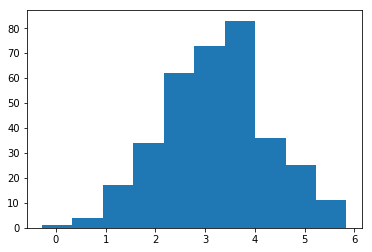

In [86]:
import matplotlib.pyplot as plt
plt.hist(v1)
plt.show()